In [ ]:
# !pip install onnx

#### might have got the error cuz the protobuff package is newer than the version tf needs so downgrage the protobuff version

In [ ]:
# !pip install protobuf==3.20.3

In [ ]:
# import tf2onnx.convert

In [ ]:
# !pip install tf2onnx

In [ ]:
## load the saved model


### with_quant_onnx

In [1]:
import pandas as pd

/home/agrograde/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [ ]:
import numpy as np
import cv2
import os
from tqdm import tqdm as tqdm
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.losses import binary_crossentropy
from keras import backend as K
import segmentation_models as sm
# from keras.utils import to_categorical
from tensorflow.keras.utils import to_categorical
from tensorflow.python.keras.utils import generic_utils
from segmentation_models.losses import CategoricalFocalLoss
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras.utils import to_categorical

from keras.callbacks import Callback, EarlyStopping, ReduceLROnPlateau,ModelCheckpoint
# from keras.optimizers import Adam,SGD
from keras.losses import BinaryCrossentropy
from keras.metrics import MeanIoU
from glob import glob
import tensorflow_model_optimization as tfmot
from tensorflow_model_optimization.quantization.keras import QuantizeConfig
import tensorflow_model_optimization as tfmot

In [ ]:
import tensorflow_model_optimization as tfmot
from tensorflow_model_optimization.python.core.quantization.keras.quantizers import MovingAverageQuantizer, LastValueQuantizer
from tensorflow_model_optimization.python.core.quantization.keras.quantize_config import QuantizeConfig
from keras.layers import Layer

# Custom QuantizeConfig for Conv2D layers
class ConvQuantizeConfig(QuantizeConfig):
    def get_weights_and_quantizers(self, layer):
        return [(layer.kernel, LastValueQuantizer(num_bits=8, per_axis=False, symmetric=False, narrow_range=False))]

    def get_activations_and_quantizers(self, layer):
        return [(layer.activation, MovingAverageQuantizer(num_bits=8, per_axis=False, symmetric=False, narrow_range=False))]

    def set_quantize_weights(self, layer, quantize_weights):
        layer.kernel = quantize_weights[0]
    def set_quantize_activations(self, layer, quantize_activations):
        layer.activation = quantize_activations[0]

    def get_output_quantizers(self, layer):
        # Does not quantize output, since we return an empty list.
        return []

    def get_config(self):
        return {}

In [ ]:
tf.keras.utils.register_keras_serializable(package='QuantizeConfig')(ConvQuantizeConfig)

In [ ]:
import segmentation_models as sm
from keras.layers import *
from keras import layers
from keras.models import Model

def SEModule(input, ratio, out_dim):
    # bs, c, h, w
    x = GlobalAveragePooling2D()(input)
    excitation = Dense(units=out_dim // ratio)(x)
    excitation = Activation('relu')(excitation)
    excitation = Dense(units=out_dim)(excitation)
    excitation = Activation('sigmoid')(excitation)
    excitation = Reshape((1, 1, out_dim))(excitation)
    scale = multiply([input, excitation])
    return scale
def SEUnet(nClasses, input_height=224, input_width=224):
    inputs = Input(shape=(input_height, input_width, 3))
    quantize_annotate_layer = tfmot.quantization.keras.quantize_annotate_layer
    
    conv1 = quantize_annotate_layer(
        Conv2D(16, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(inputs)
    
    conv1 = BatchNormalization()(conv1)
    conv1 = quantize_annotate_layer(
        Conv2D(16, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv1)
    conv1 = BatchNormalization()(conv1)
    # SE
    conv1 = SEModule(conv1, 4, 16)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = quantize_annotate_layer(
        Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = quantize_annotate_layer(
        Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv2)
    conv2 = BatchNormalization()(conv2)
    
    # SE
    conv2 = SEModule(conv2, 8, 32)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = quantize_annotate_layer(
        Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = quantize_annotate_layer(
        Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv3)
    conv3 = BatchNormalization()(conv3)
    
    # SE
    conv3 = SEModule(conv3, 8, 64)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = quantize_annotate_layer(
        Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = quantize_annotate_layer(
        Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv4)
    conv4 = BatchNormalization()(conv4)
    
    # SE
    conv4 = SEModule(conv4, 16, 128)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = quantize_annotate_layer(
        Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(pool4)
    conv5 = BatchNormalization()(conv5)
    conv5 = quantize_annotate_layer(
        Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv5)
    conv5 = BatchNormalization()(conv5)
    
    # SE
    conv5 = SEModule(conv5, 16, 256)

    up6 = quantize_annotate_layer(
        Conv2D(128, 2, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(UpSampling2D(size=(2, 2))(conv5))
    up6 = BatchNormalization()(up6)
    merge6 = concatenate([conv4, up6], axis=3)
    conv6 = quantize_annotate_layer(
        Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(merge6)
    conv6 = BatchNormalization()(conv6)
    conv6 = quantize_annotate_layer(
        Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv6)
    conv6 = BatchNormalization()(conv6)
    
    # SE
    conv6 = SEModule(conv6, 16, 128)

    up7 = quantize_annotate_layer(
        Conv2D(64, 2, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(UpSampling2D(size=(2, 2))(conv6))
    up7 = BatchNormalization()(up7)
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = quantize_annotate_layer(
        Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(merge7)
    conv7 = BatchNormalization()(conv7)
    conv7 = quantize_annotate_layer(
        Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv7)
    conv7 = BatchNormalization()(conv7)
    
    # SE
    conv7 = SEModule(conv7, 8, 64)

    up8 = quantize_annotate_layer(
        Conv2D(32, 2, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(UpSampling2D(size=(2, 2))(conv7))
    up8 = BatchNormalization()(up8)
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = quantize_annotate_layer(
        Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(merge8)
    conv8 = BatchNormalization()(conv8)
    conv8 = quantize_annotate_layer(
        Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv8)
    conv8 = BatchNormalization()(conv8)
    
    # SE
    conv8 = SEModule(conv8, 4, 32)

    up9 = quantize_annotate_layer(
        Conv2D(16, 2, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(UpSampling2D(size=(2, 2))(conv8))
    up9 = BatchNormalization()(up9)
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = quantize_annotate_layer(
        Conv2D(16, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(merge9)
    conv9 = BatchNormalization()(conv9)
    conv9 = quantize_annotate_layer(
        Conv2D(16, 3, activation='relu', padding='same', kernel_initializer='he_normal'),
        quantize_config=ConvQuantizeConfig()
    )(conv9)
    conv9 = BatchNormalization()(conv9)
    
    # SE
    conv9 = SEModule(conv9, 2, 16)

    conv10 = quantize_annotate_layer(
        Conv2D(nClasses, (3, 3), padding='same'),
        quantize_config=ConvQuantizeConfig()
    )(conv9)
    conv10 = BatchNormalization()(conv10)

    outputHeight = Model(inputs, conv10).output_shape[1]
    outputWidth = Model(inputs, conv10).output_shape[2]

    out = Reshape((outputHeight * outputWidth, nClasses))(conv10)
    out = Activation('softmax')(out)

    model = Model(inputs, out)
    model.outputHeight = outputHeight
    model.outputWidth = outputWidth

    return model

model1 = SEUnet(nClasses= 5)

x = model1.get_layer(index=-3).output

out0 = Conv2D(2, (1, 1), activation='softmax',name='sprout')(x)
out1 = Conv2D(2, (1, 1), activation='softmax',name='peeled')(x)
out2 = Conv2D(2, (1, 1), activation='softmax',name='rotten')(x)
out3 = Conv2D(2, (1, 1), activation='softmax',name='black_smut')(x)
out4 = Conv2D(2, (1, 1), activation='softmax',name='background')(x)
  


model_new = Model(inputs = model1.input,outputs = [out0,out1,out2,out3,out4])
    #print(model_new.summary())
    
quantized_model = tfmot.quantization.keras.quantize_apply(model_new)

In [ ]:
quantized_model.load_weights(r"/home/agrograde/Desktop/17thy_jupy_2024/model_ckpt1.h5")

In [1]:
from tensorflow.keras.models import load_model
import onnx
import tf2onnx.convert
import numpy as np
import cv2
import os
from tqdm import tqdm as tqdm
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.losses import binary_crossentropy
from keras import backend as K
import segmentation_models as sm
# from keras.utils import to_categorical
from tensorflow.keras.utils import to_categorical
from tensorflow.python.keras.utils import generic_utils
from segmentation_models.losses import CategoricalFocalLoss
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras.utils import to_categorical

from keras.callbacks import Callback, EarlyStopping, ReduceLROnPlateau,ModelCheckpoint
# from keras.optimizers import Adam,SGD
from keras.losses import BinaryCrossentropy
from keras.metrics import MeanIoU
from glob import glob
import tensorflow_model_optimization as tfmot
from tensorflow_model_optimization.quantization.keras import QuantizeConfig
import tensorflow_model_optimization as tfmot

2024-07-17 13:28:41.062954: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-17 13:28:41.158427: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-07-17 13:28:41.158447: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2024-07-17 13:28:41.185435: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-17 13:28:41.633321: W tensorflow/stream_executor/platform/de

Segmentation Models: using `keras` framework.


In [ ]:
onnx_model,_ = tf2onnx.convert.from_keras(quantized_model)

In [ ]:
onnx.save(onnx_model,"onnx_model.onnx")

Starting Of the testing

In [2]:
import numpy as np
import cv2
import os
from tqdm import tqdm_notebook as tqdm
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model, Model
from tensorflow.keras import layers
from tensorflow.keras.layers import Input,Conv2D,BatchNormalization,UpSampling2D,concatenate
import time
h,w = 224,224
import tensorflow as tf

In [3]:
# # folder=['holes":1.0,"potato": 1.0,"rotten": 1.0,"cuts"]
def bbox(img, mask, flag):
    visuals = img.copy()
    if flag=='sp':
        color=(255,255,0)  
    if flag=='pl':
        color=(252,51,255)
    if flag=='ro':
        color=(230,126,34)
    if flag=='bs':
        color=(60,59,43)
    # if flag=='db':
    #     color=(0,255,255)

    if flag=="bg":
        color = (45,255,11)

    else:
        color = (230,126,34)
     
    

        
    contours = cv2.findContours(mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)[0]
    visuals = cv2.drawContours(img.copy(), contours, -1, color,1)
    return visuals

In [4]:
def getPercentArea(full_mask, region_mask):
    full_mask = cv2.resize(full_mask.astype(float), (224,224))
    total_area,region_area = np.sum(full_mask),np.sum(region_mask)
    area_percentage = (region_area/total_area)*100
    return area_percentage

global final_mask
def getCombinedMask(img, defect_masks):
    final_mask = np.zeros_like(img)
    sp_mask,pl_mask,ro_mask,bs_mask,bg_mask = defect_masks

#     print(ho_mask.shape,po_mask.shape,ro_mask.shape,cu_mask.shape)

    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            if sp_mask[i,j]>0:
                final_mask[i,j,:]=[255,255,0]
            if pl_mask[i,j]>0:
                final_mask[i,j,:]=[252,51,255]
            if ro_mask[i,j]>0:
                 final_mask[i,j,:]=[230,126,34]

            if bs_mask[i,j]>0:
                 final_mask[i,j,:]=[60,59,43]
                
            if bg_mask[i,j]>0:
                 final_mask[i,j,:]=[45,255,11]

           
            else:
                final_mask[i,j,:]=[45,255,11]
    
    return final_mask


In [5]:
import glob
import skimage
import matplotlib.pyplot as plt
import keras.backend as K
import time
global masks
masks = []
def calaculate(masks_lst):
    defect_candidates = []   
    def_seg = np.zeros(shape=(224,224,len(masks_lst)),dtype=np.uint8)
    for i in range(len(masks_lst)): #0 to 3
        mask = np.argmax(masks_lst[i], axis=3)
        mask = mask.reshape(224,224)
        mask = 255*mask.astype(np.uint8)
        mask_1 = cv2.resize(mask, (224,224))
        masks.append(mask_1)
        def_seg[:,:,i] = mask_1
        extent = np.sum(mask_1)
        defect_candidates.append(extent)
        defects = np.squeeze(np.array(defect_candidates[:])/(sum(defect_candidates)+1))*100



import onnxruntime

# Define model input shape (replace h and w with actual values)
h, w = 224, 224  # Example values, replace with your model's expected input size

# Load the ONNX model
model_path = "/home/agrograde/Desktop/17thy_jupy_2024/onnx_model.onnx"
session = onnxruntime.InferenceSession(model_path)
input_name = session.get_inputs()[0].name
output_names = [output.name for output in session.get_outputs()]


def getPrediction(img_path,mask_path):
    for image in os.listdir(img_path):
        print(f"name of the image {image}")     
        if image.endswith('.jpg'):
            img_name = image[:-4]
            img = cv2.imread(os.path.join(img_path,image))
            im = cv2.resize(img,(h,w))
            I = im.astype(np.float32)
            I = I.reshape([1, h, w, 3])
            # start = time.time()
            # preds = model_new.predict(I)
            # print(f"main pred hoon{len(preds)}")
            
           # Perform inference
            start = time.time()
            preds = session.run(output_names, {input_name: I})
            print(f"Inference time: {(time.time() - start):.2f} sec")
            
            calaculate(preds)
            
            sp = np.argmax(preds[0], axis=3)
            sp = sp.reshape([h,w])
            
            pl= np.argmax(preds[1], axis=3)
            pl = pl.reshape([h,w])
            ro= np.argmax(preds[2], axis=3)
            ro = ro.reshape([h,w])   
            bs= np.argmax(preds[3], axis=3)
            bs = bs.reshape([h,w])
            
            # db= np.argmax(preds[3], axis=3)
            # db = pl.reshape([h,w])

            
            bg= np.argmax(preds[4], axis=3)
            bg = bg.reshape([h,w])
            
            print("Time taken for pred is : ",(time.time()-start),'sec')
            
            sp_vis = cv2.cvtColor(bbox(im, sp, 'sp'), cv2.COLOR_BGR2RGB)
# #             
            pl_vis = cv2.cvtColor(bbox(im, pl, 'pl'), cv2.COLOR_BGR2RGB)
            ro_vis = cv2.cvtColor(bbox(im, ro, 'ro'), cv2.COLOR_BGR2RGB)
            bs_vis = cv2.cvtColor(bbox(im, bs, 'bs'), cv2.COLOR_BGR2RGB)

            # db_vis = cv2.cvtColor(bbox(im, db, 'db'), cv2.COLOR_BGR2RGB)
            
            bg_vis = cv2.cvtColor(bbox(im, bg, 'bg'), cv2.COLOR_BGR2RGB)
            
            
            masks_stack = np.hstack((sp,pl,ro,bs,bg))
            visuals_stack = np.hstack((sp_vis,pl_vis,ro_vis,bs_vis,bg_vis))

            
            
            im = cv2.cvtColor(im , cv2.COLOR_BGR2RGB)
            all_masks = [sp,pl,ro,bs,bg]
            combined_mask = getCombinedMask(im, all_masks)
            gray = np.dot(combined_mask[...,:3], [0.299, 0.587, 0.114])
            threshold = 0
            binary_1 = np.where(gray > threshold, 1, 0)
            plt.imshow(binary_1)
            plt.title("combined_mask")
            
            sprout_area = getPercentArea(binary_1, sp)
            peeled_area = getPercentArea(binary_1, pl)
            rotten_area = getPercentArea(binary_1, ro)
            black_smut_area = getPercentArea(binary_1, bs)
            #double_area = getPercentArea(binary_1, db)
            background_area = getPercentArea(binary_1, bg)
            total_area = background_area
        
            r1,r2,r3,r4=((sprout_area*100)/total_area),((peeled_area*100)/total_area),((rotten_area*100)/total_area),((black_smut_area*100)/total_area)

            plt.figure(figsize=(10,10))
            plt.subplot(1,3,1)
            plt.imshow(im)
            plt.title('original')
            
            plt.figure(figsize=(25,25))
            plt.subplot(1,3,3)
            plt.imshow(masks_stack)

            plt.figure(figsize=(40,40))
            plt.subplot(1,3,2)
            plt.imshow(visuals_stack)

            plt.title('sprout_area:{:.3f} %,peeled_area:{:.3f} %, rotten_area:{:.3f} %, Black_amut_area:{:.3f} %'.format(r1,r2,r3,r4))
    

            plt.show()
            gt_mask_path = os.path.join(mask_path,img_name+"_color_mask.png") # Assuming ground truth masks are in PNG format
            if os.path.exists(gt_mask_path):
                gt_mask = cv2.imread(gt_mask_path, cv2.IMREAD_COLOR) 
                gt_mask = cv2.resize(gt_mask, (h, w))

                plt.figure(figsize=(4,4))
                plt.imshow(cv2.cvtColor(gt_mask, cv2.COLOR_BGR2RGB))
                plt.title('Ground Truth Mask')

            plt.show()


2024-07-17 13:28:47.922010932 [W:onnxruntime:Default, upsamplebase.h:101 UpsampleBase] `tf_half_pixel_for_nn` is deprecated since opset 13, yet this opset 13 model uses the deprecated attribute
2024-07-17 13:28:47.922045928 [W:onnxruntime:Default, upsamplebase.h:101 UpsampleBase] `tf_half_pixel_for_nn` is deprecated since opset 13, yet this opset 13 model uses the deprecated attribute
2024-07-17 13:28:47.922065224 [W:onnxruntime:Default, upsamplebase.h:101 UpsampleBase] `tf_half_pixel_for_nn` is deprecated since opset 13, yet this opset 13 model uses the deprecated attribute
2024-07-17 13:28:47.922079350 [W:onnxruntime:Default, upsamplebase.h:101 UpsampleBase] `tf_half_pixel_for_nn` is deprecated since opset 13, yet this opset 13 model uses the deprecated attribute


## Sprout

name of the image 040523_95_1.jpg
Inference time: 0.08 sec
Time taken for pred is :  0.08269071578979492 sec


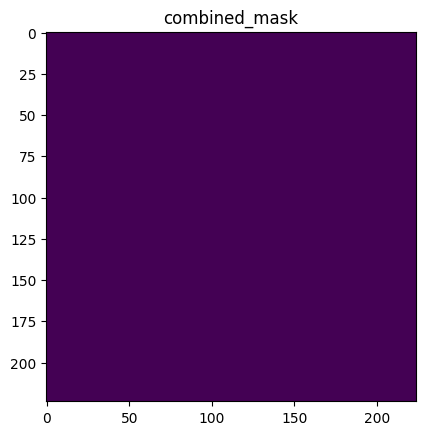

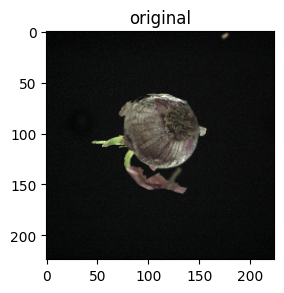

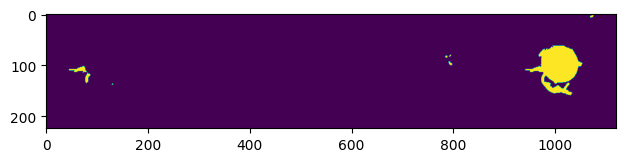

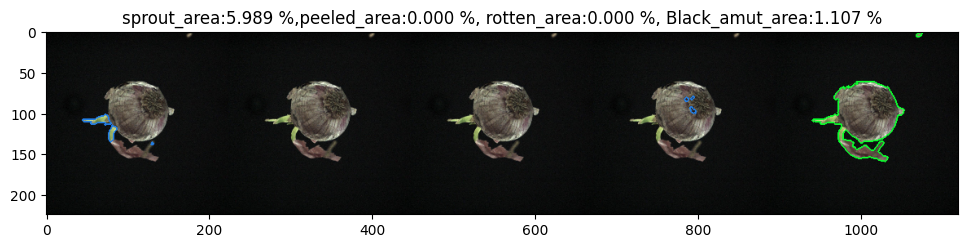

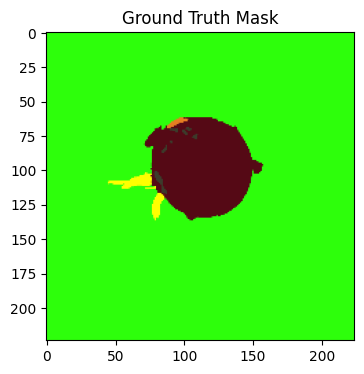

name of the image 282.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06348919868469238 sec


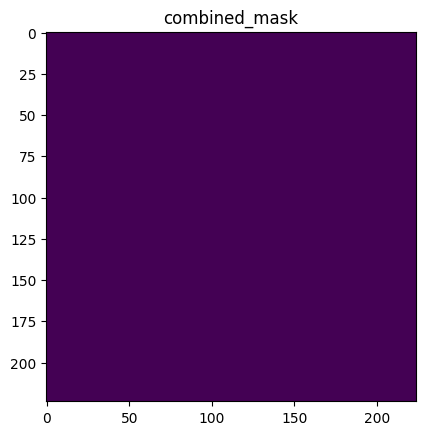

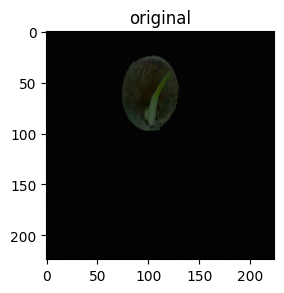

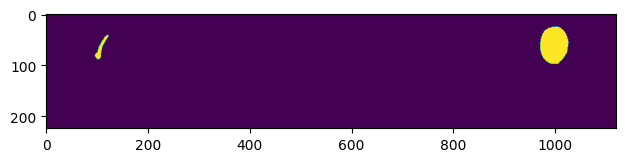

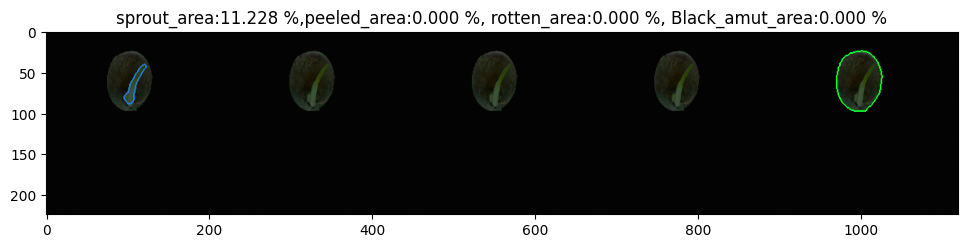

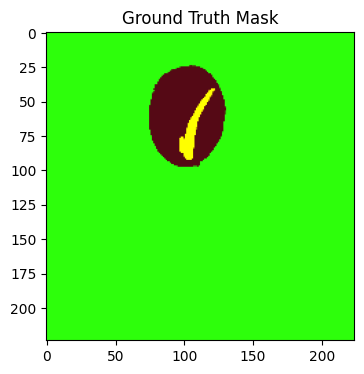

name of the image 100423_138_1.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.0587613582611084 sec


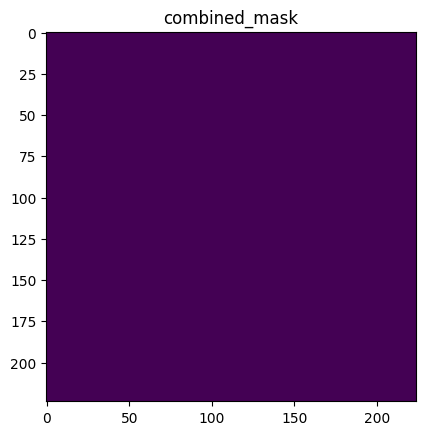

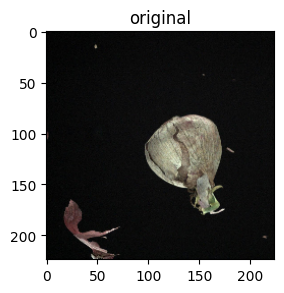

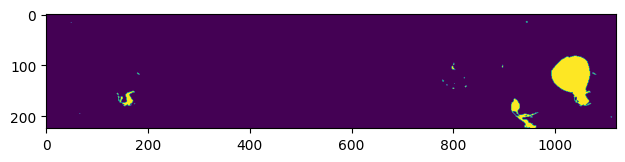

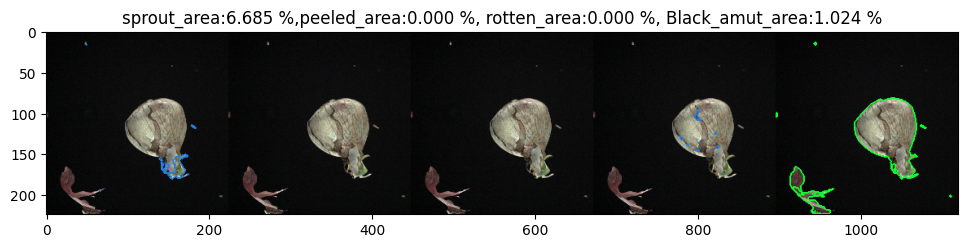

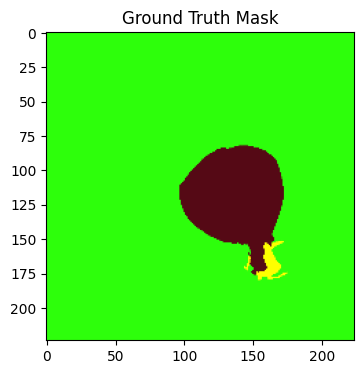

name of the image 1205.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.055642127990722656 sec


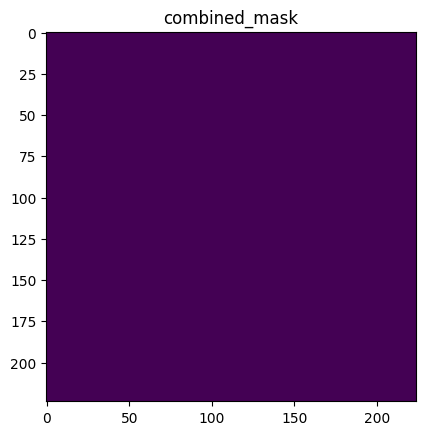

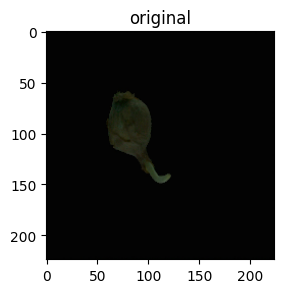

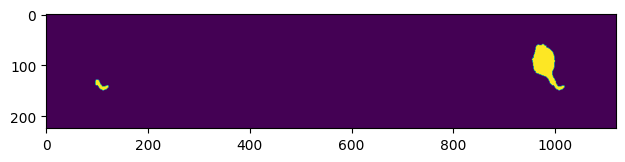

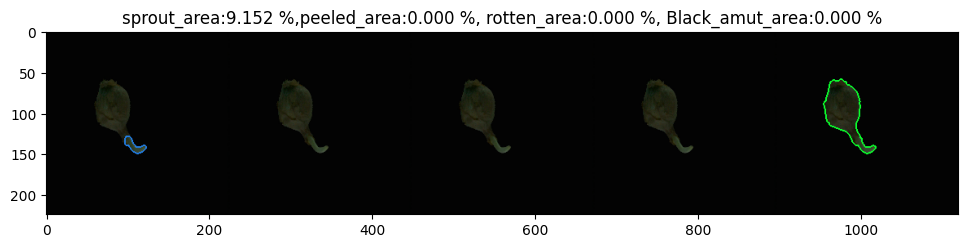

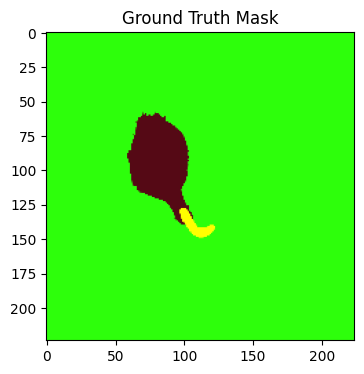

name of the image 080423_71_1.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05102038383483887 sec


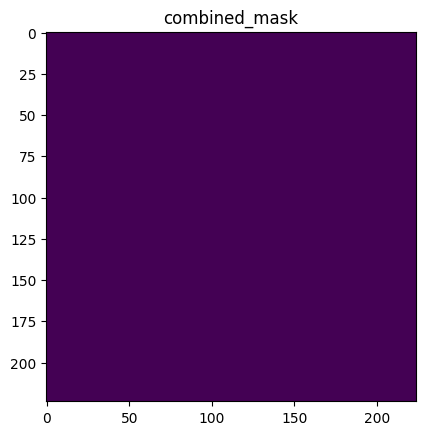

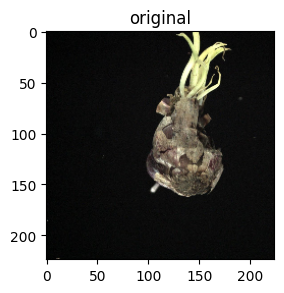

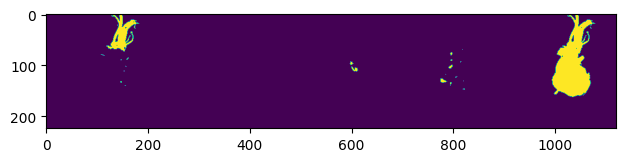

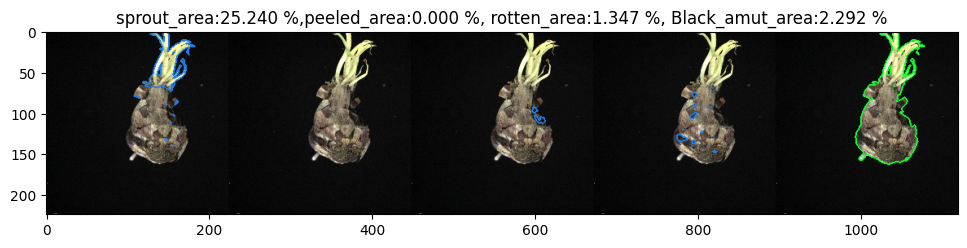

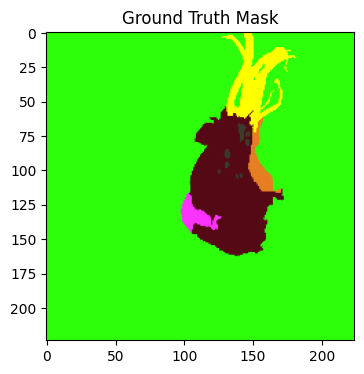

name of the image 189.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05433058738708496 sec


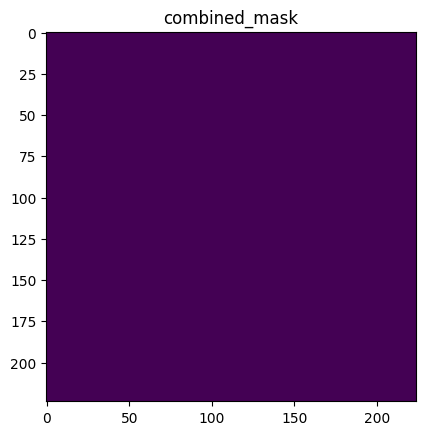

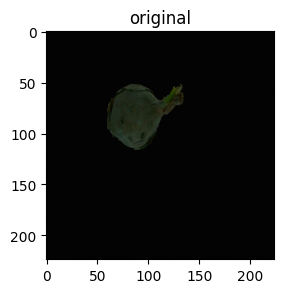

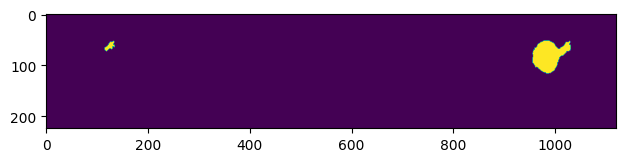

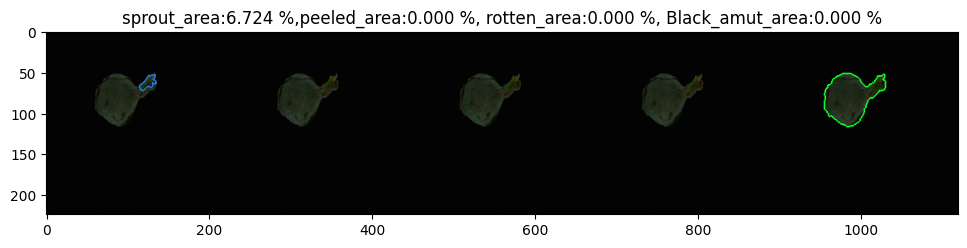

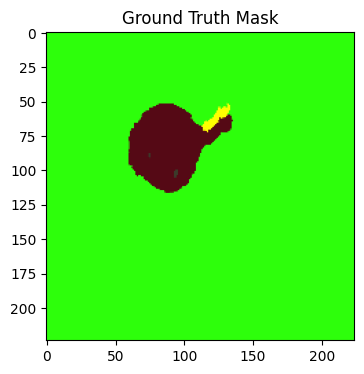

name of the image 297_1.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.05911612510681152 sec


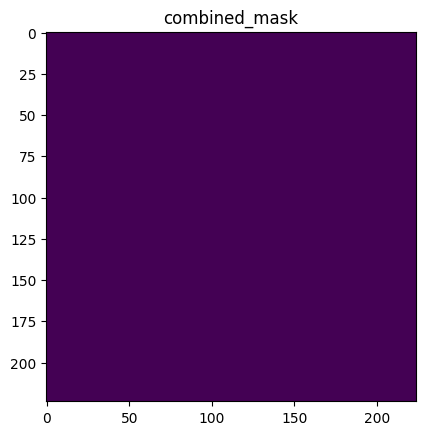

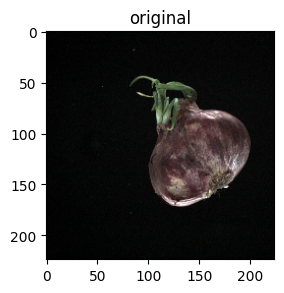

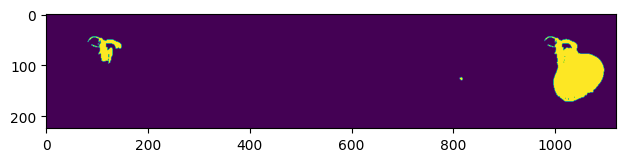

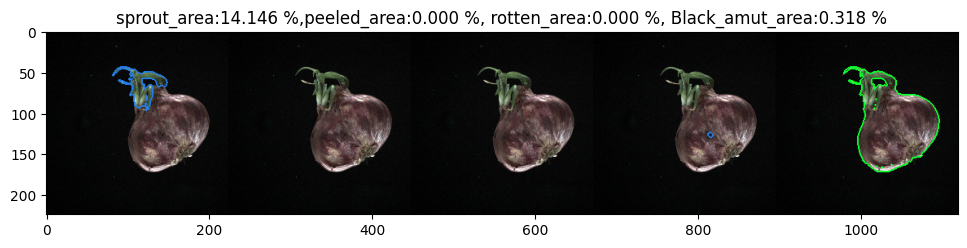

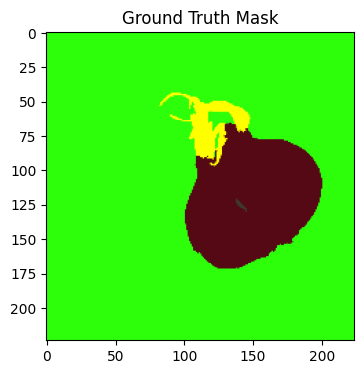

name of the image 13_1.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.04941415786743164 sec


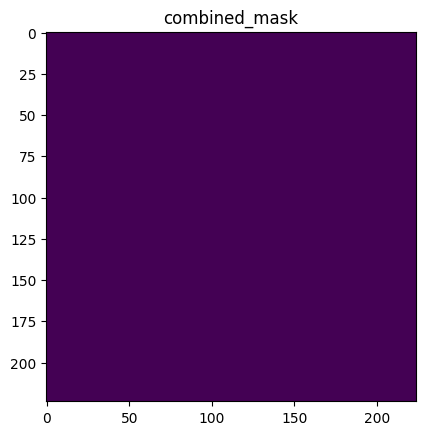

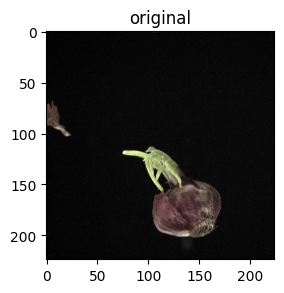

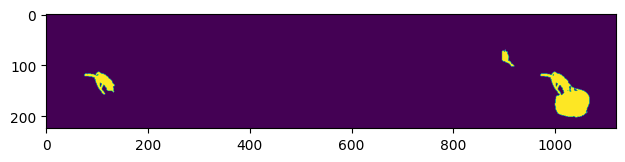

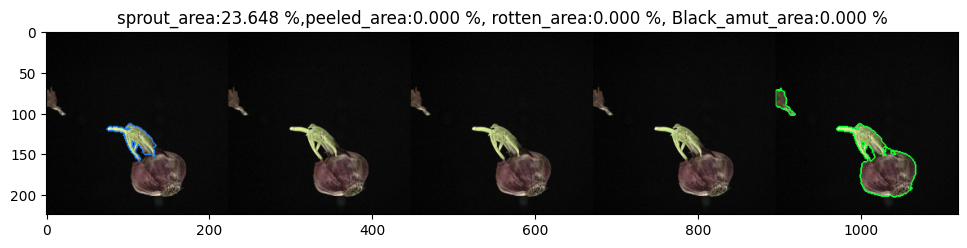

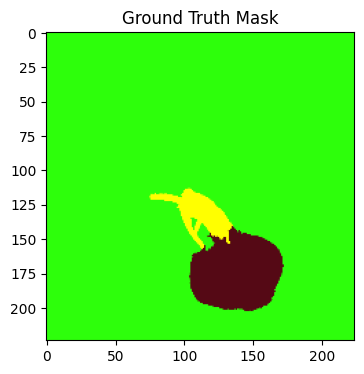

name of the image 23.jpg
Inference time: 0.07 sec
Time taken for pred is :  0.07204079627990723 sec


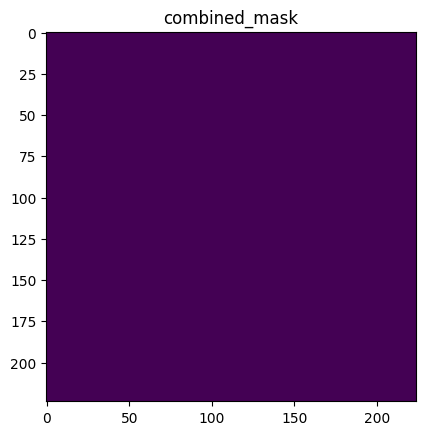

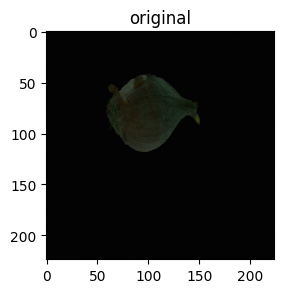

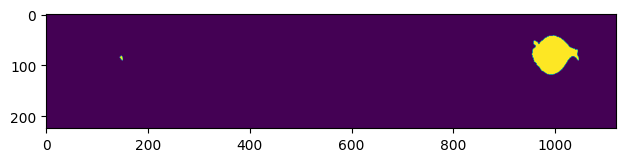

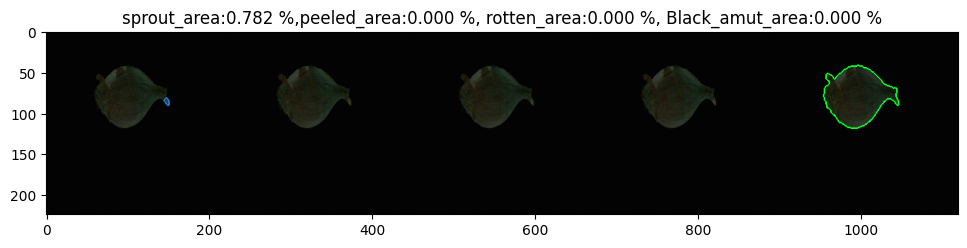

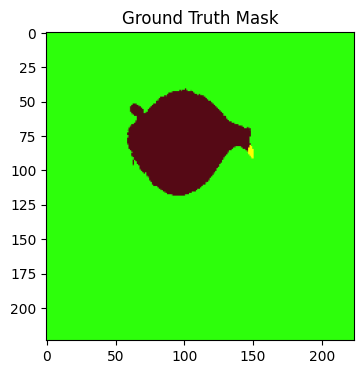

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [6]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/sprout/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/sprout/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Peeled

name of the image 23_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06720519065856934 sec


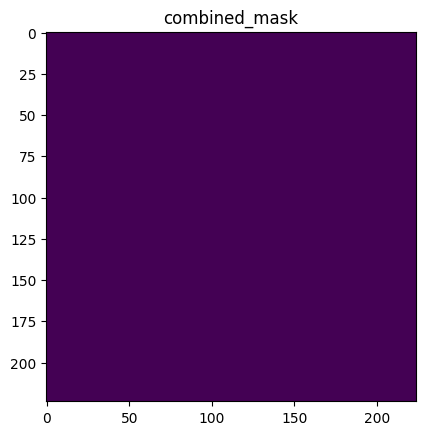

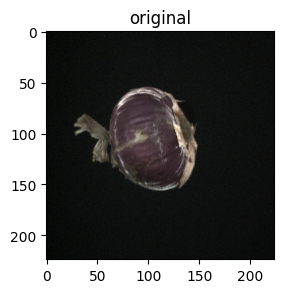

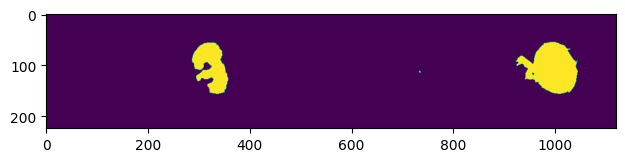

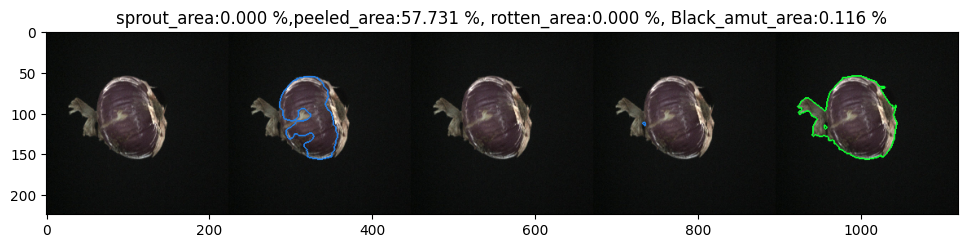

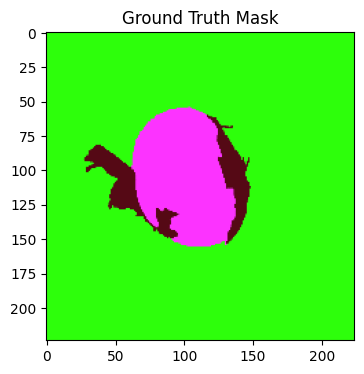

name of the image 50_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.050417184829711914 sec


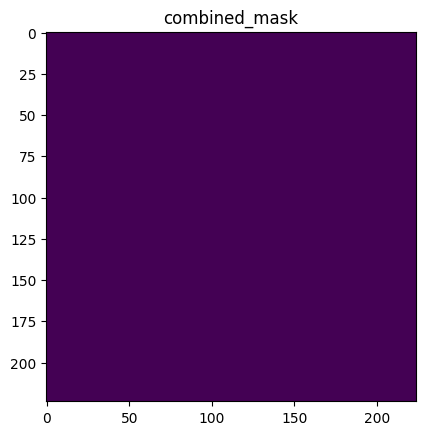

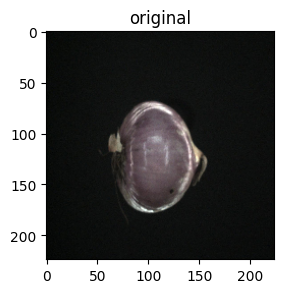

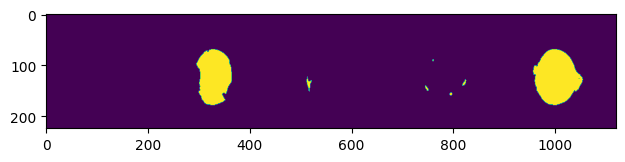

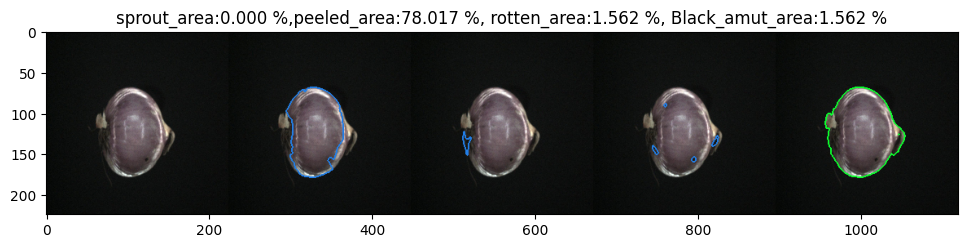

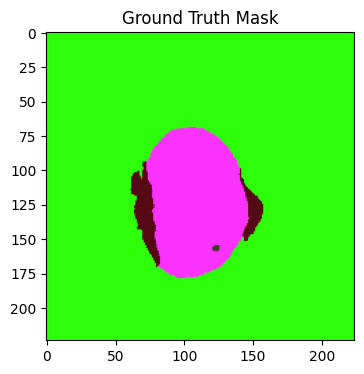

name of the image 7_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.05955386161804199 sec


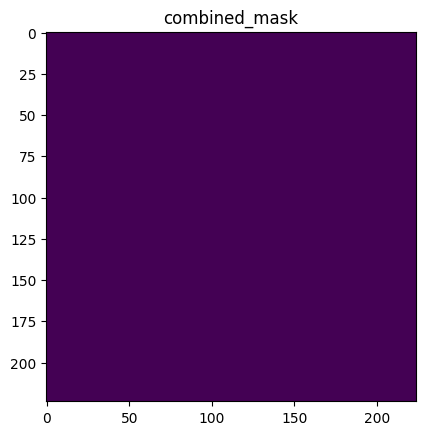

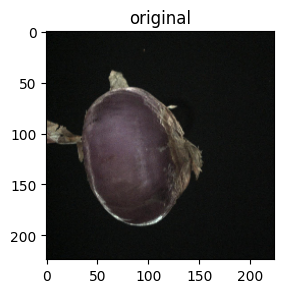

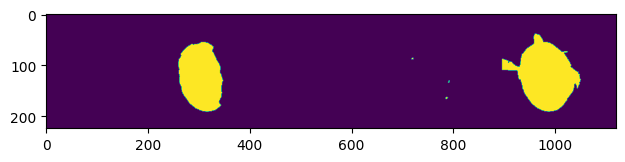

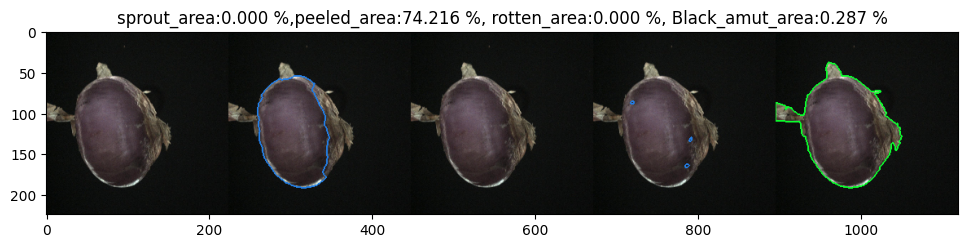

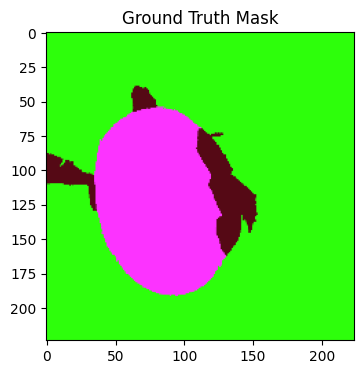

name of the image 32_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05395007133483887 sec


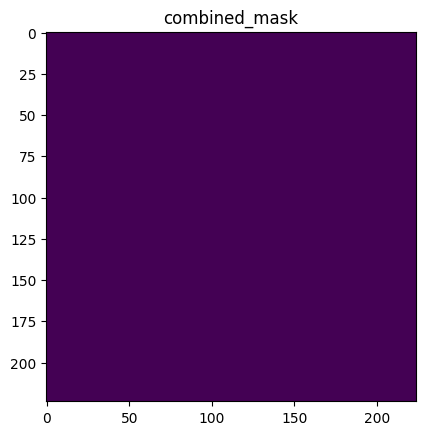

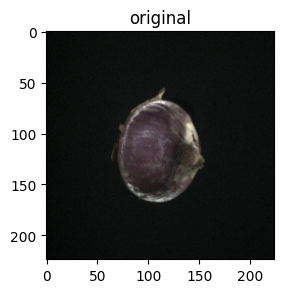

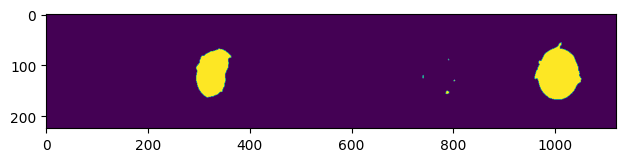

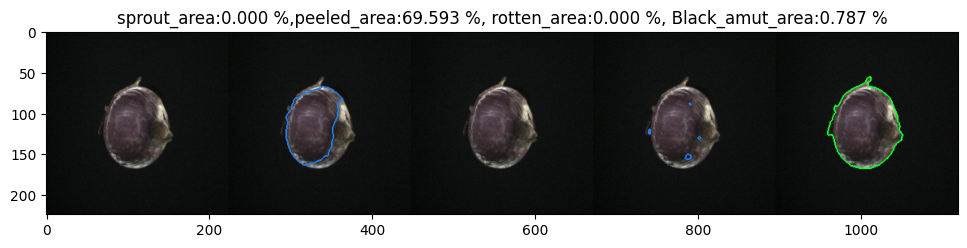

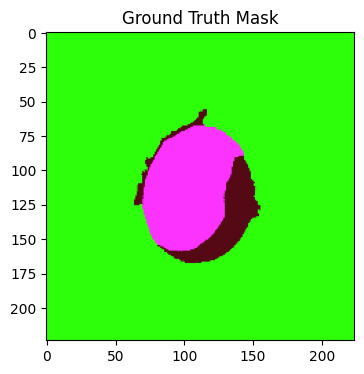

name of the image 26_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.055834293365478516 sec


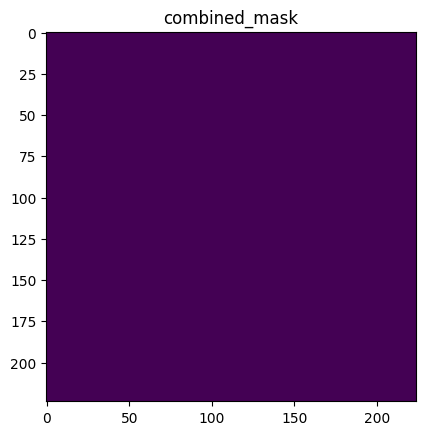

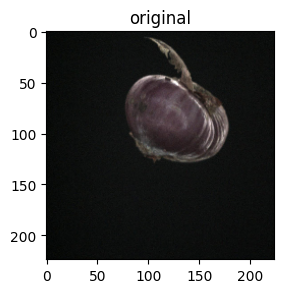

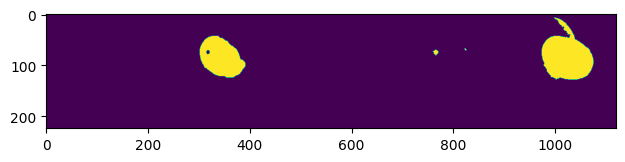

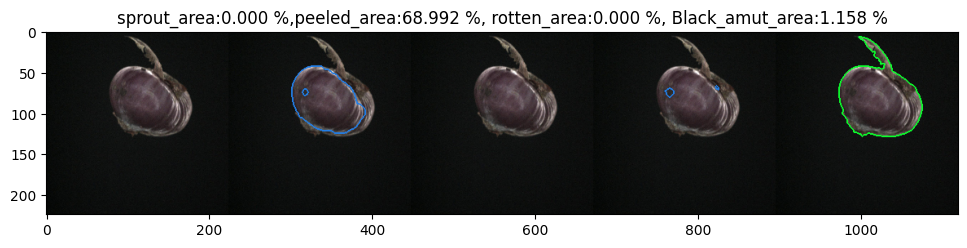

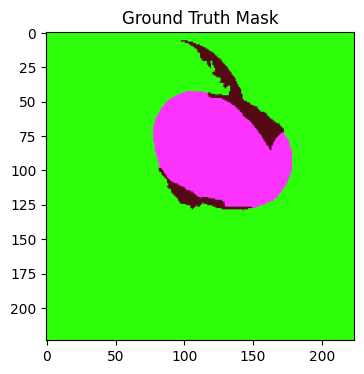

name of the image 13_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.059388160705566406 sec


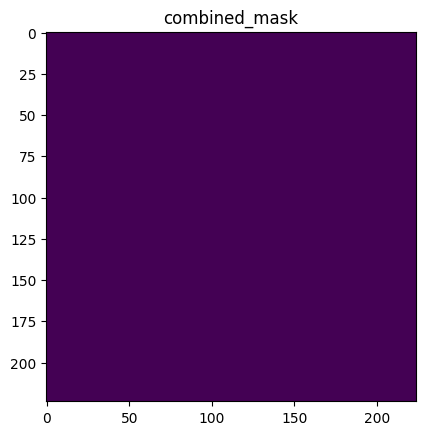

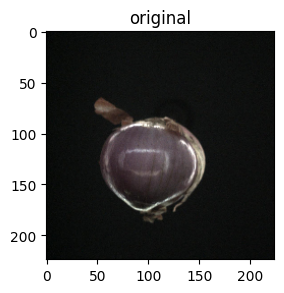

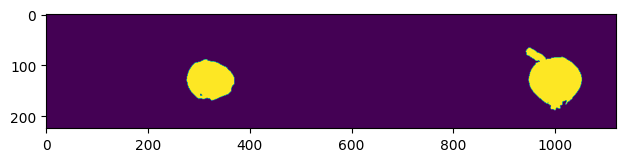

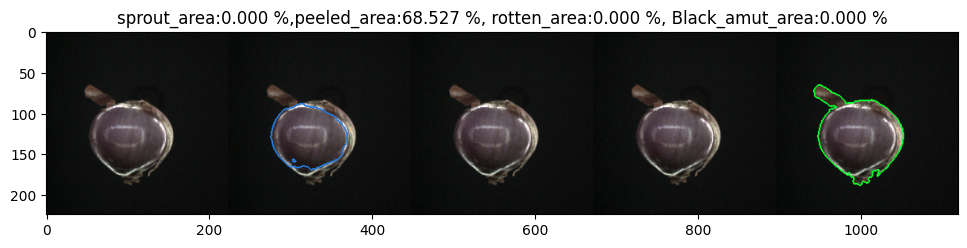

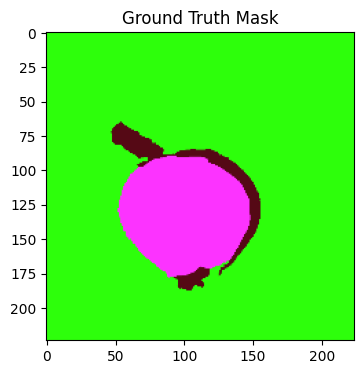

name of the image 34_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05617833137512207 sec


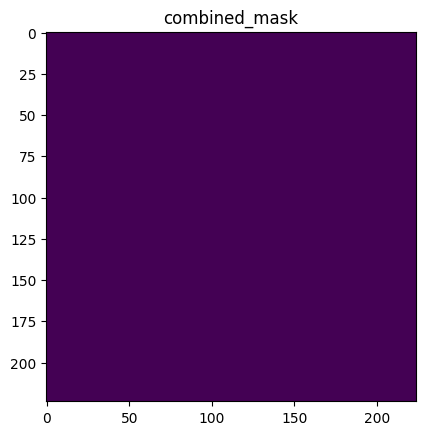

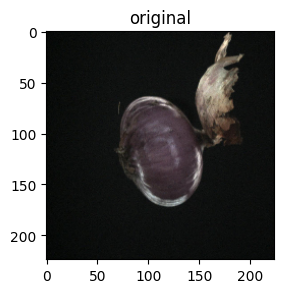

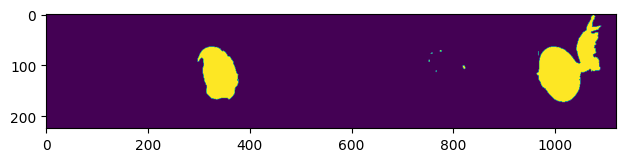

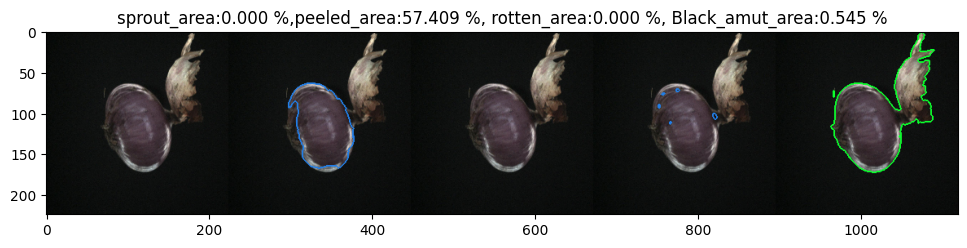

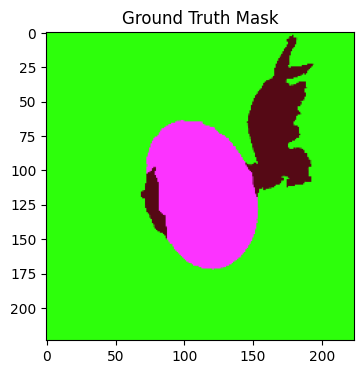

name of the image 66_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05532193183898926 sec


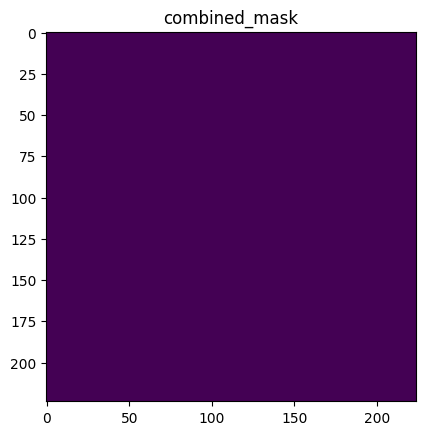

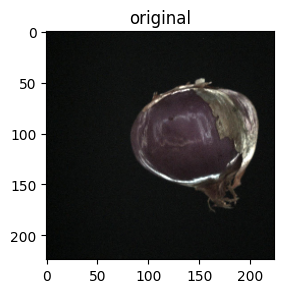

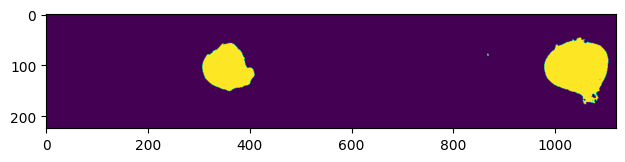

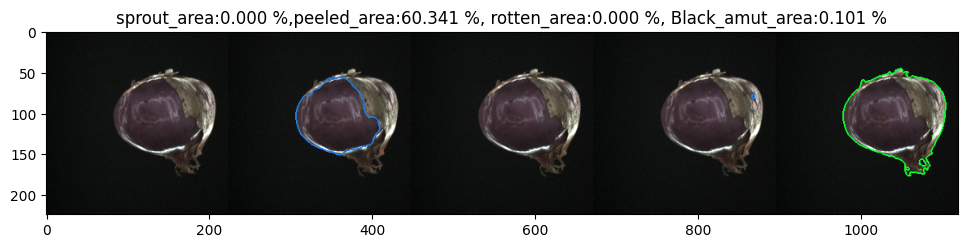

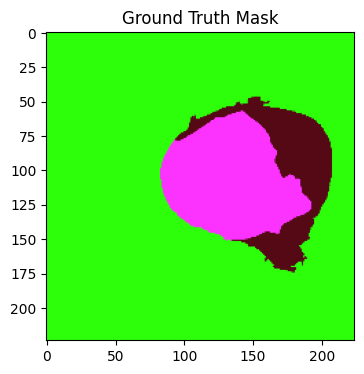

name of the image 88_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.05935239791870117 sec


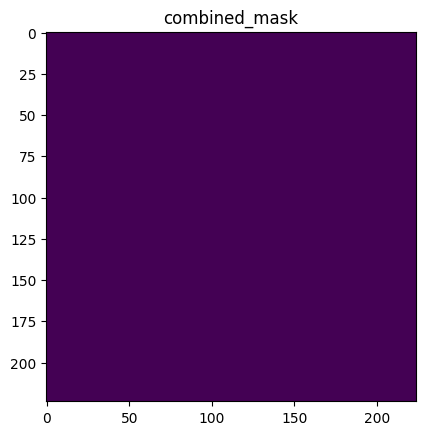

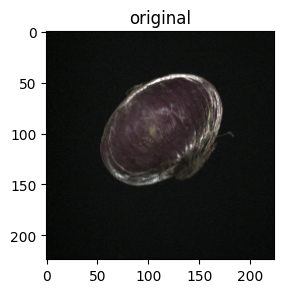

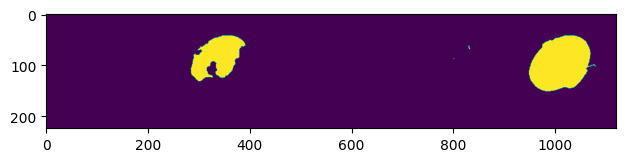

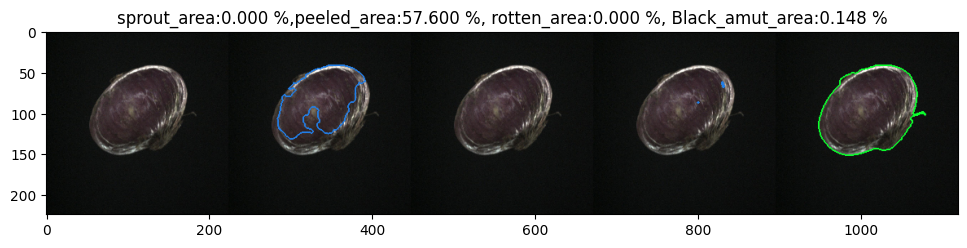

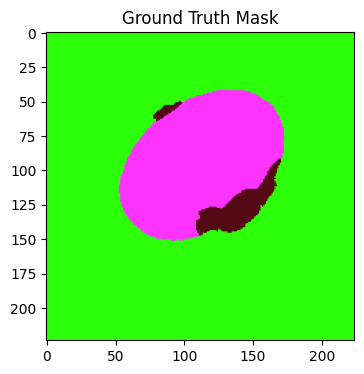

name of the image 46_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.056916236877441406 sec


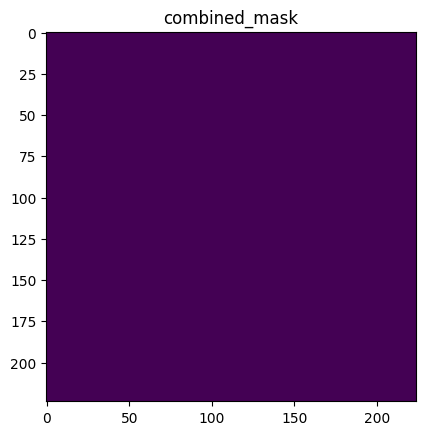

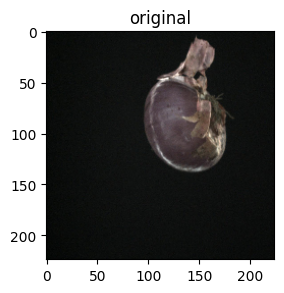

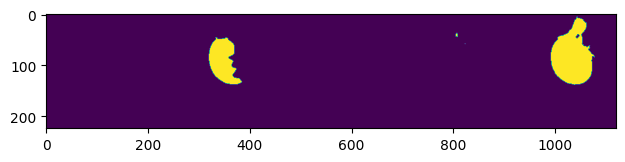

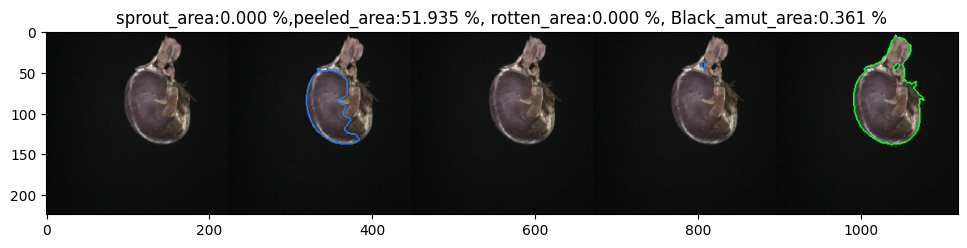

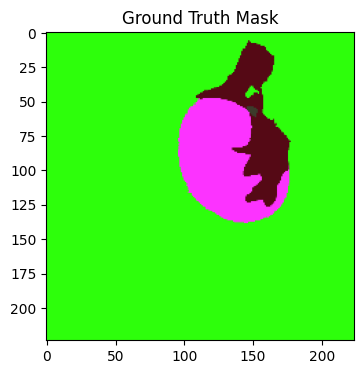

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [7]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/Peeled/Peeled_T/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/Peeled/Peeled_T/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Black_smut

name of the image 184_.jpg
Inference time: 0.08 sec
Time taken for pred is :  0.07918787002563477 sec


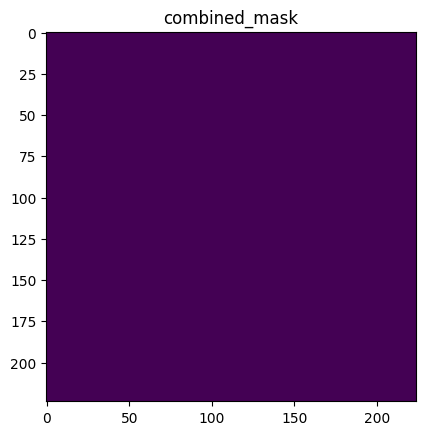

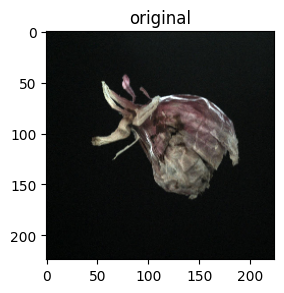

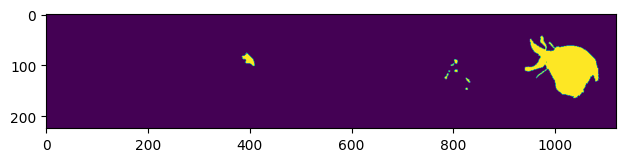

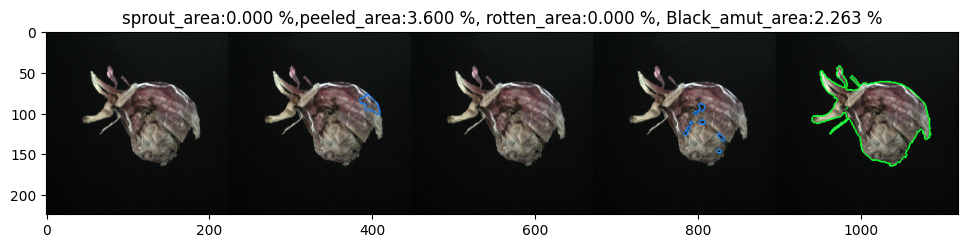

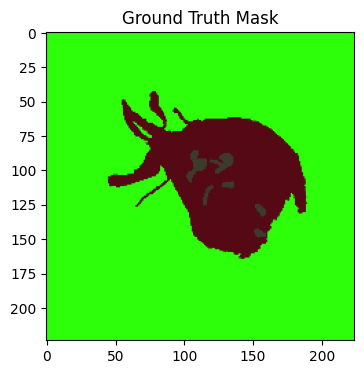

name of the image 156_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06670999526977539 sec


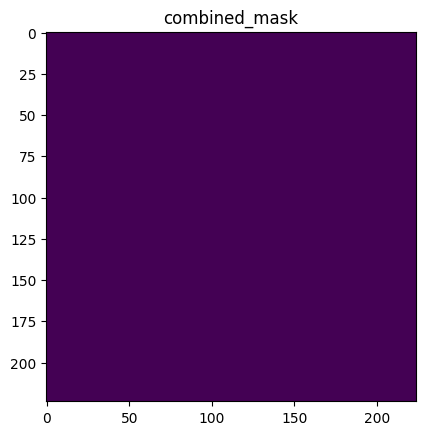

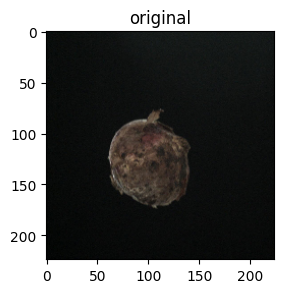

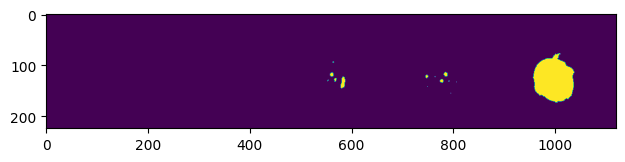

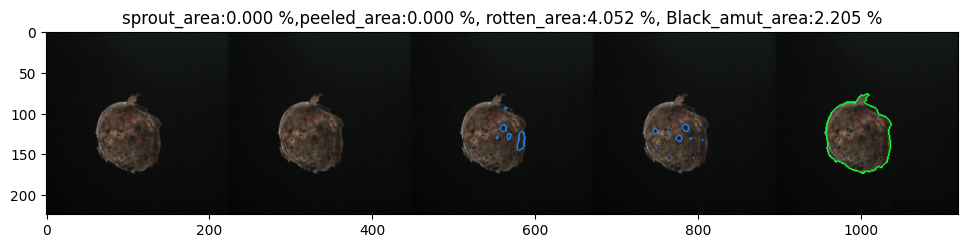

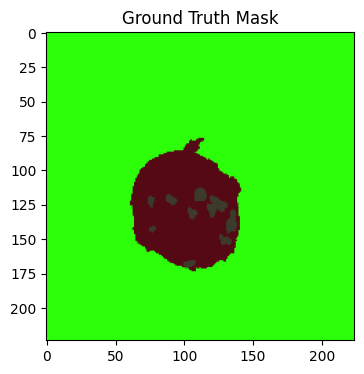

name of the image 161_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05317497253417969 sec


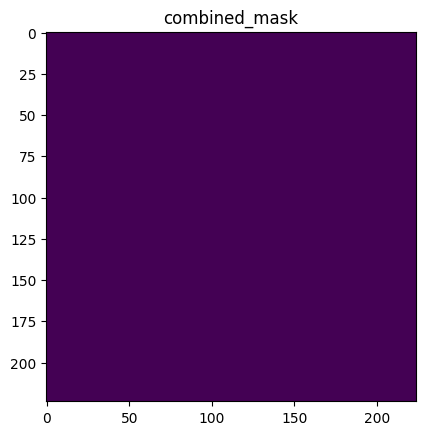

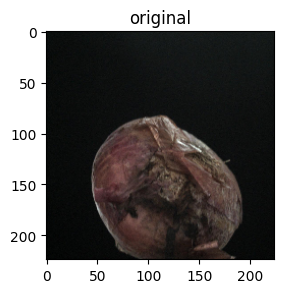

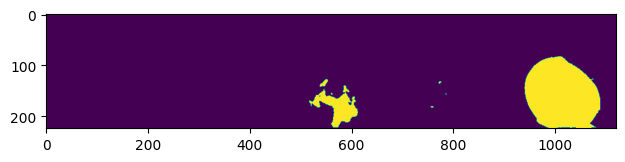

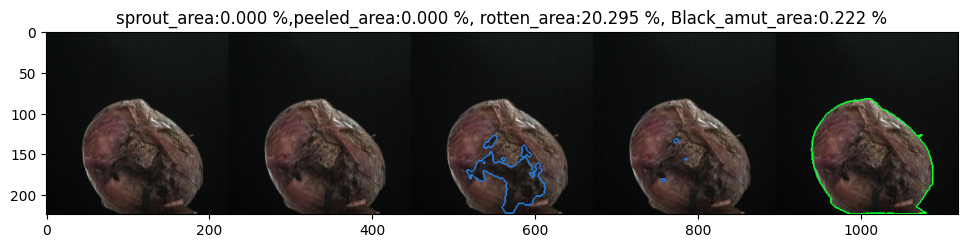

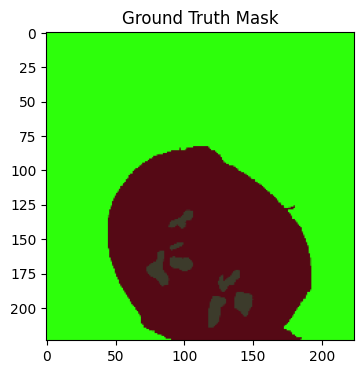

name of the image 187_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.051668643951416016 sec


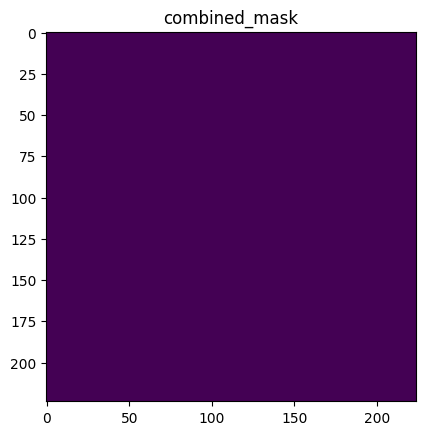

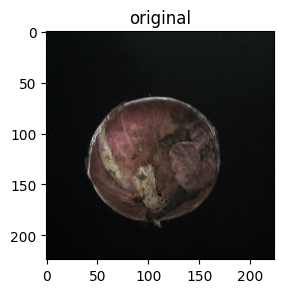

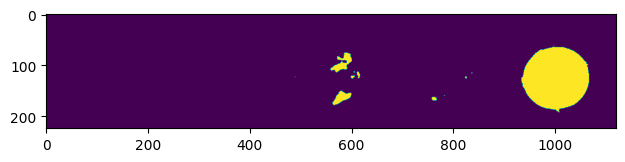

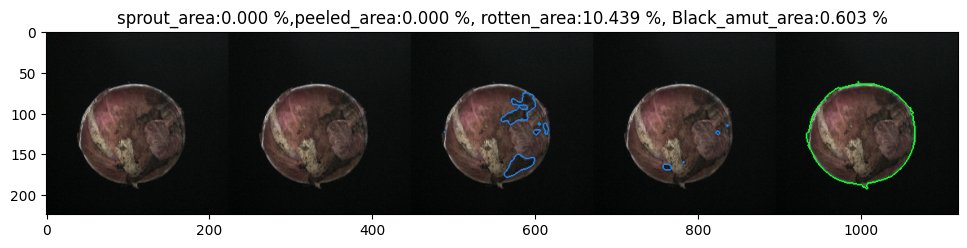

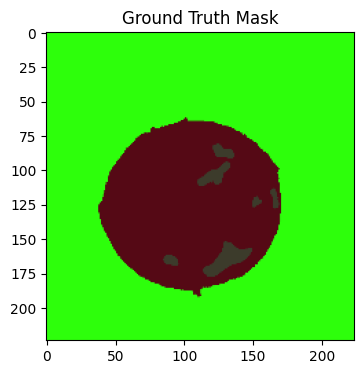

name of the image 142_.jpg
Inference time: 0.08 sec
Time taken for pred is :  0.08387970924377441 sec


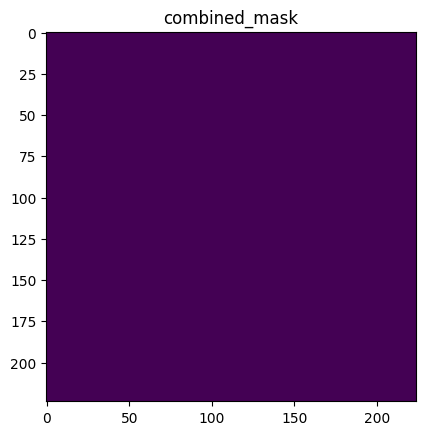

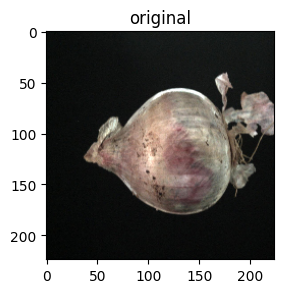

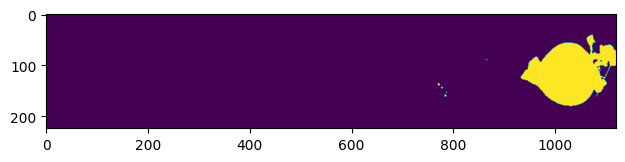

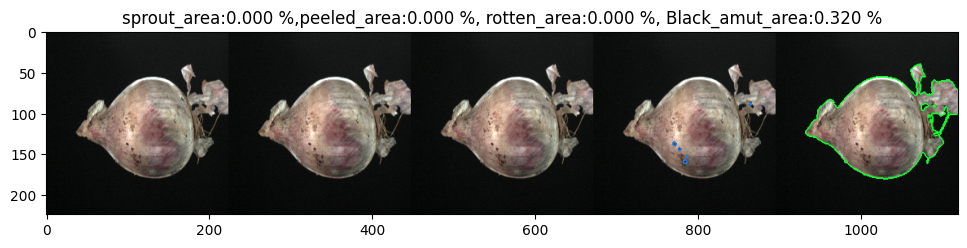

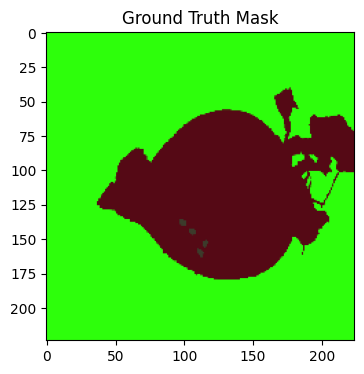

name of the image 145_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05738043785095215 sec


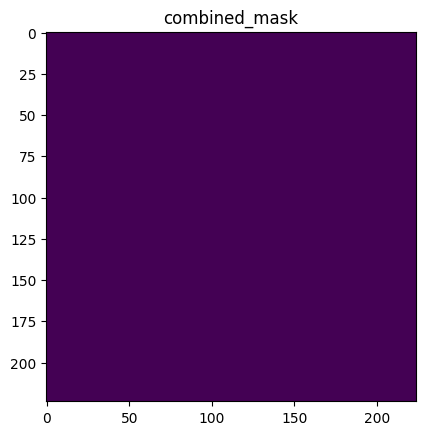

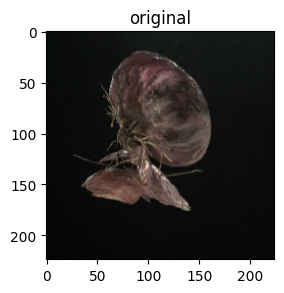

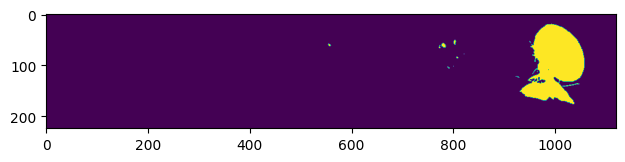

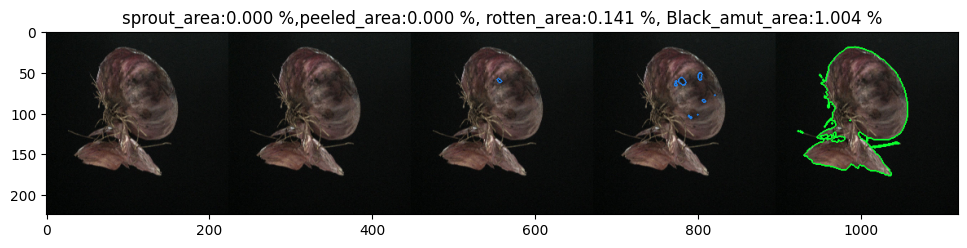

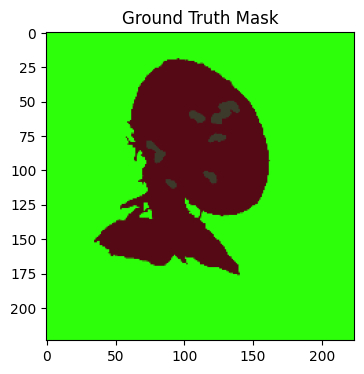

name of the image 157_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.0535426139831543 sec


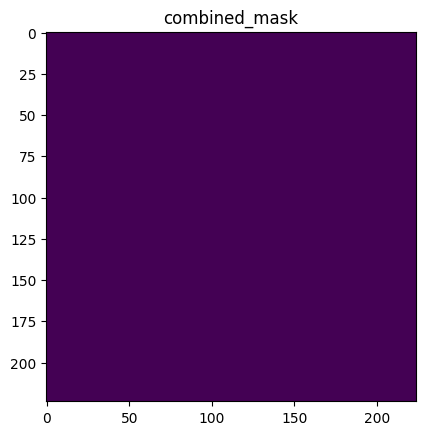

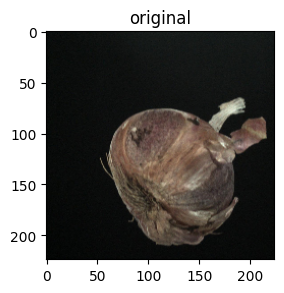

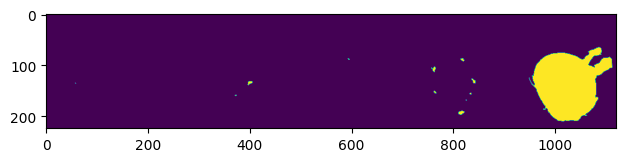

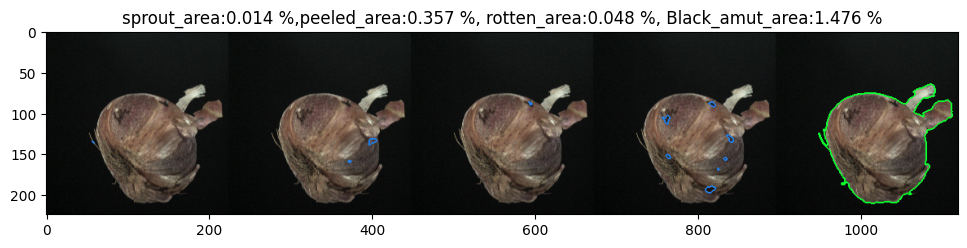

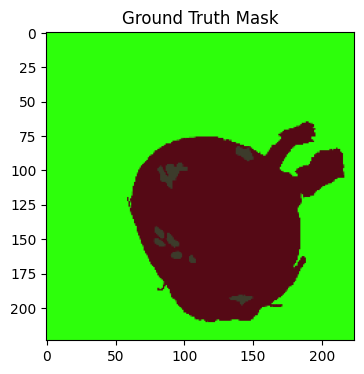

name of the image 167_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.0524907112121582 sec


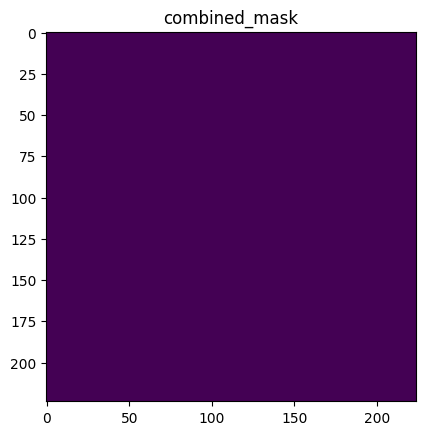

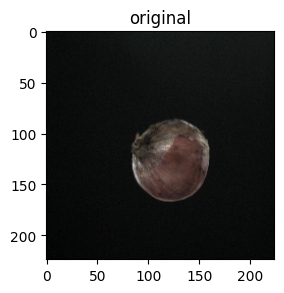

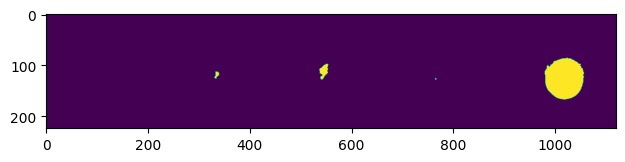

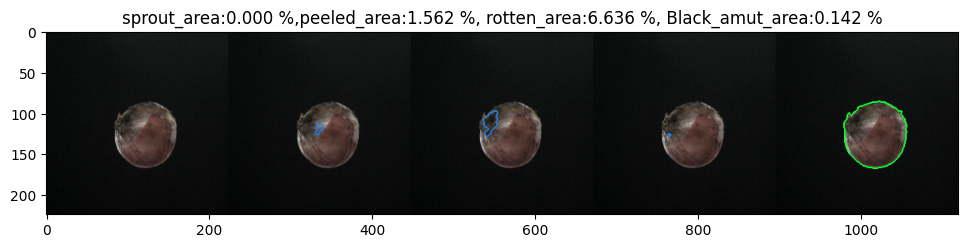

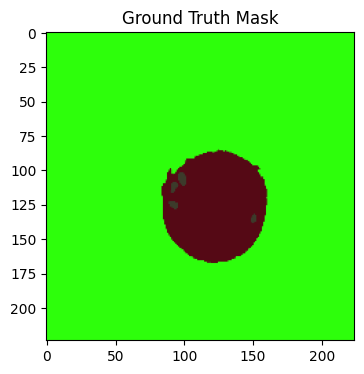

name of the image 120_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06087350845336914 sec


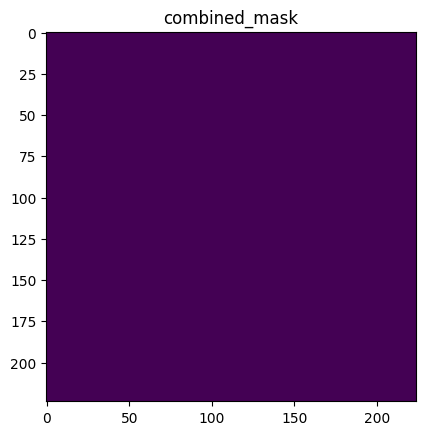

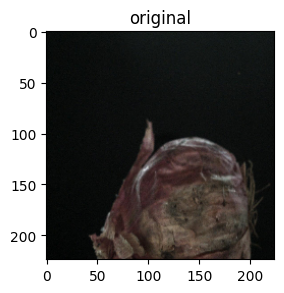

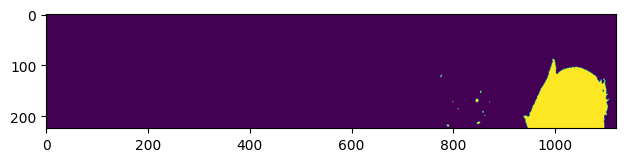

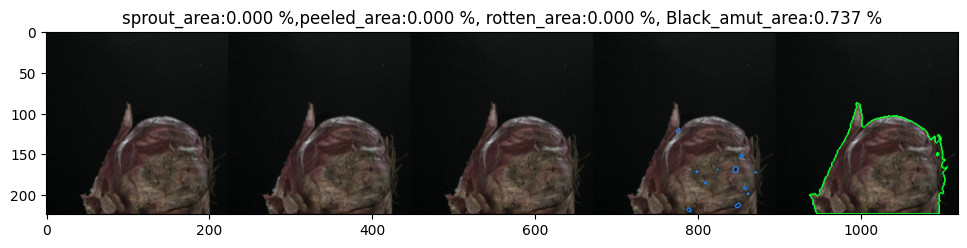

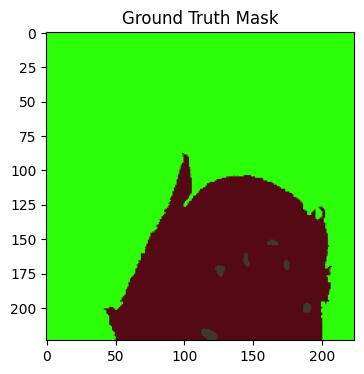

name of the image 111_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.053955793380737305 sec


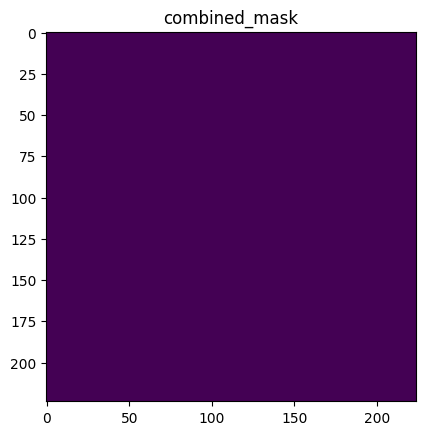

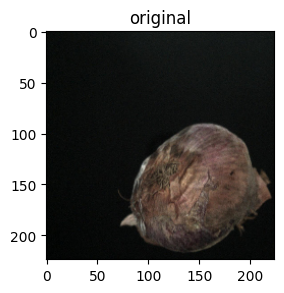

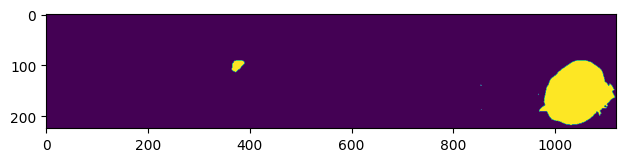

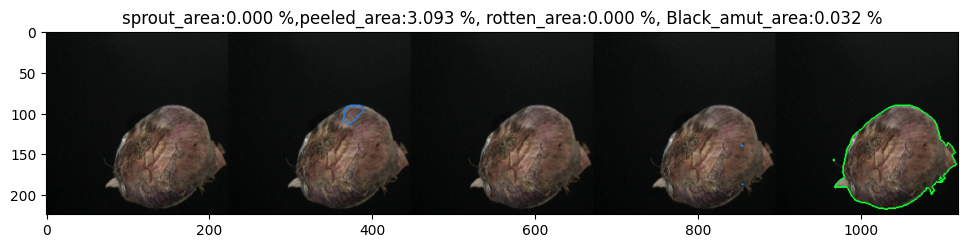

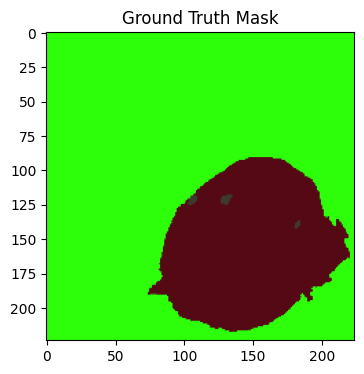

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [8]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/Blacksmut_T/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/Blacksmut_T/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Rotten

name of the image 416_.jpg
Inference time: 0.08 sec
Time taken for pred is :  0.08576679229736328 sec


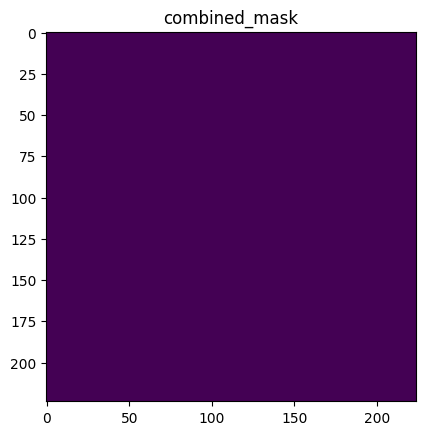

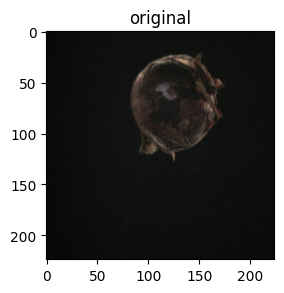

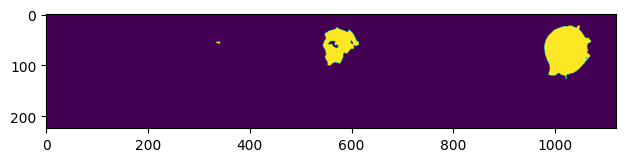

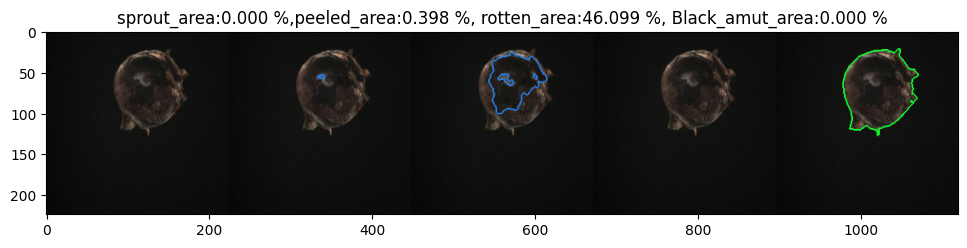

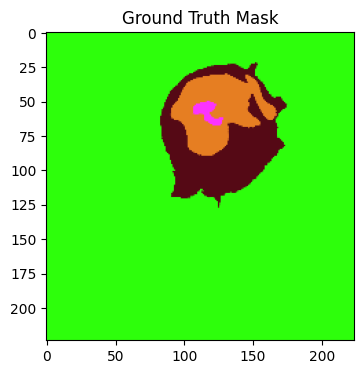

name of the image 464_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05031442642211914 sec


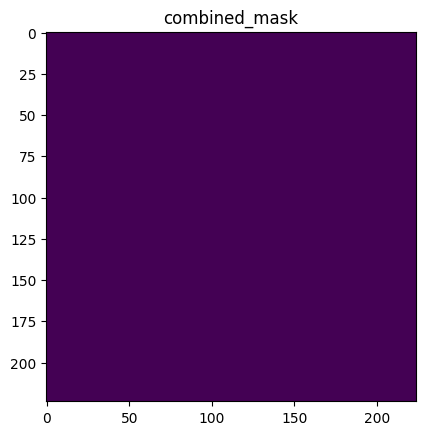

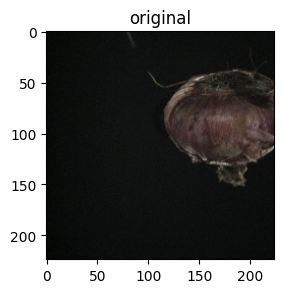

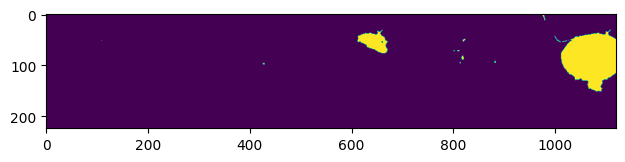

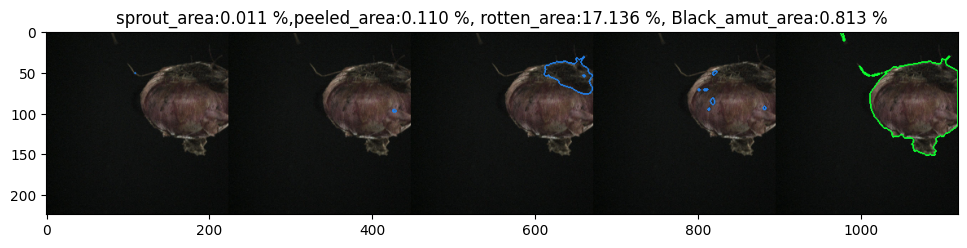

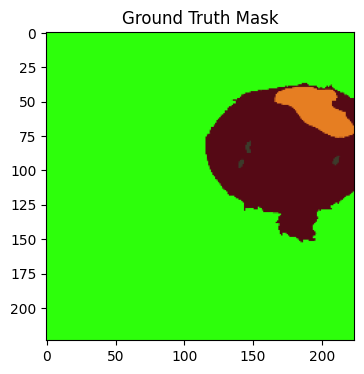

name of the image 466_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.0606081485748291 sec


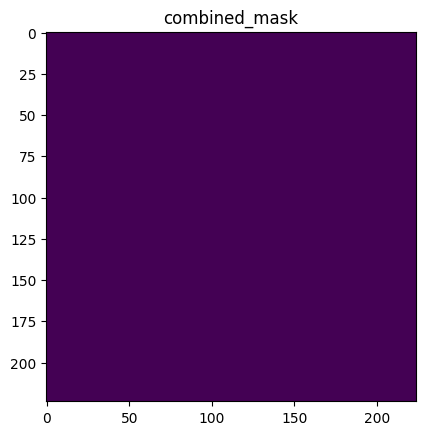

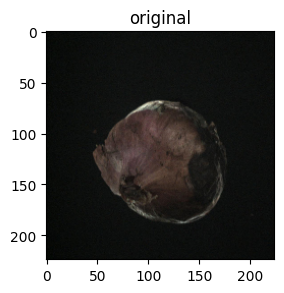

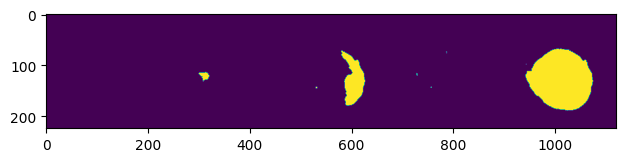

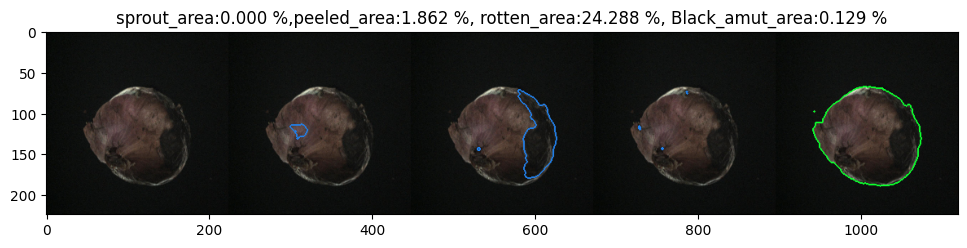

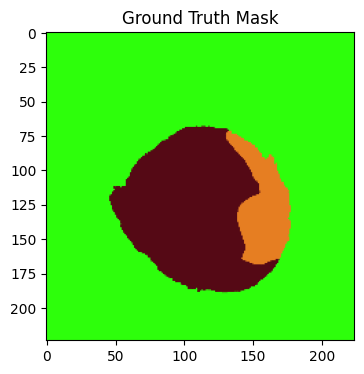

name of the image 442_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05240511894226074 sec


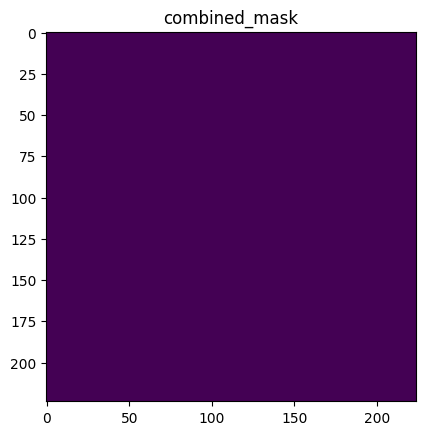

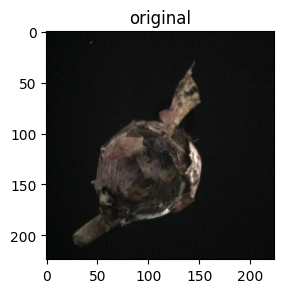

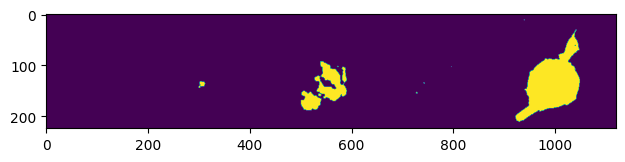

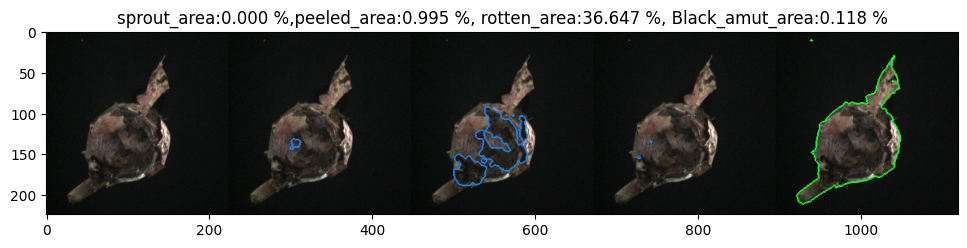

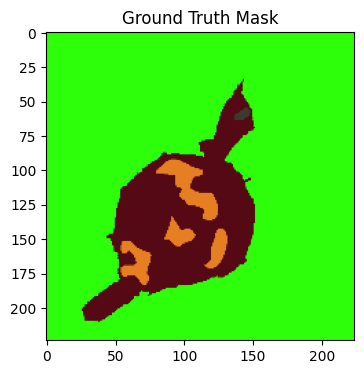

name of the image 418_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05529379844665527 sec


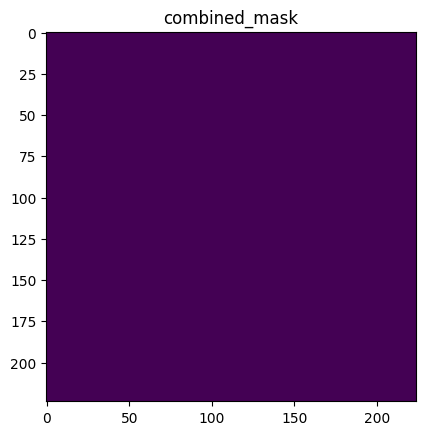

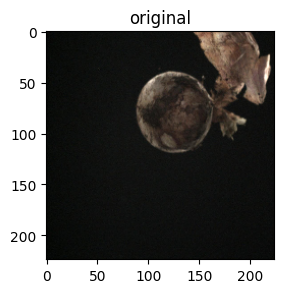

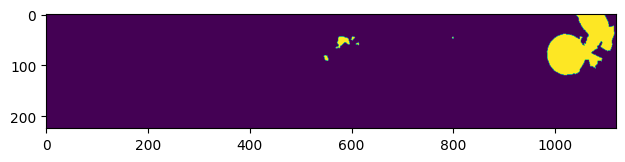

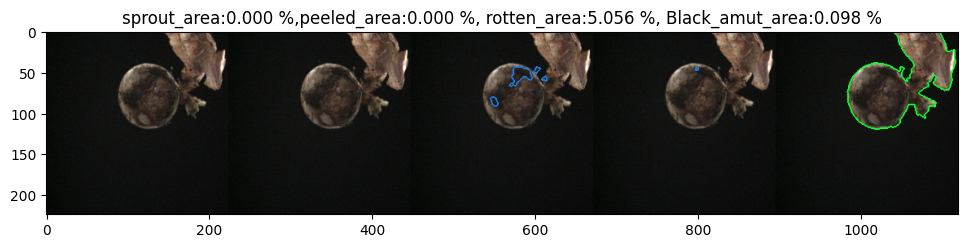

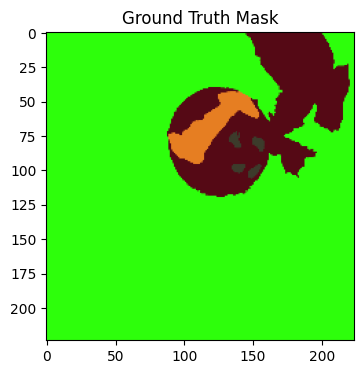

name of the image 444_.jpg
Inference time: 0.11 sec
Time taken for pred is :  0.11317300796508789 sec


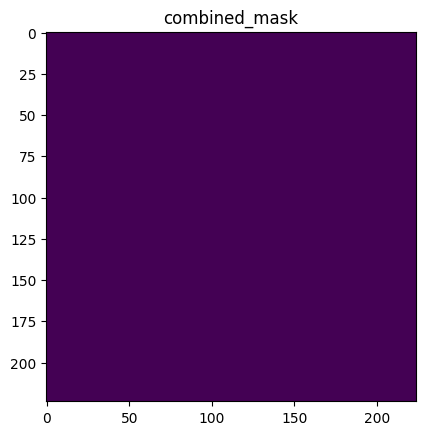

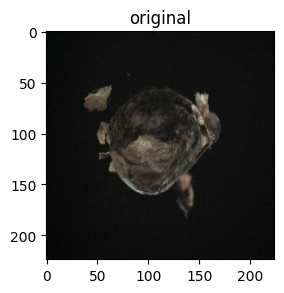

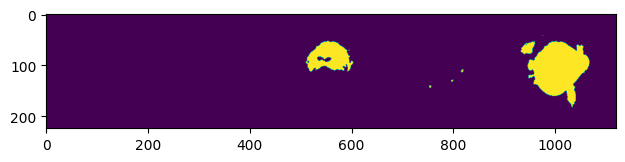

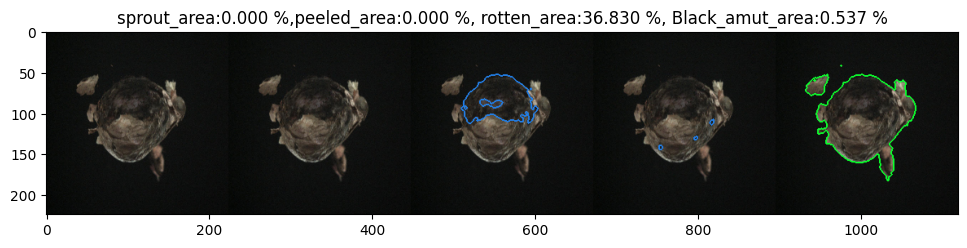

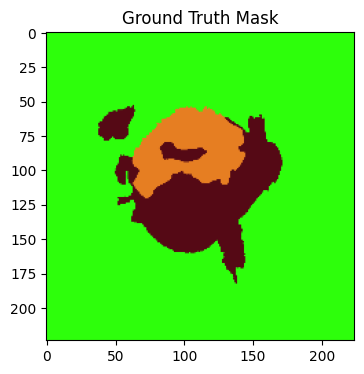

name of the image 437_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.049108028411865234 sec


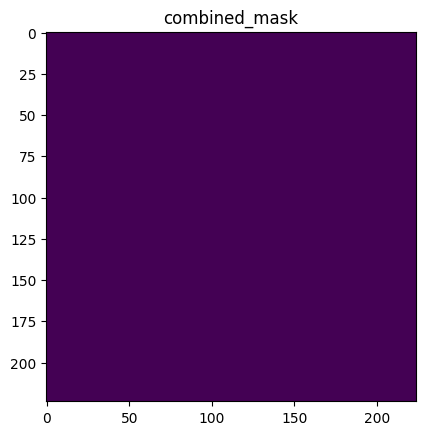

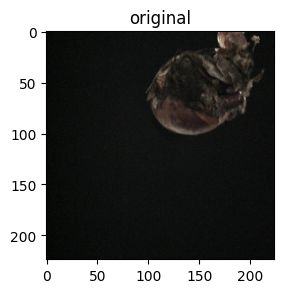

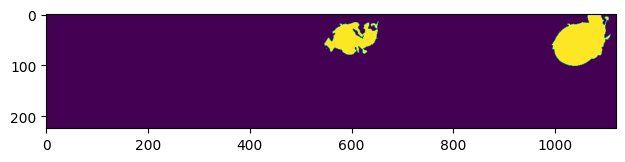

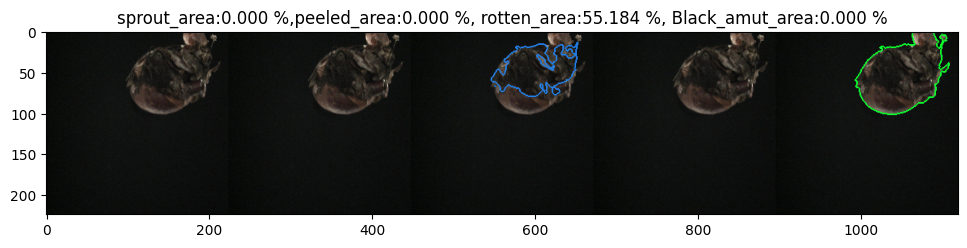

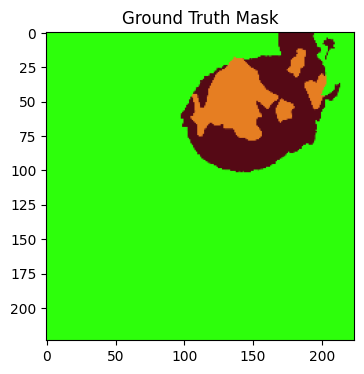

name of the image 441_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05229663848876953 sec


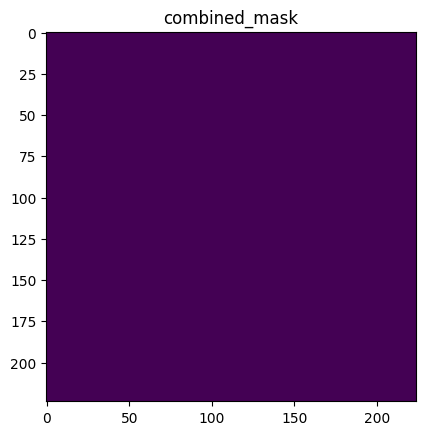

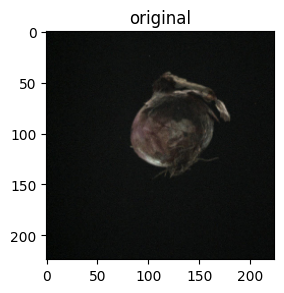

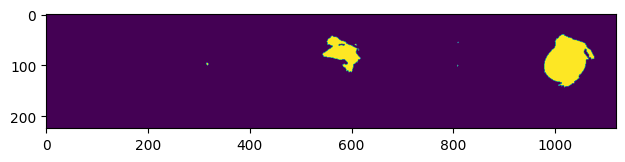

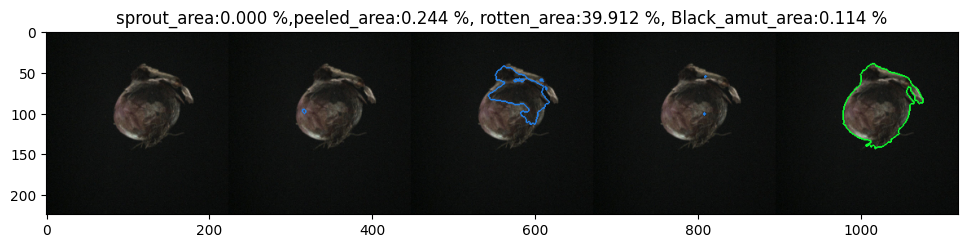

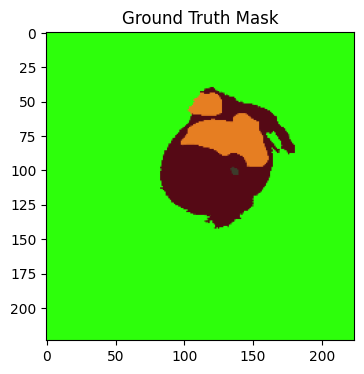

name of the image 463_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05130457878112793 sec


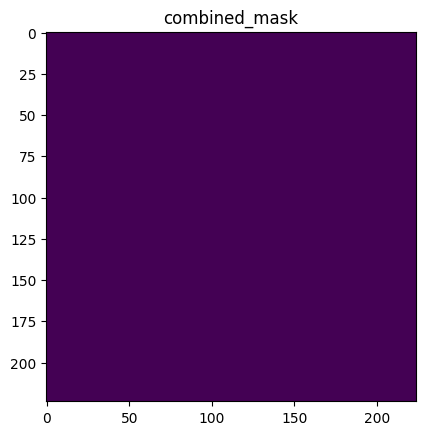

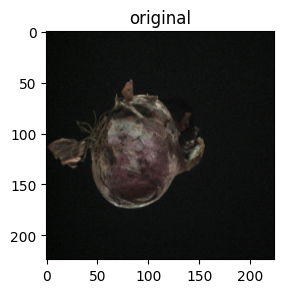

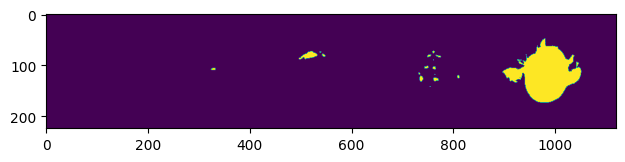

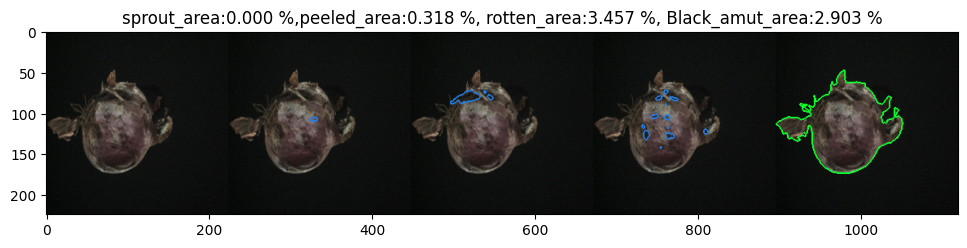

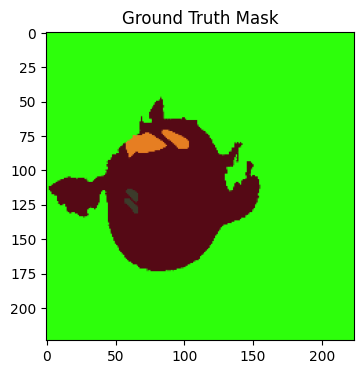

name of the image 435_.jpg
Inference time: 0.19 sec
Time taken for pred is :  0.20654892921447754 sec


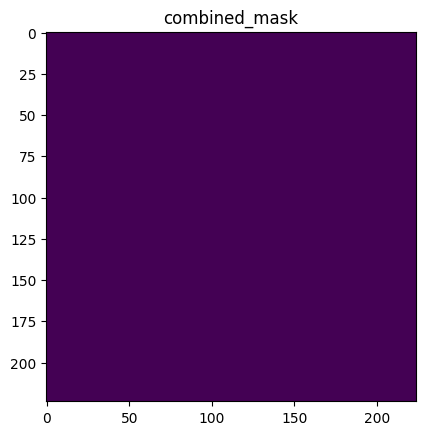

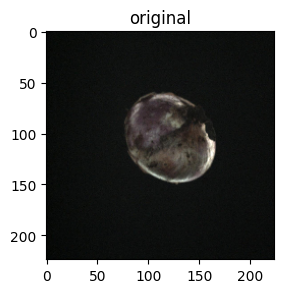

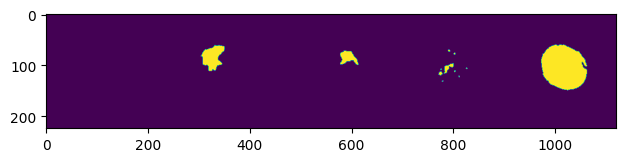

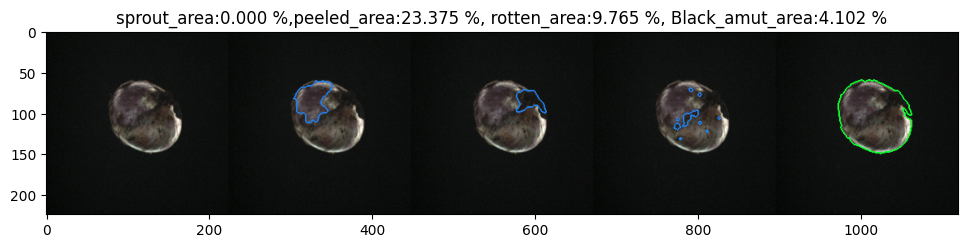

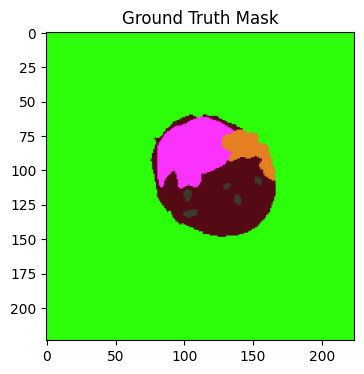

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [9]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/Rotten/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/Rotten/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Different Intensity.

## Rotten

name of the image 554_.jpg
Inference time: 0.08 sec
Time taken for pred is :  0.08418488502502441 sec


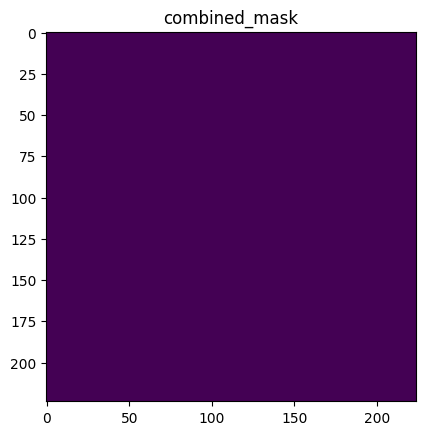

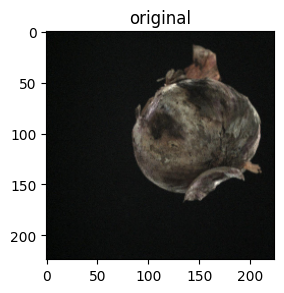

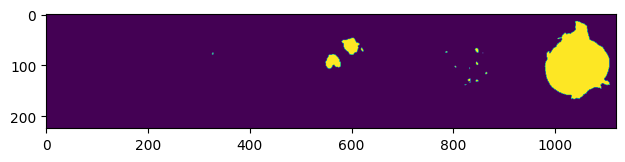

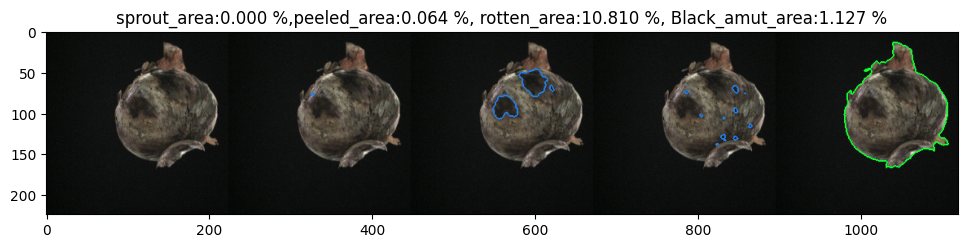

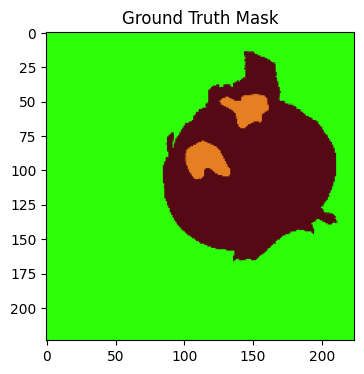

name of the image 495_.jpg
Inference time: 0.07 sec
Time taken for pred is :  0.06868791580200195 sec


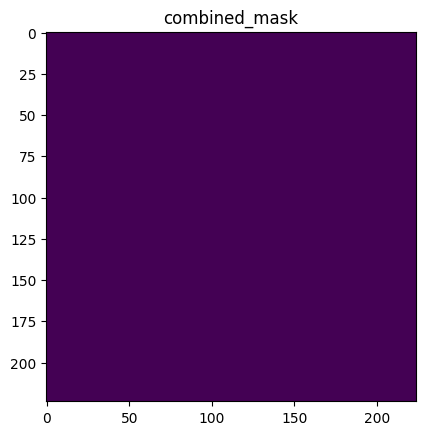

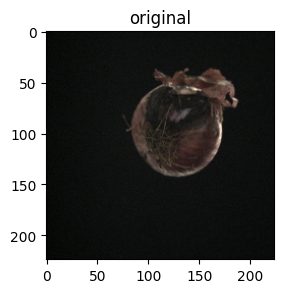

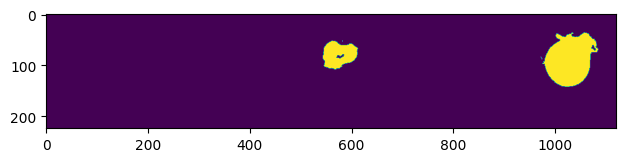

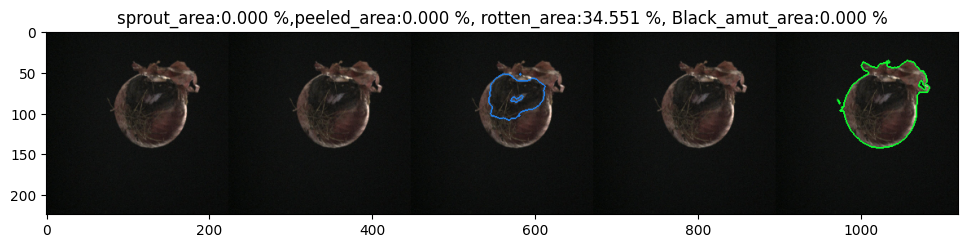

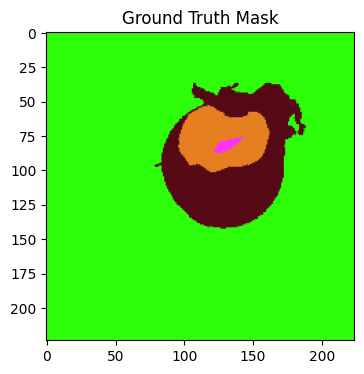

name of the image 548_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.05897998809814453 sec


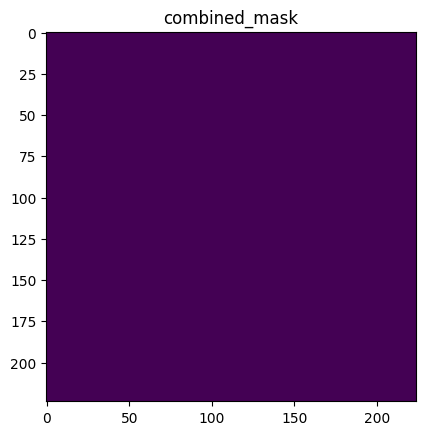

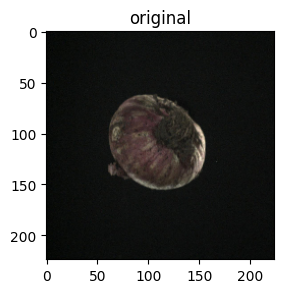

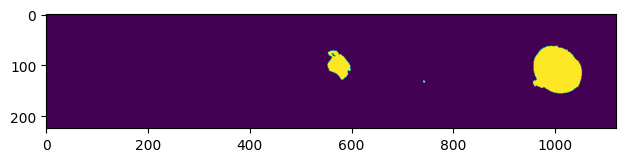

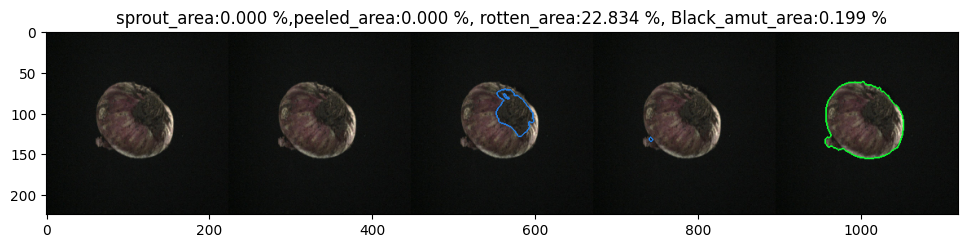

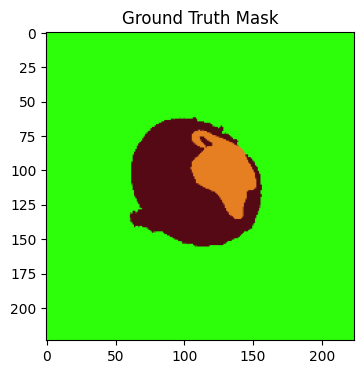

name of the image 588_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.056101083755493164 sec


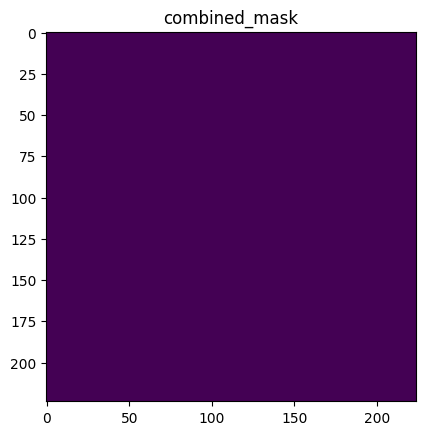

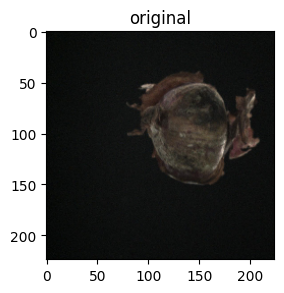

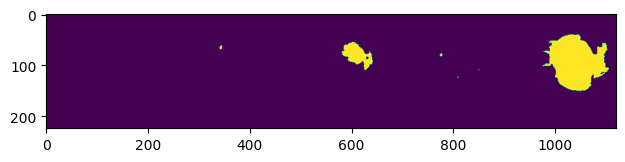

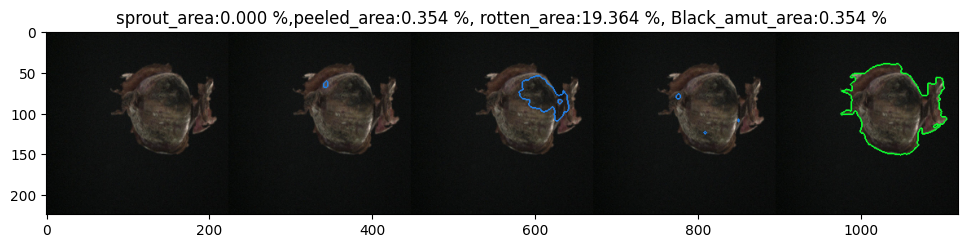

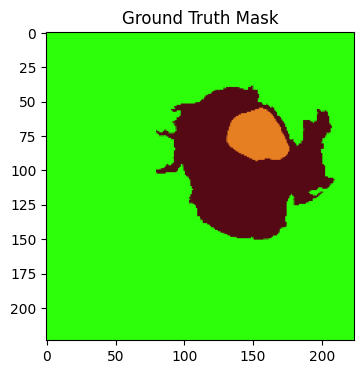

name of the image 591_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.054787397384643555 sec


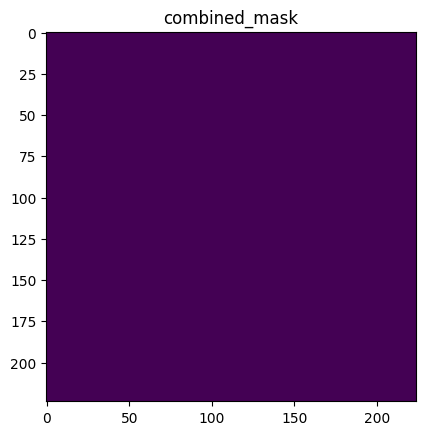

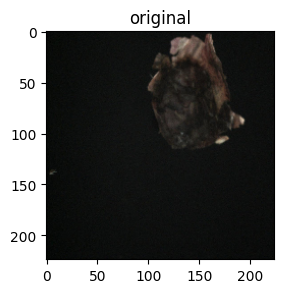

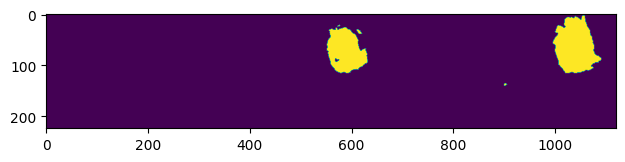

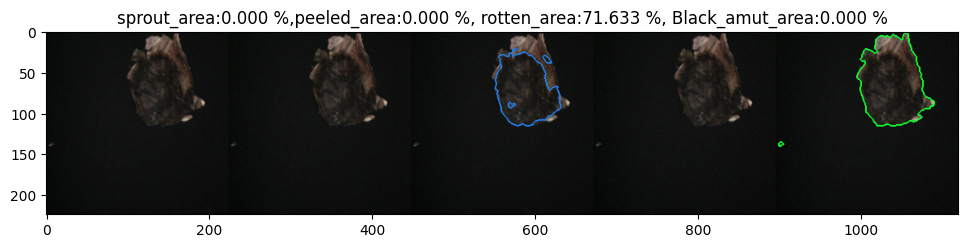

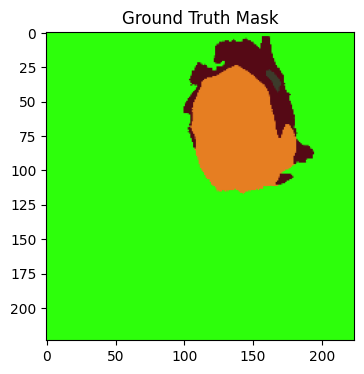

name of the image 546_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05543923377990723 sec


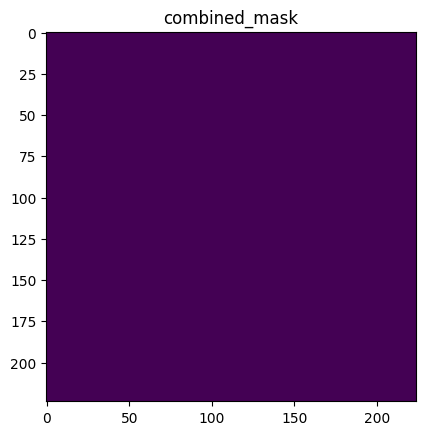

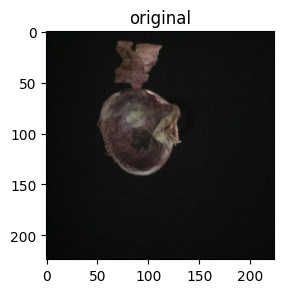

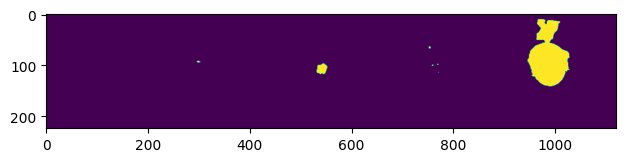

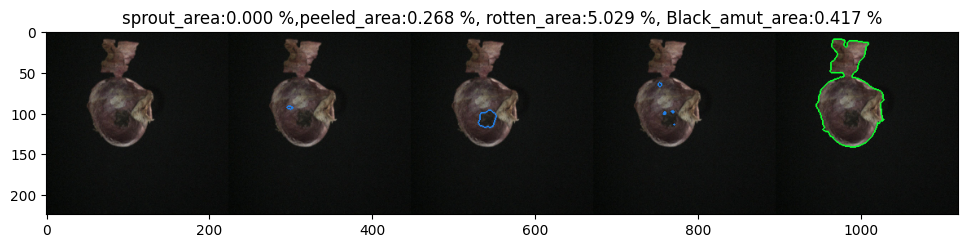

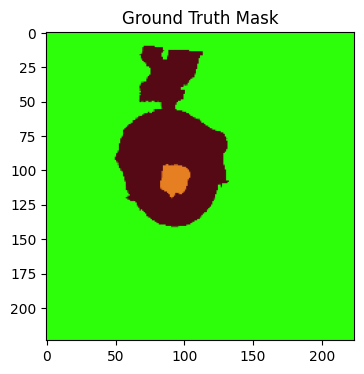

name of the image 550_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05363345146179199 sec


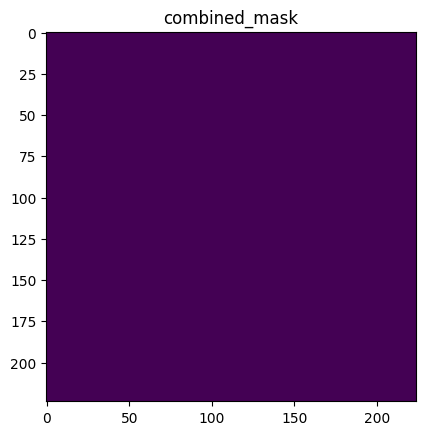

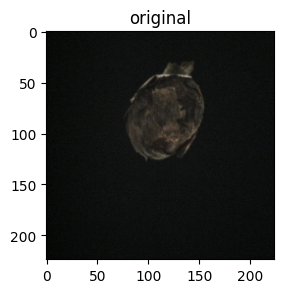

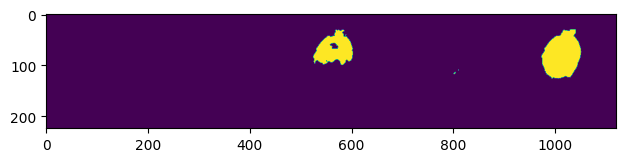

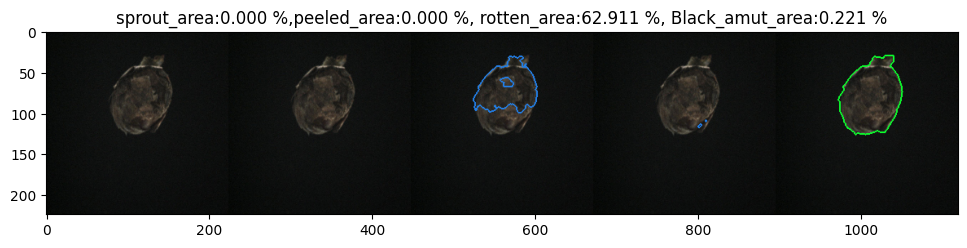

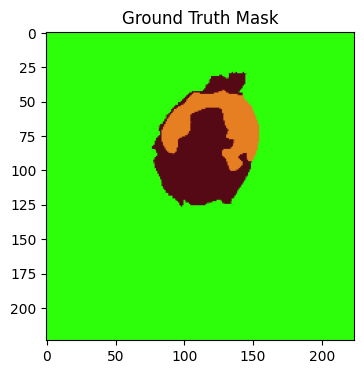

name of the image 527_.jpg
Inference time: 0.13 sec
Time taken for pred is :  0.13402891159057617 sec


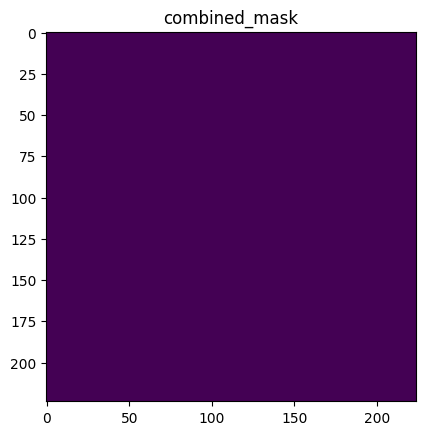

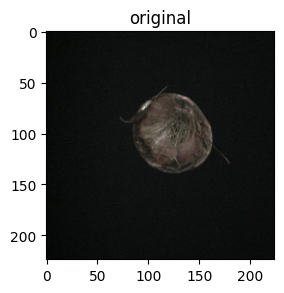

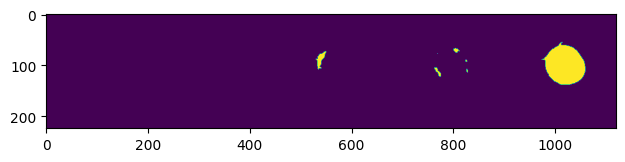

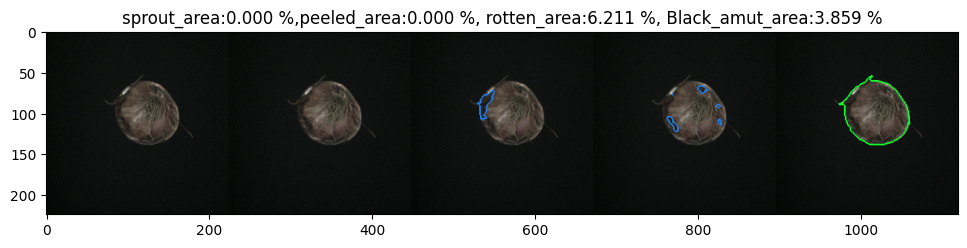

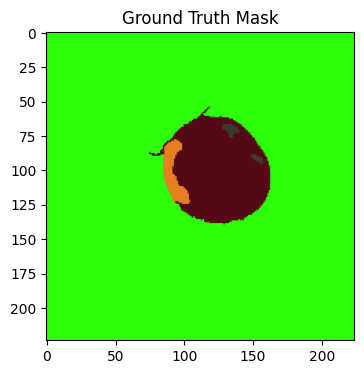

name of the image 597_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05273771286010742 sec


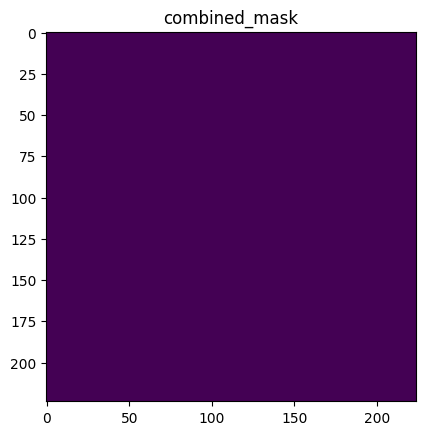

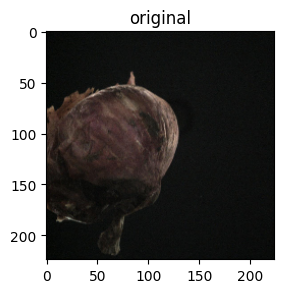

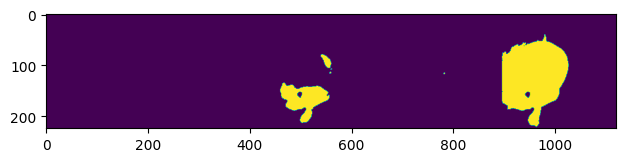

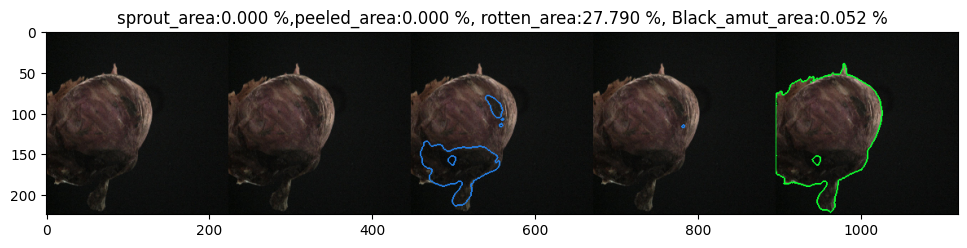

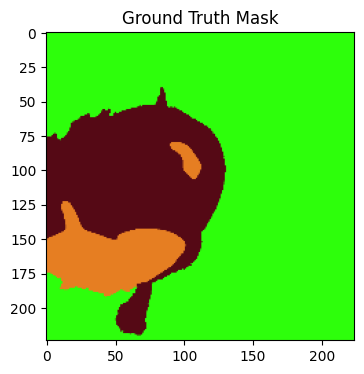

name of the image 523_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05539679527282715 sec


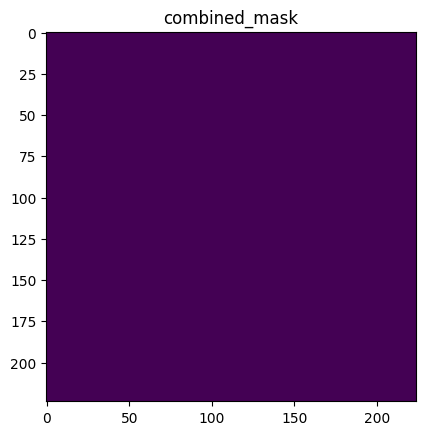

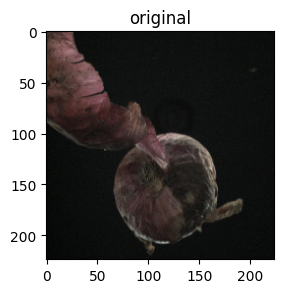

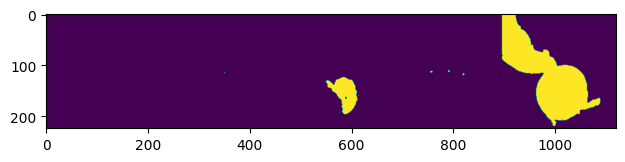

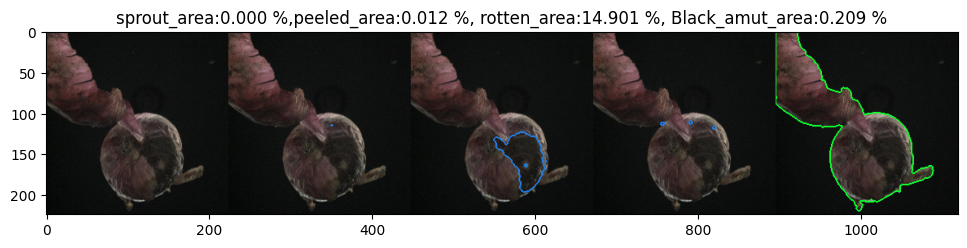

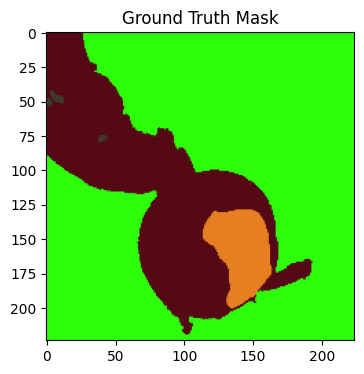

name of the image 513_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05164217948913574 sec


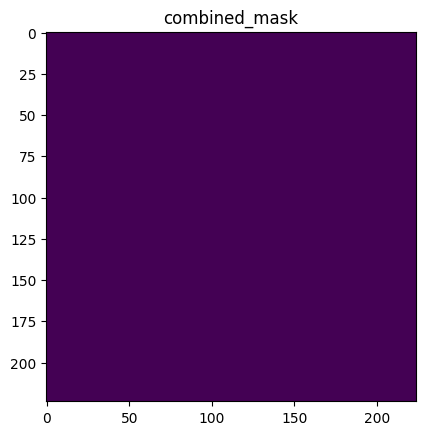

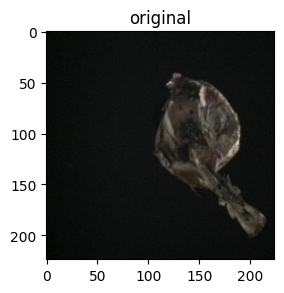

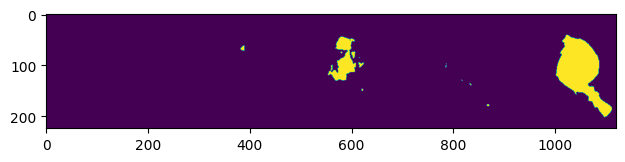

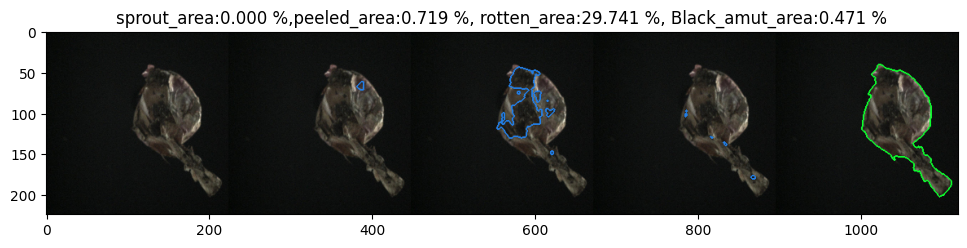

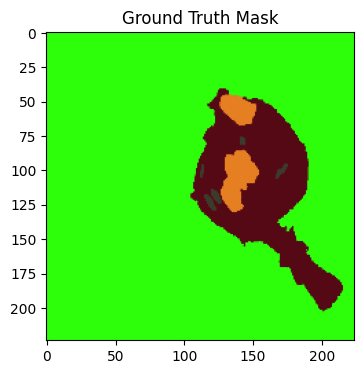

name of the image 539_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.059790849685668945 sec


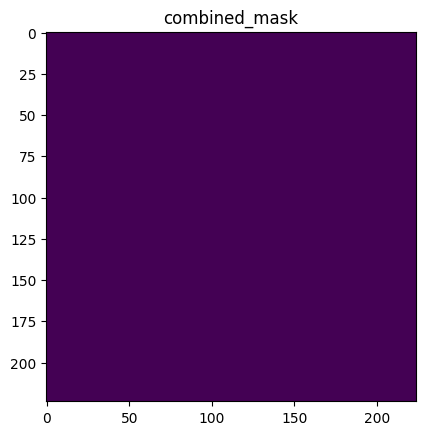

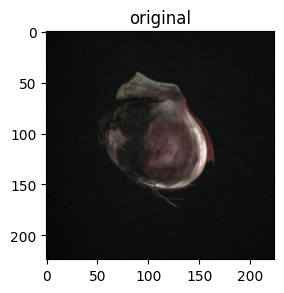

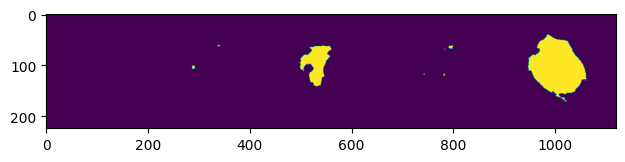

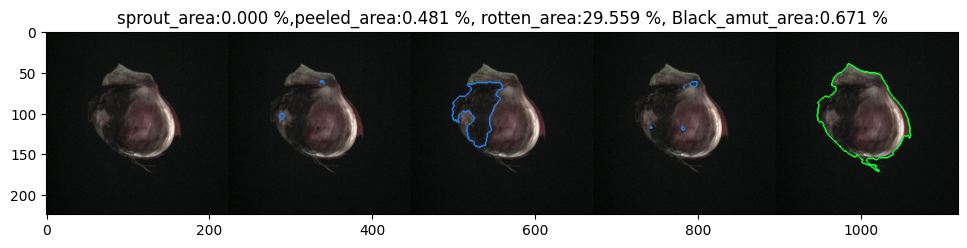

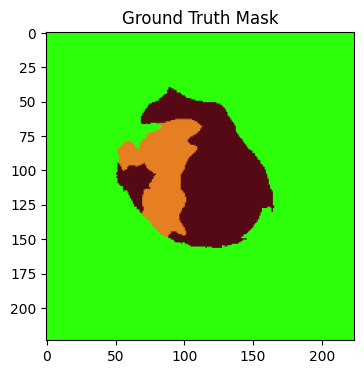

name of the image 516_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.056363821029663086 sec


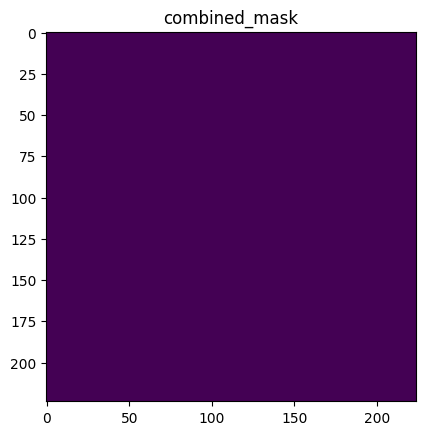

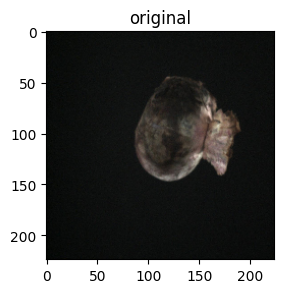

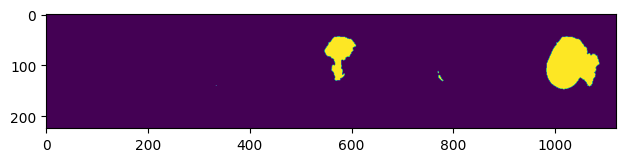

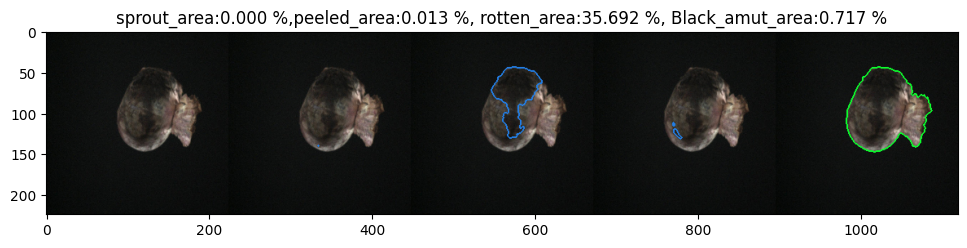

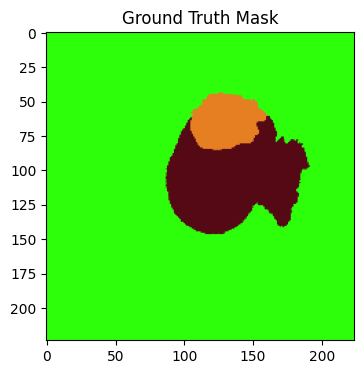

name of the image 524_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06682324409484863 sec


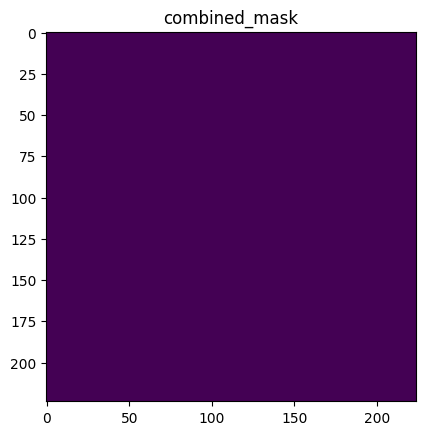

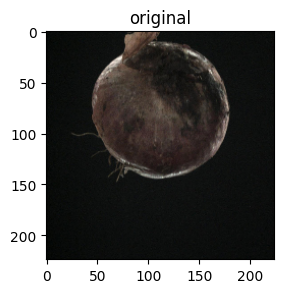

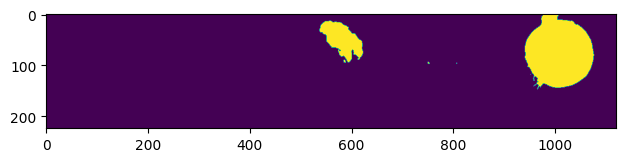

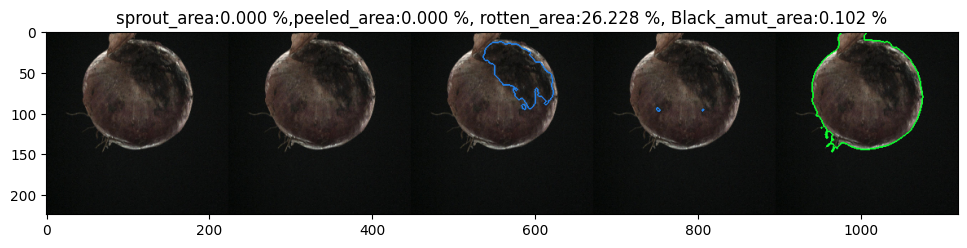

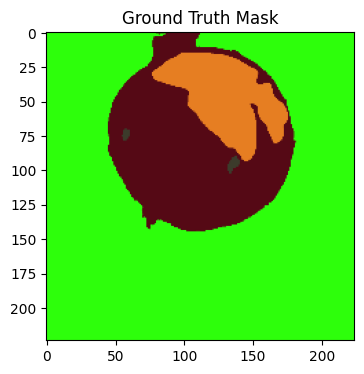

name of the image 552_.jpg
Inference time: 0.07 sec
Time taken for pred is :  0.06891107559204102 sec


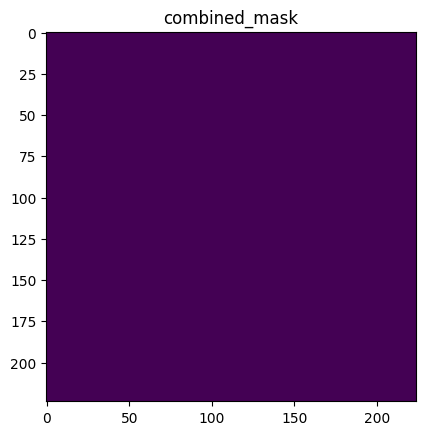

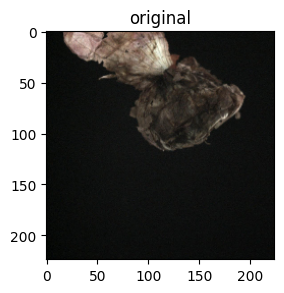

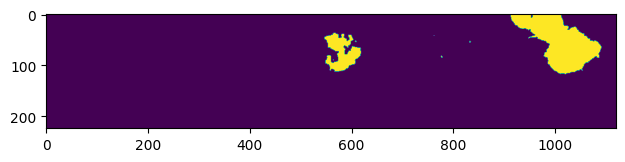

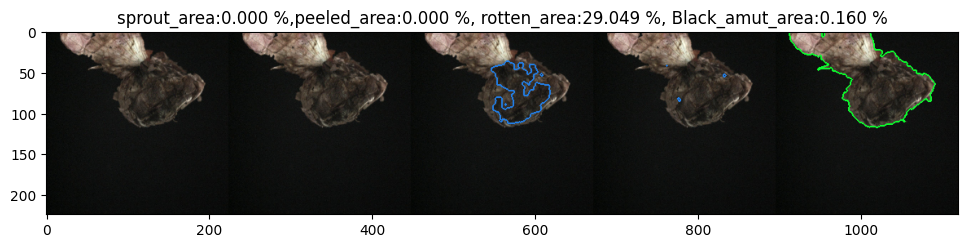

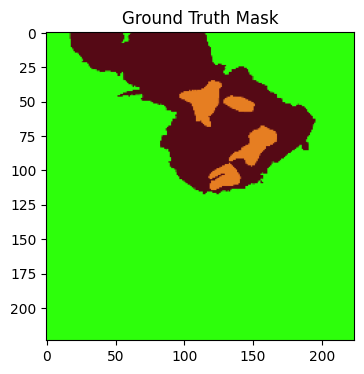

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [10]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Rotten_17_07/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Rotten_17_07/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Peeled

name of the image 577_.jpg
Inference time: 0.09 sec
Time taken for pred is :  0.09893155097961426 sec


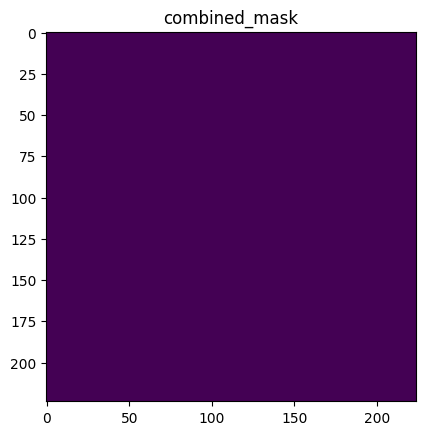

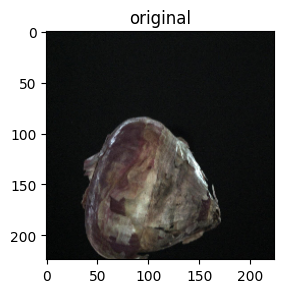

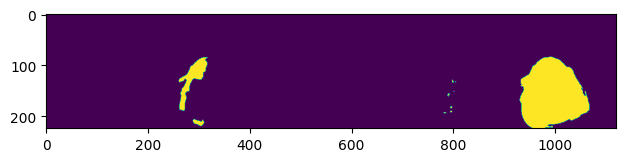

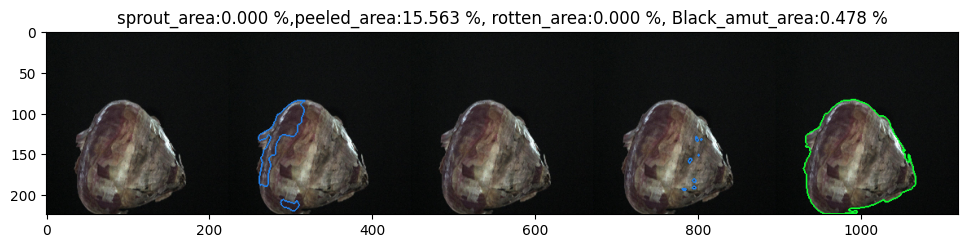

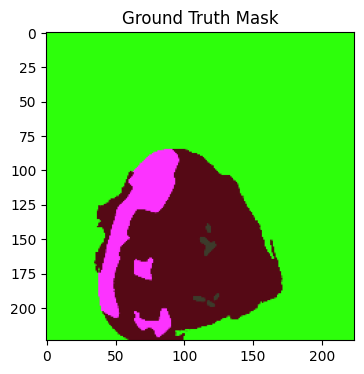

name of the image 581_.jpg
Inference time: 0.12 sec
Time taken for pred is :  0.12025237083435059 sec


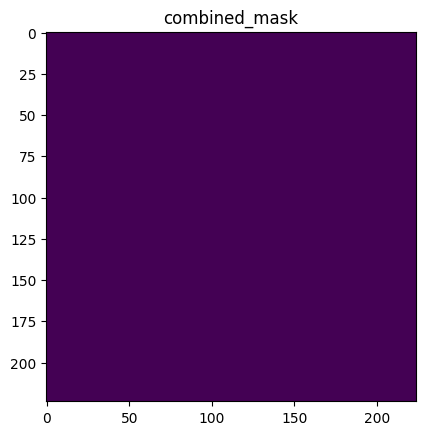

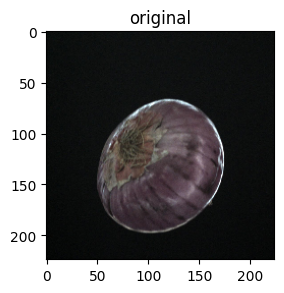

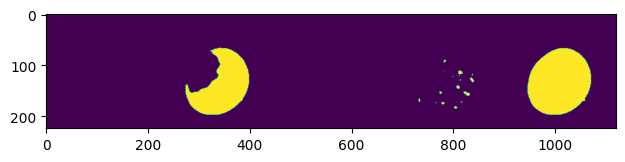

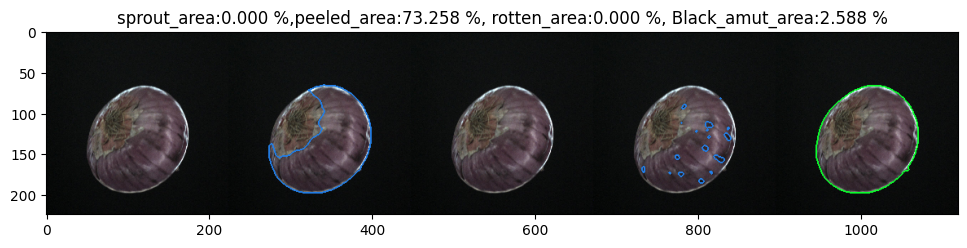

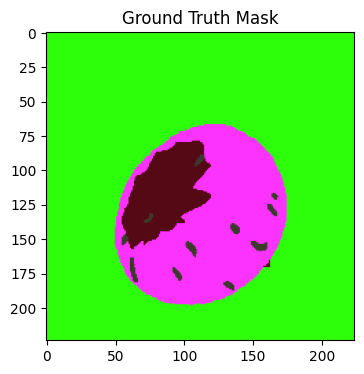

name of the image 579_.jpg
Inference time: 0.13 sec
Time taken for pred is :  0.13297176361083984 sec


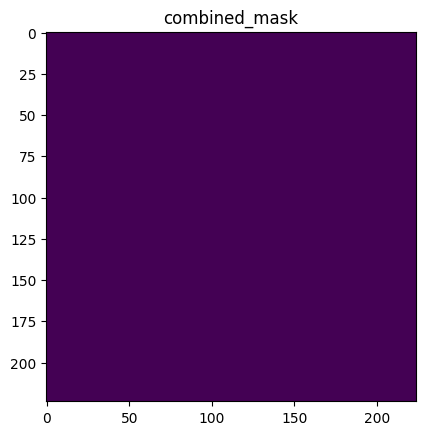

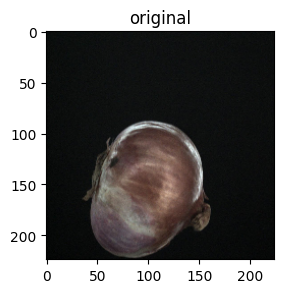

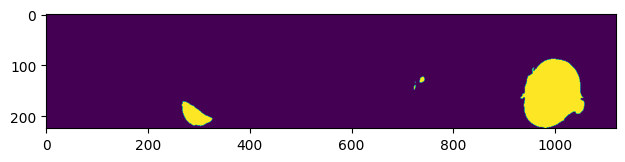

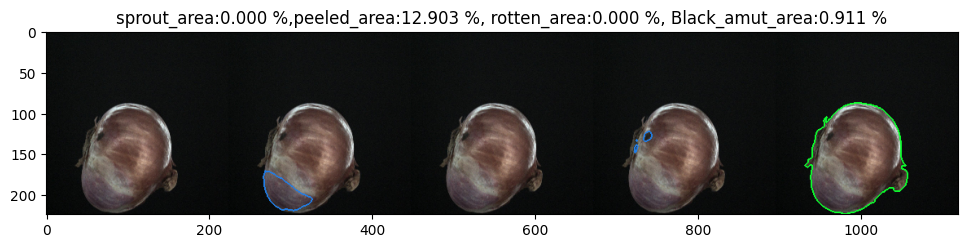

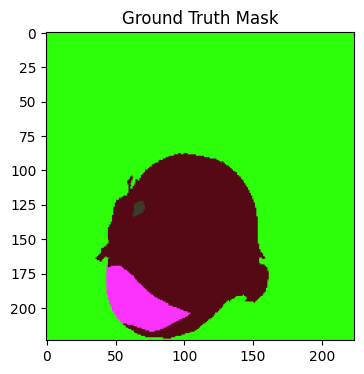

name of the image 566_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06075572967529297 sec


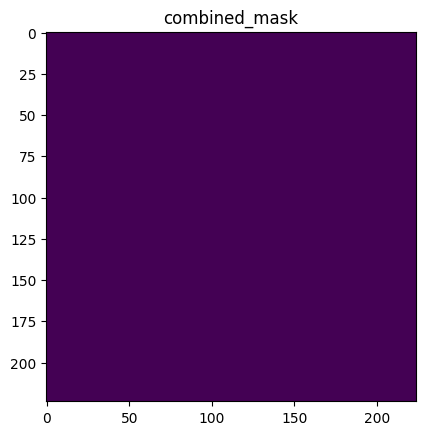

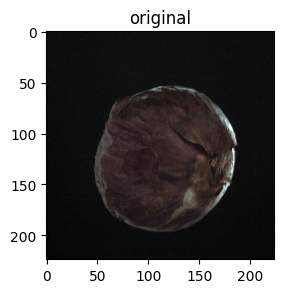

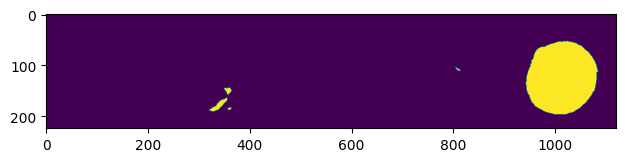

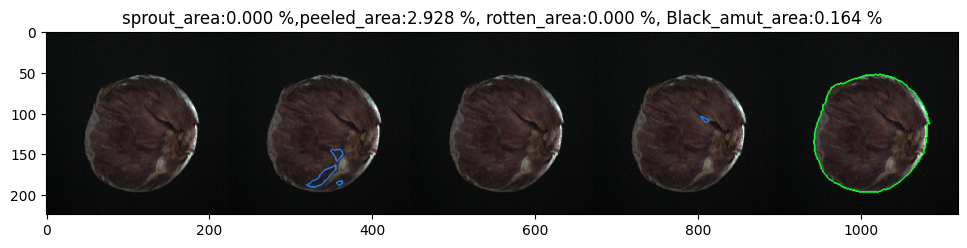

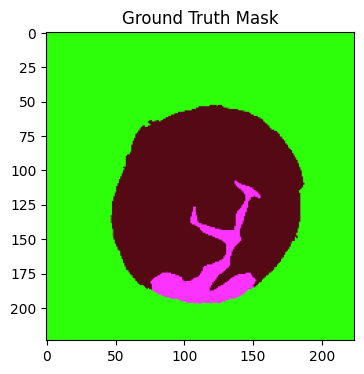

name of the image 596_.jpg
Inference time: 0.11 sec
Time taken for pred is :  0.11267518997192383 sec


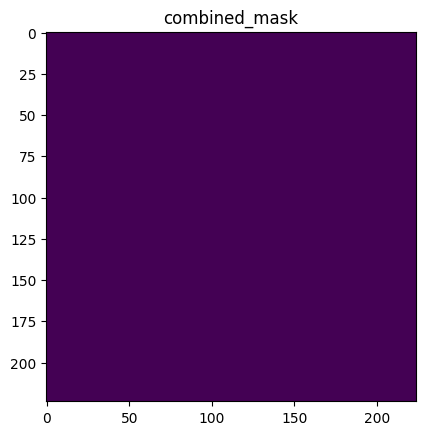

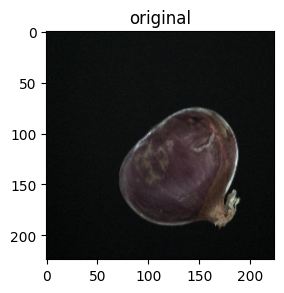

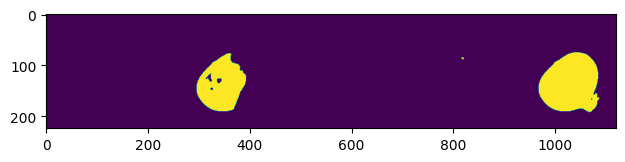

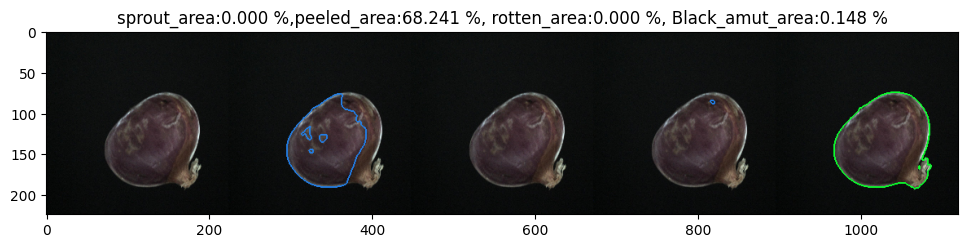

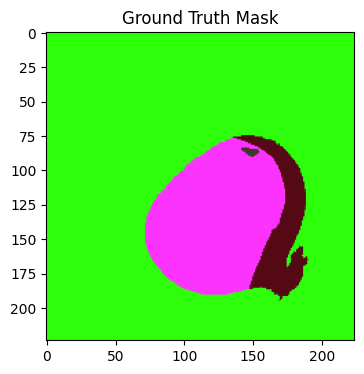

name of the image 574_.jpg
Inference time: 0.12 sec
Time taken for pred is :  0.13495397567749023 sec


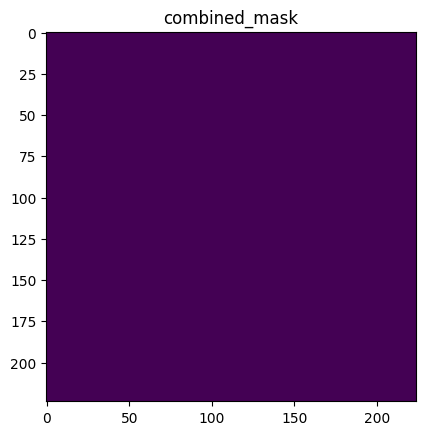

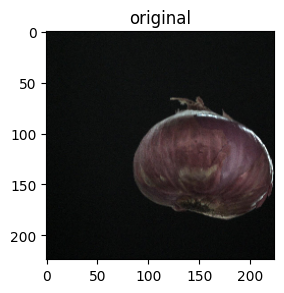

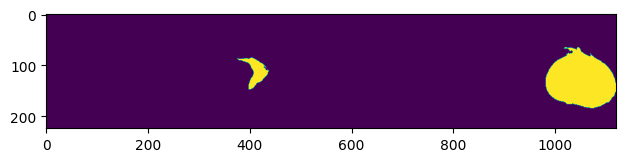

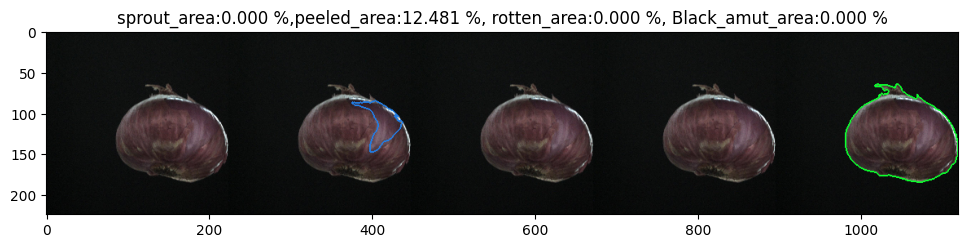

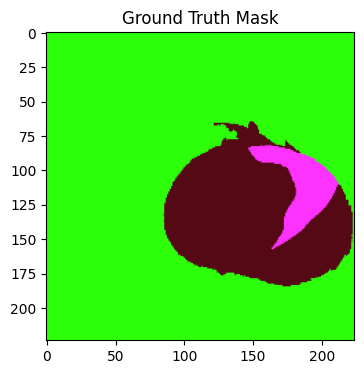

name of the image 563_.jpg
Inference time: 0.12 sec
Time taken for pred is :  0.12389063835144043 sec


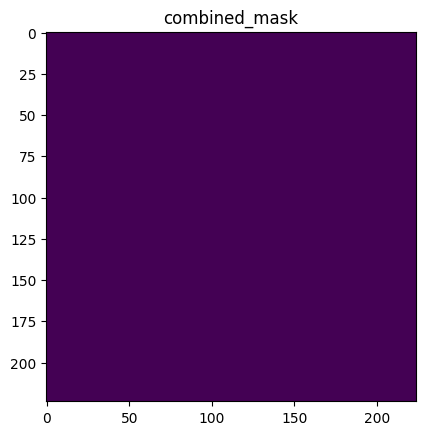

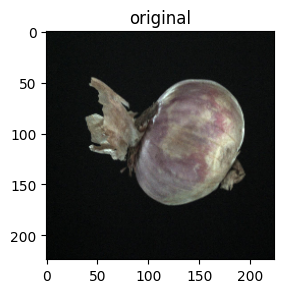

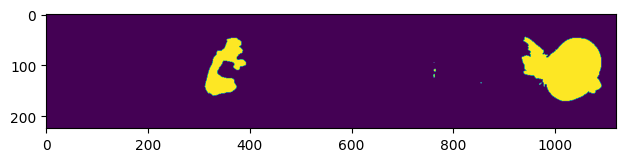

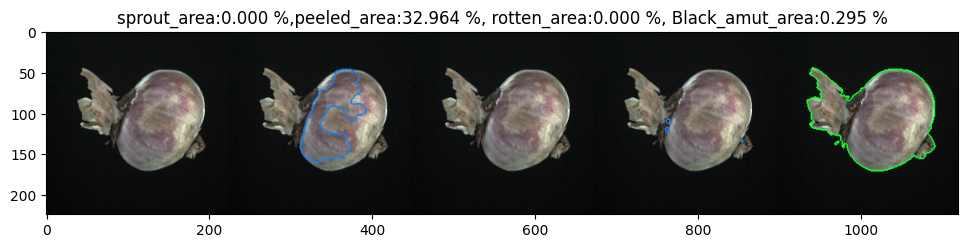

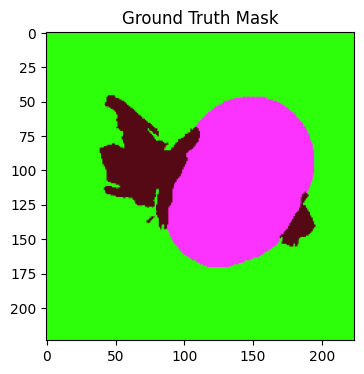

name of the image 564_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06587719917297363 sec


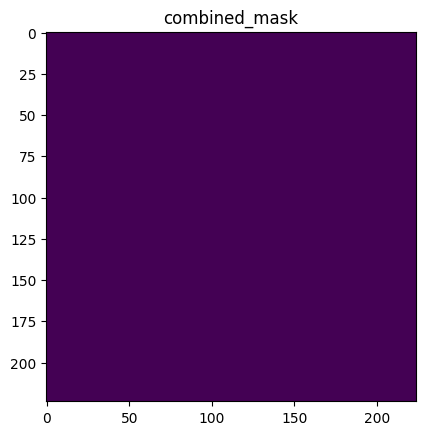

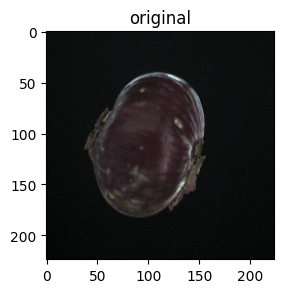

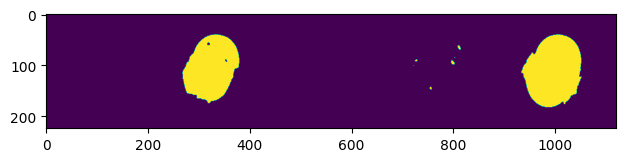

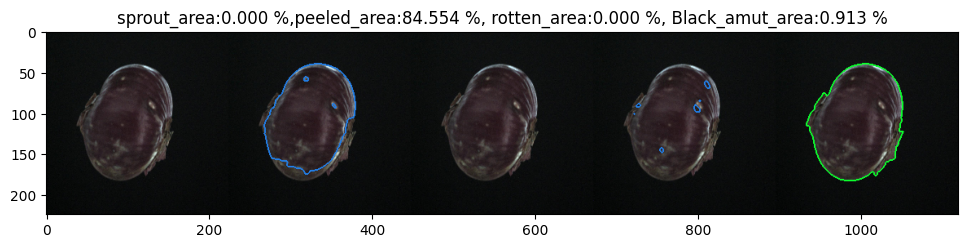

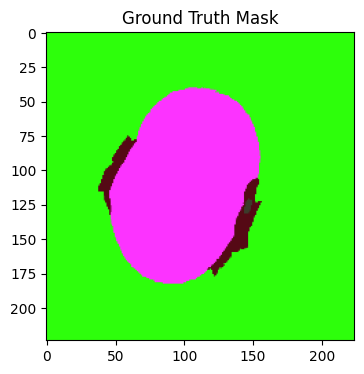

name of the image 560_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05364489555358887 sec


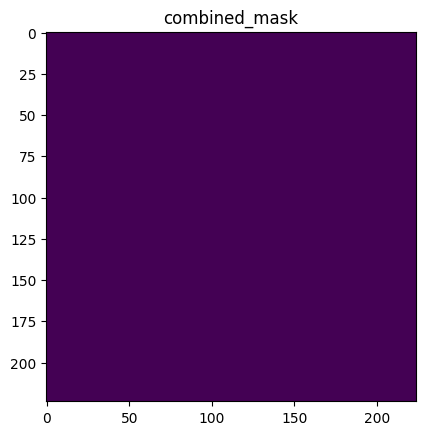

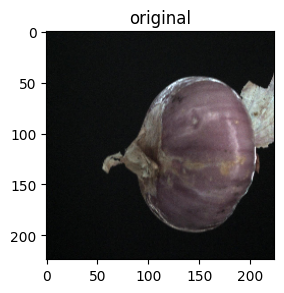

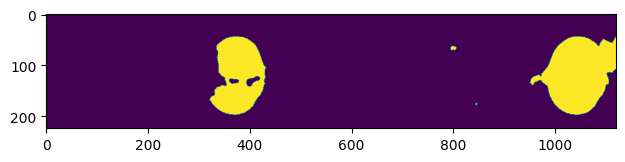

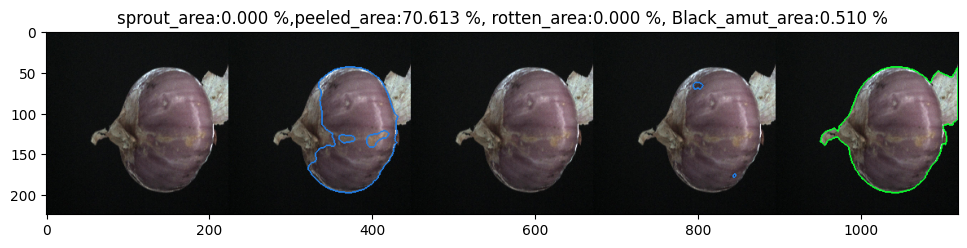

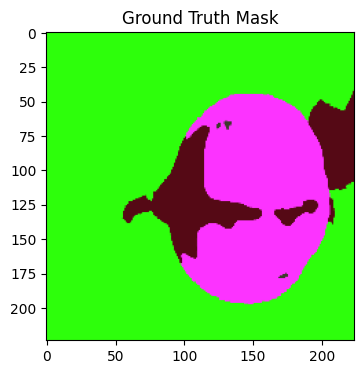

name of the image 586_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.04997396469116211 sec


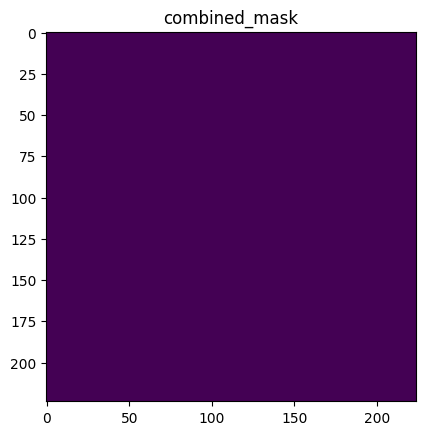

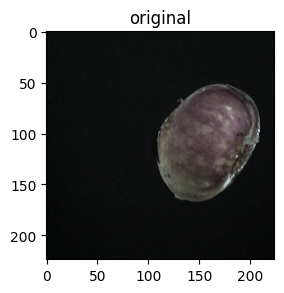

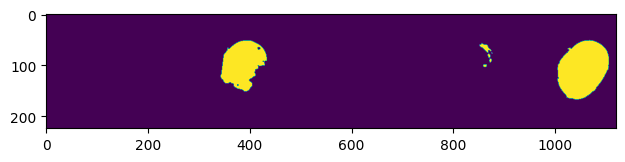

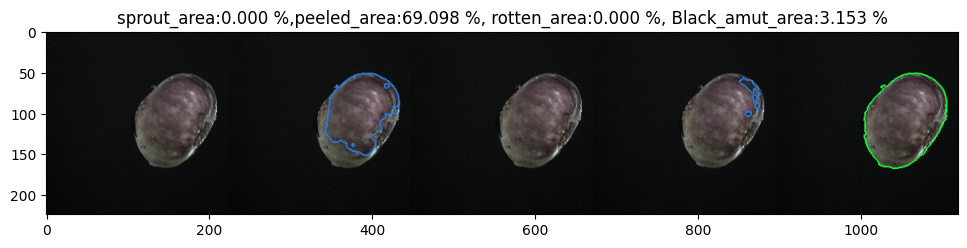

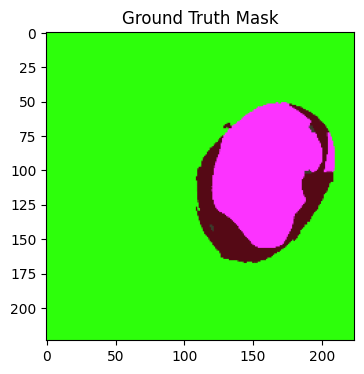

name of the image 572_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.054685115814208984 sec


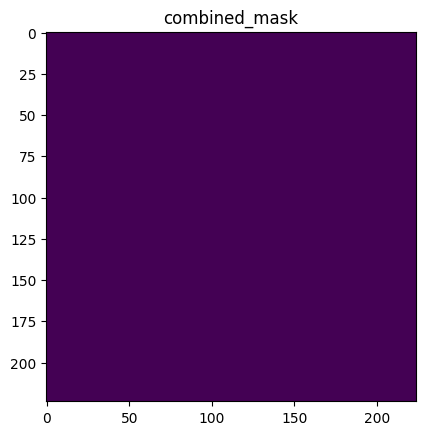

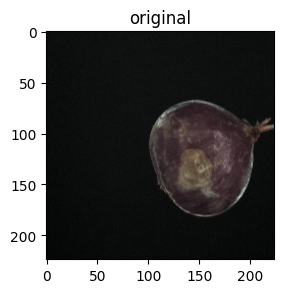

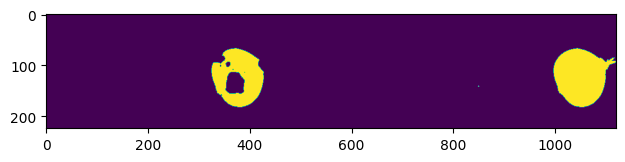

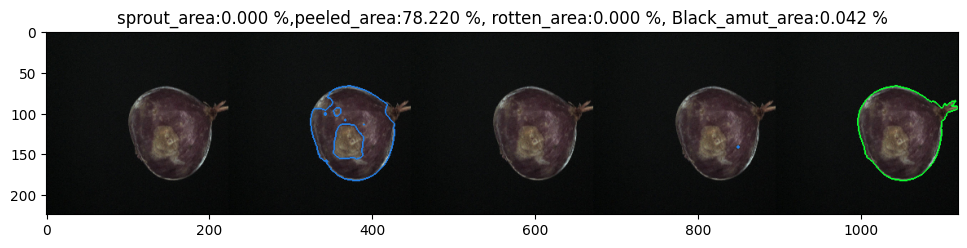

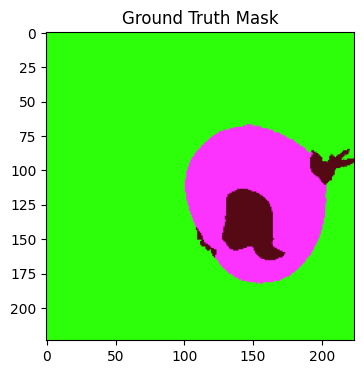

name of the image 592_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05115699768066406 sec


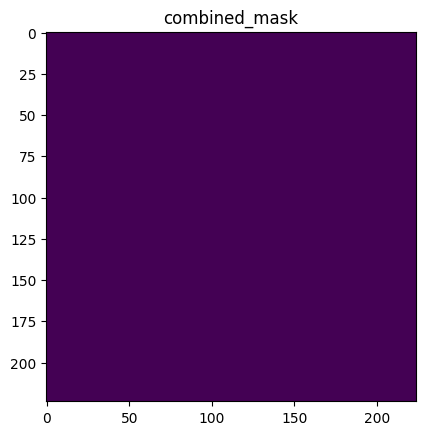

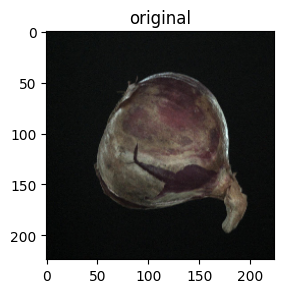

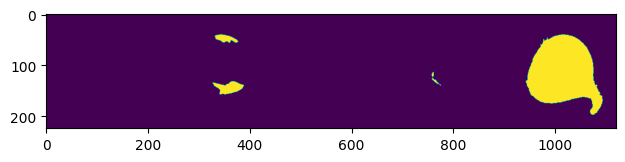

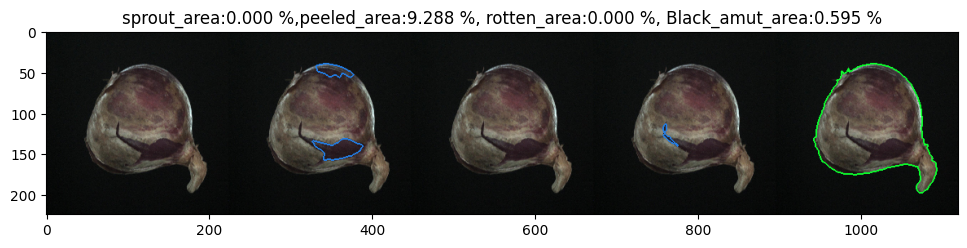

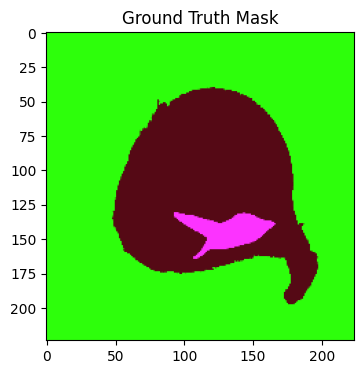

name of the image 600_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05316805839538574 sec


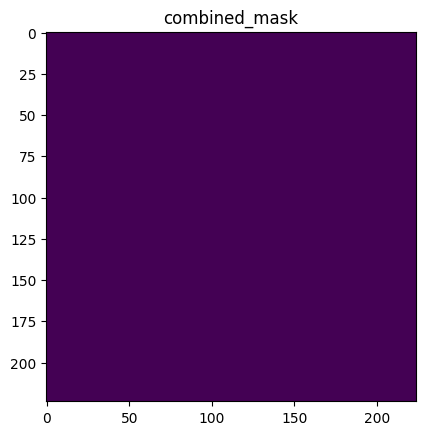

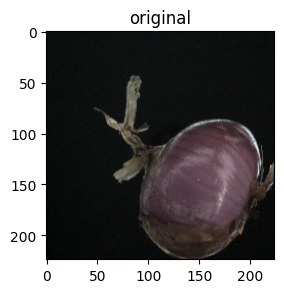

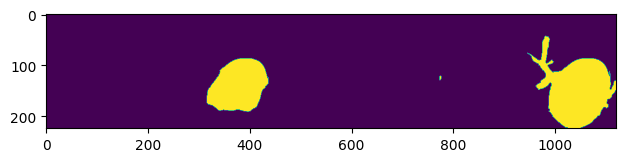

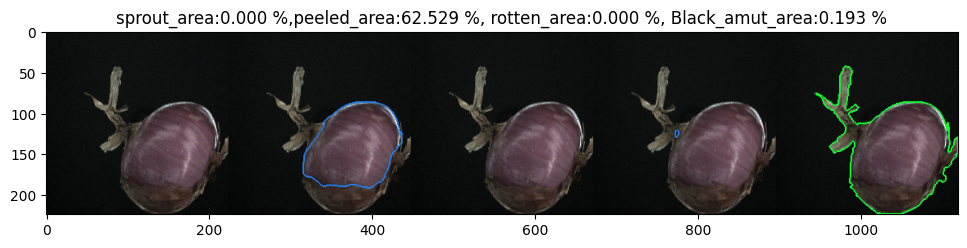

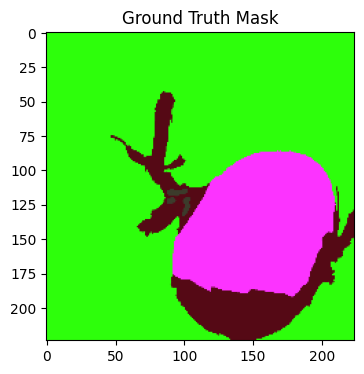

name of the image 571_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.055695533752441406 sec


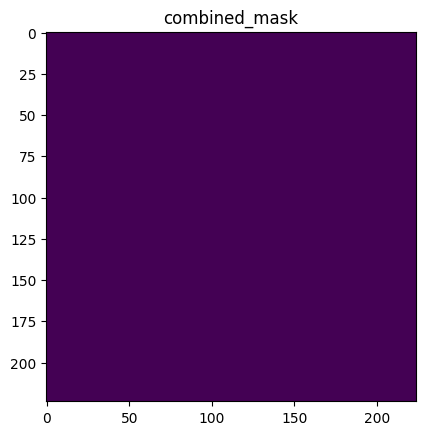

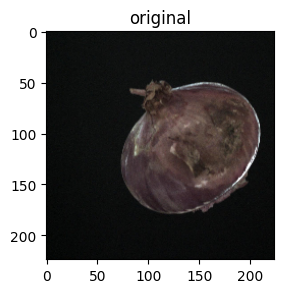

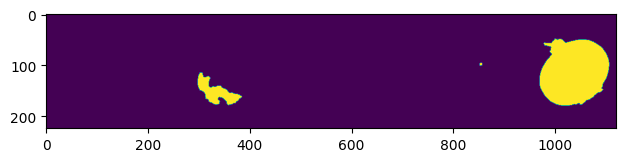

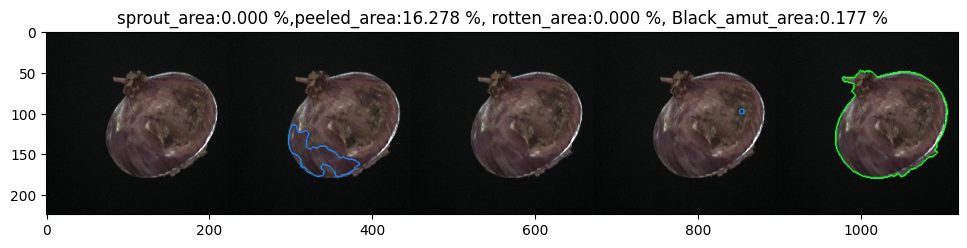

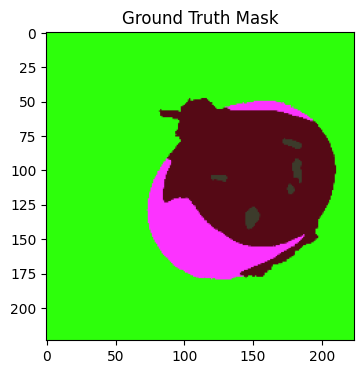

name of the image 607_.jpg
Inference time: 0.09 sec
Time taken for pred is :  0.09579038619995117 sec


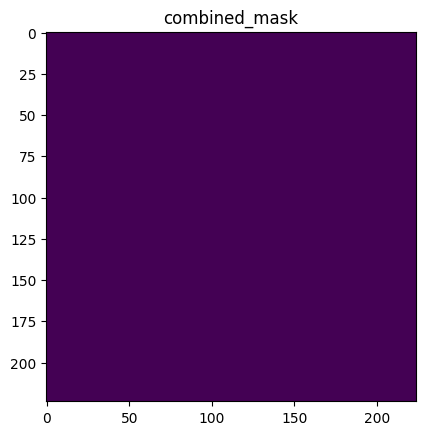

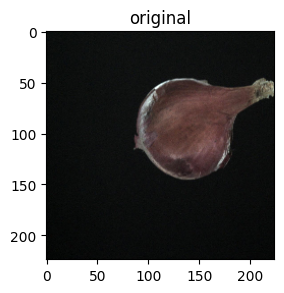

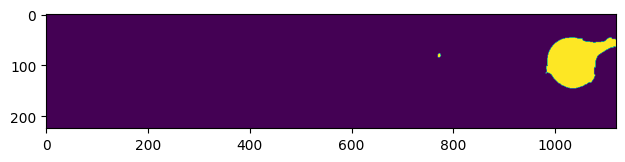

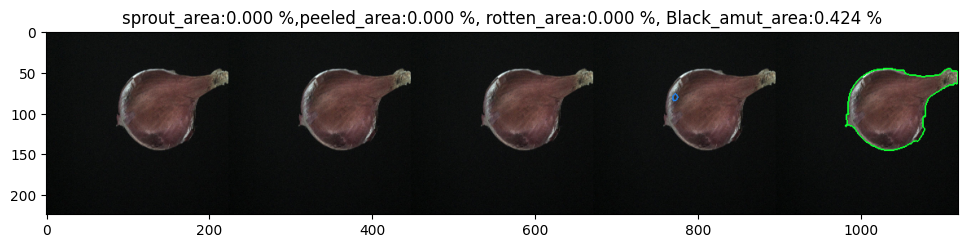

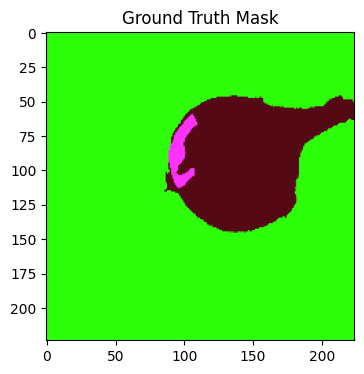

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [11]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Peeled_17_07/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Peeled_17_07/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)

## Blacksmut

name of the image 750_.jpg
Inference time: 0.07 sec
Time taken for pred is :  0.07087850570678711 sec


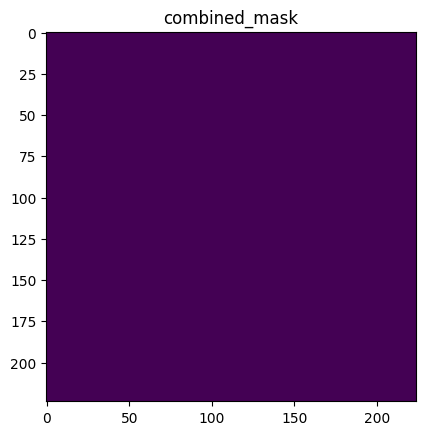

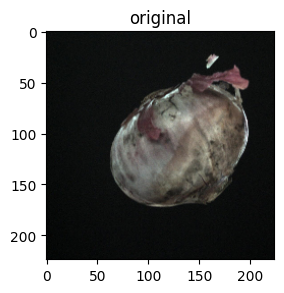

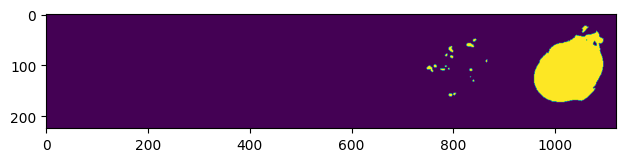

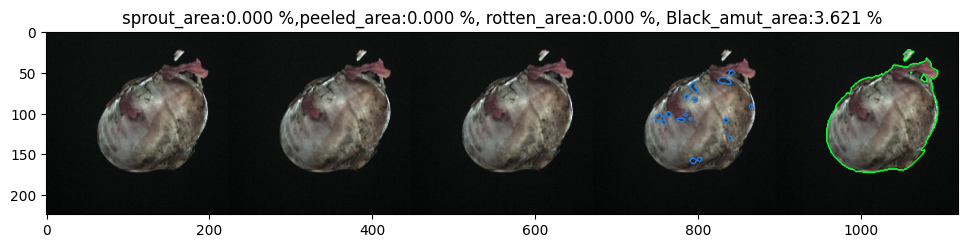

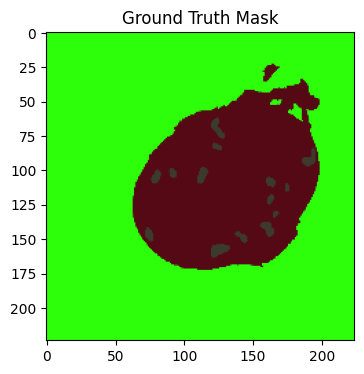

name of the image 793_.jpg
Inference time: 0.07 sec
Time taken for pred is :  0.07117509841918945 sec


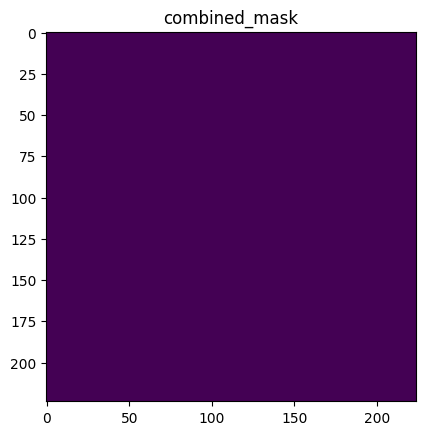

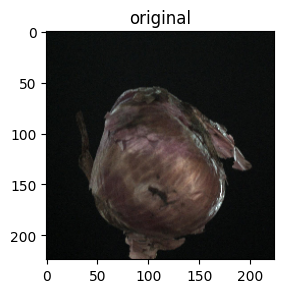

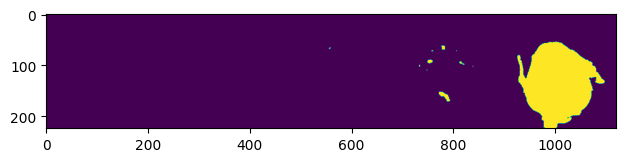

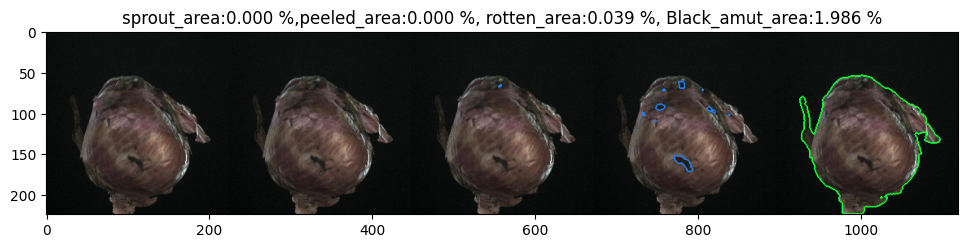

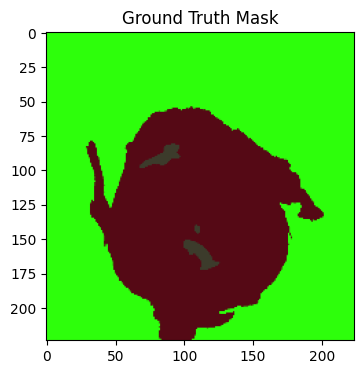

name of the image 738_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05520749092102051 sec


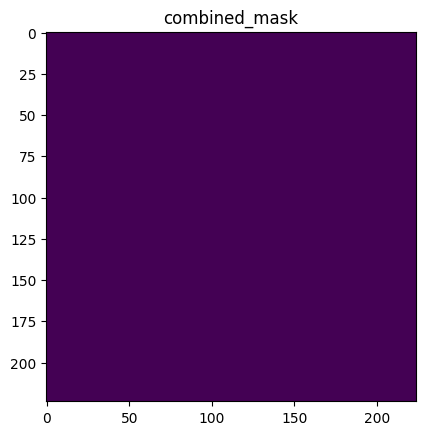

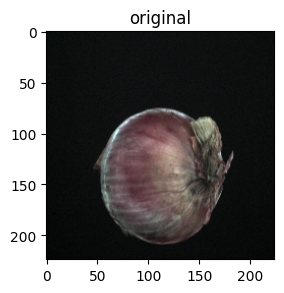

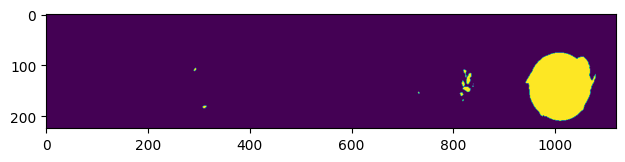

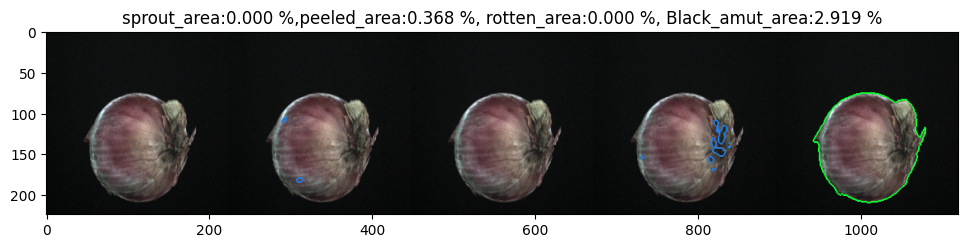

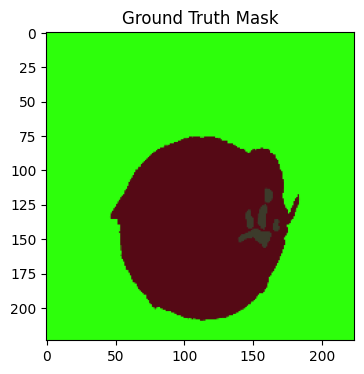

name of the image 881_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.0537104606628418 sec


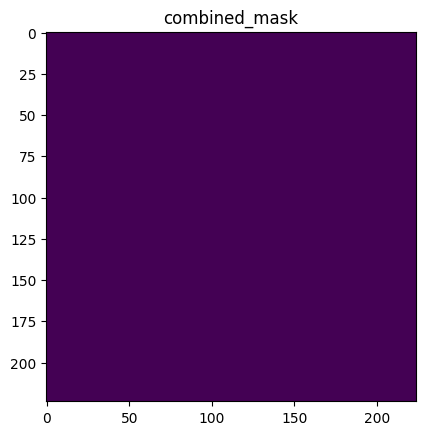

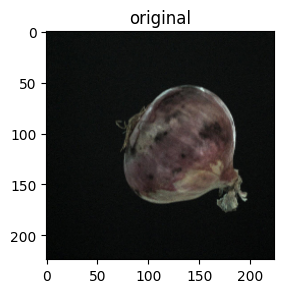

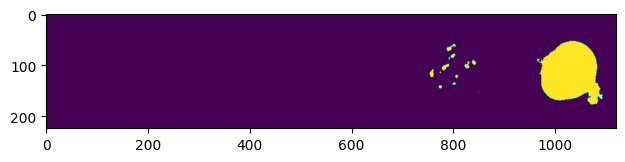

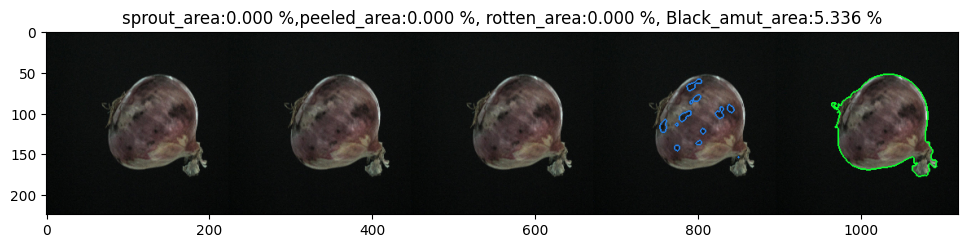

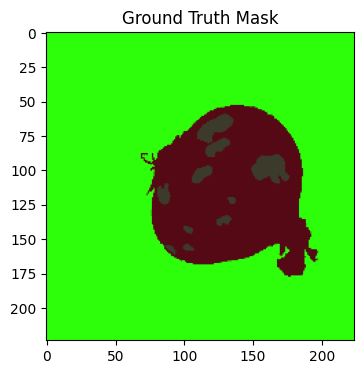

name of the image 845_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05120682716369629 sec


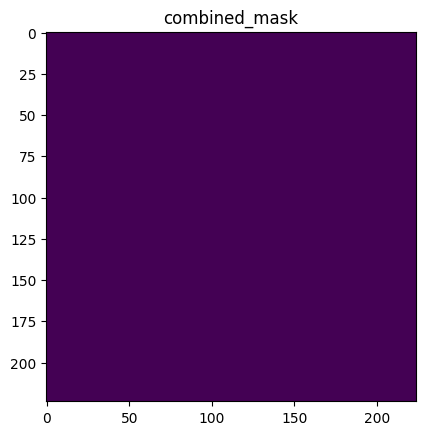

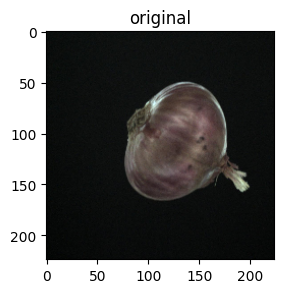

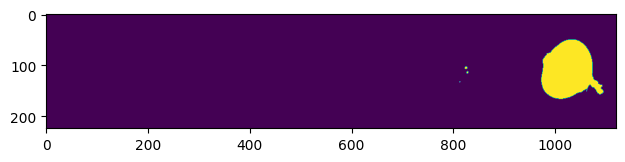

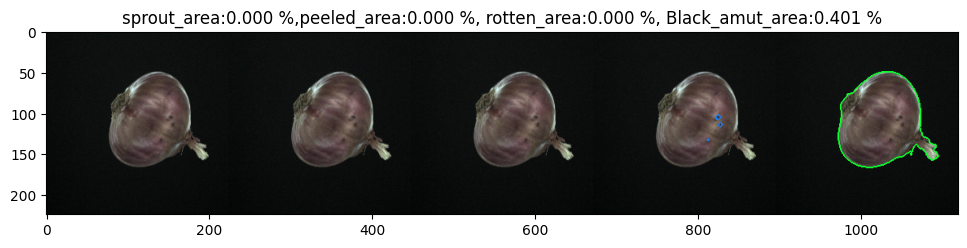

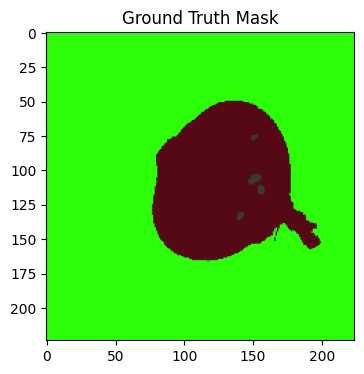

name of the image 924_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05448150634765625 sec


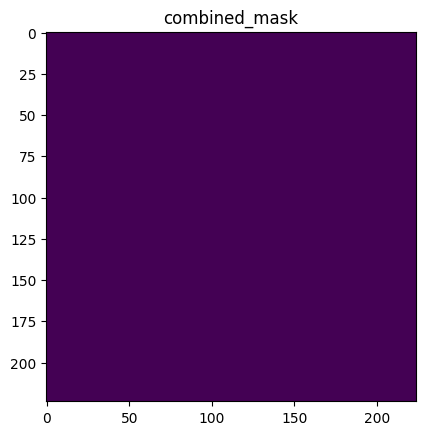

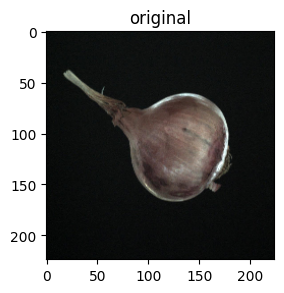

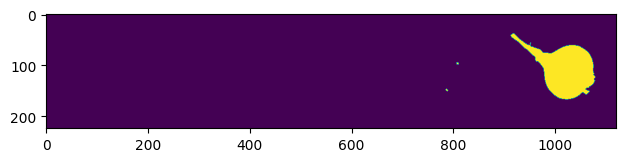

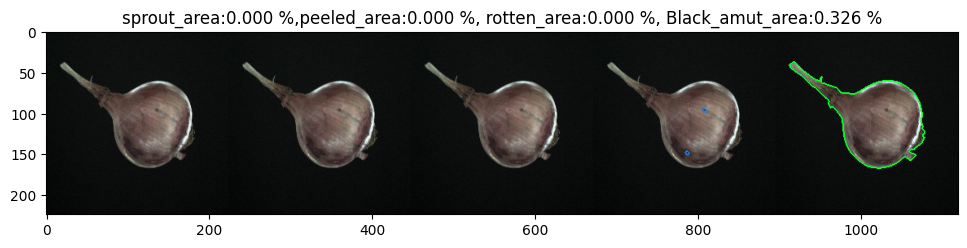

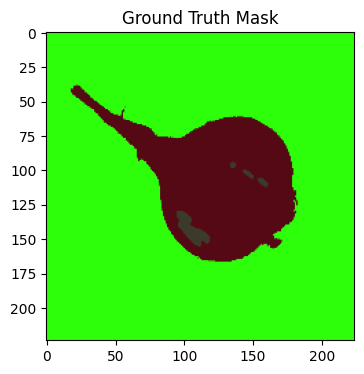

name of the image 870_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06301474571228027 sec


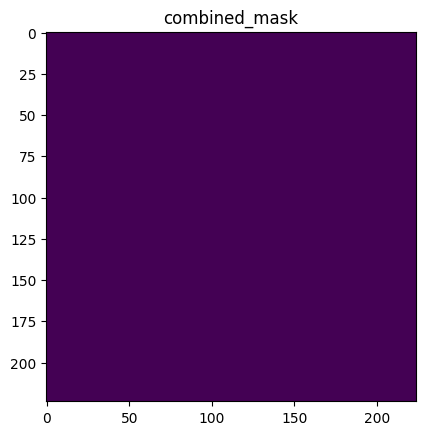

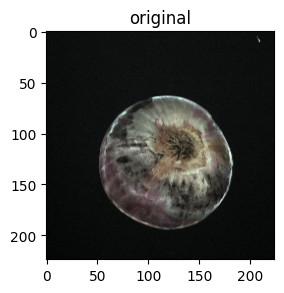

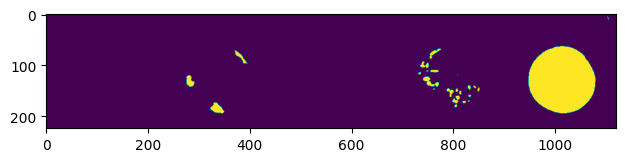

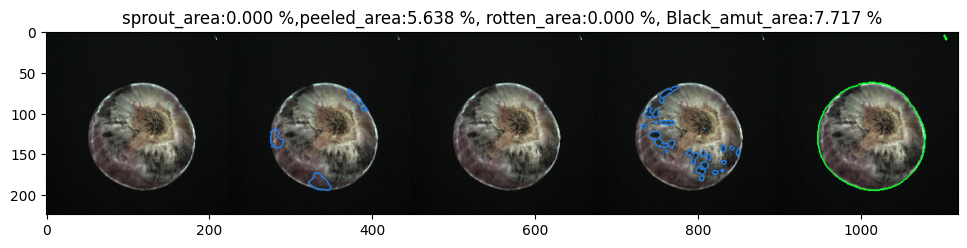

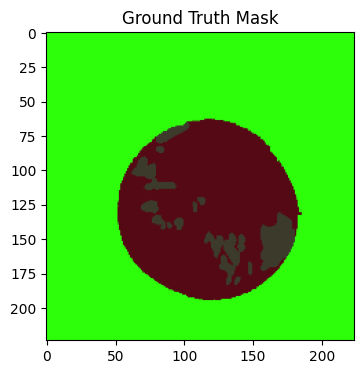

name of the image 943_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05234718322753906 sec


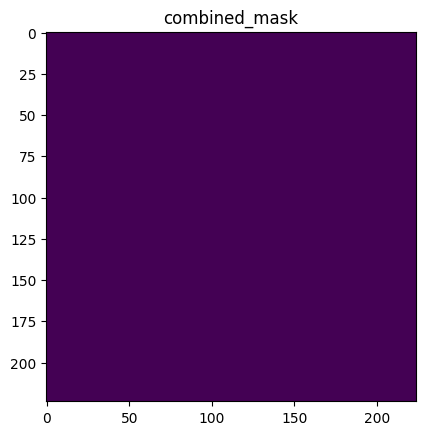

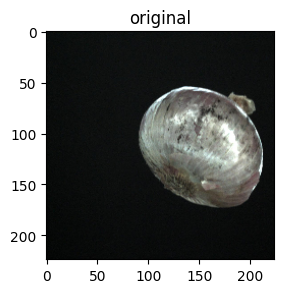

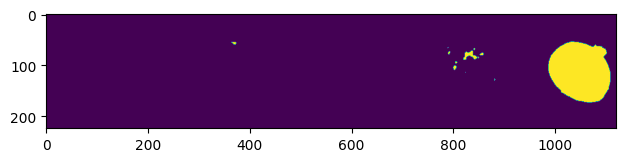

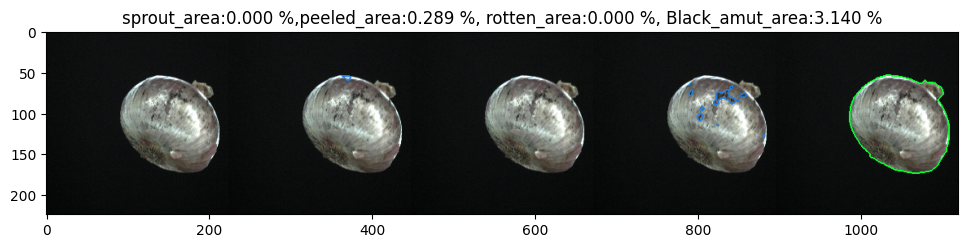

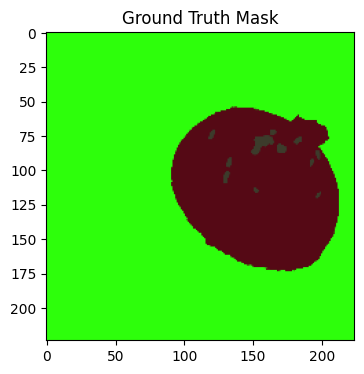

name of the image 897_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05351519584655762 sec


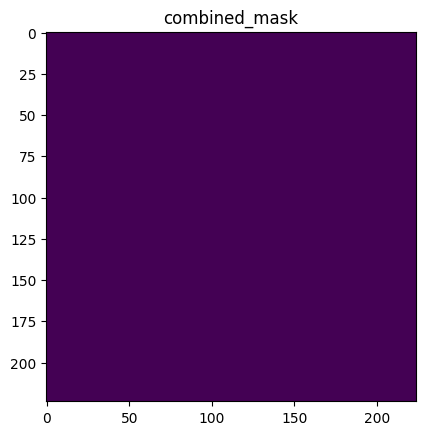

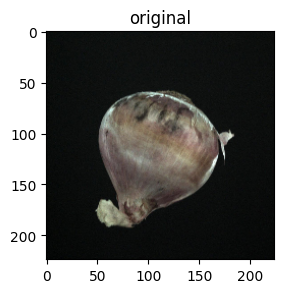

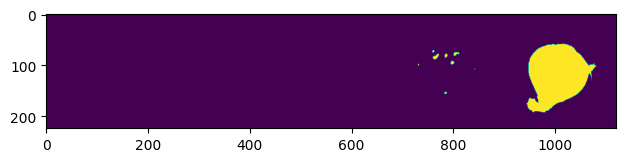

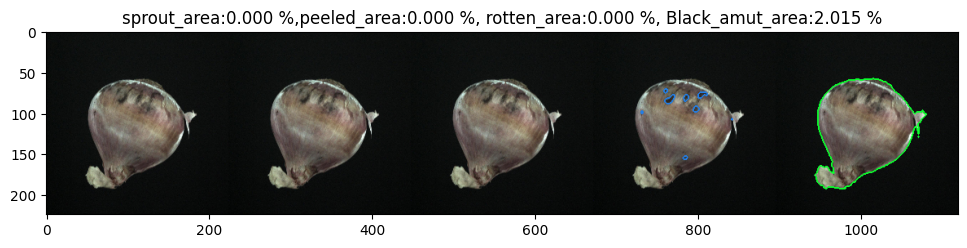

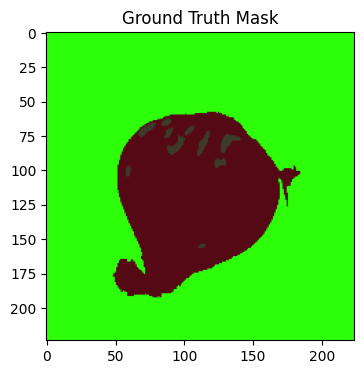

name of the image 762_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.0582127571105957 sec


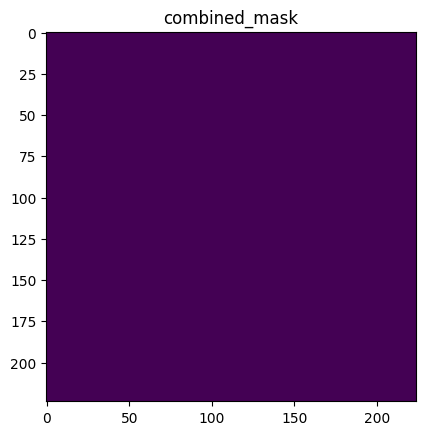

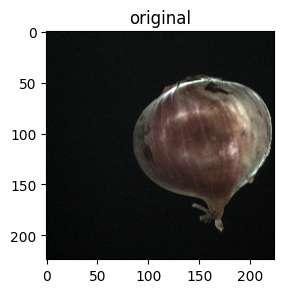

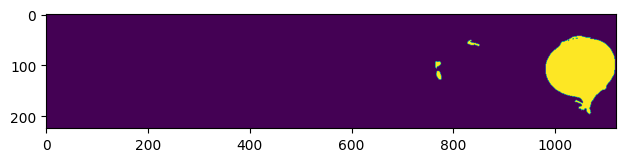

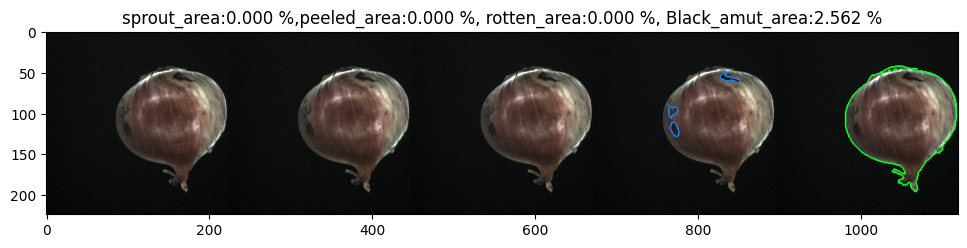

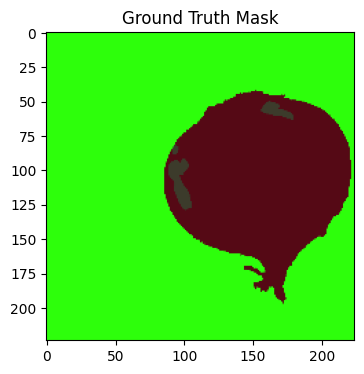

name of the image 869_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05275607109069824 sec


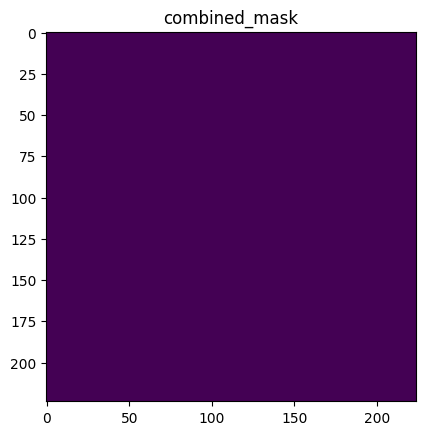

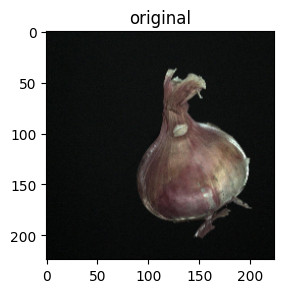

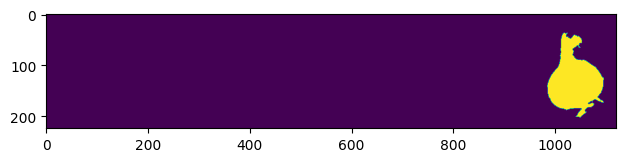

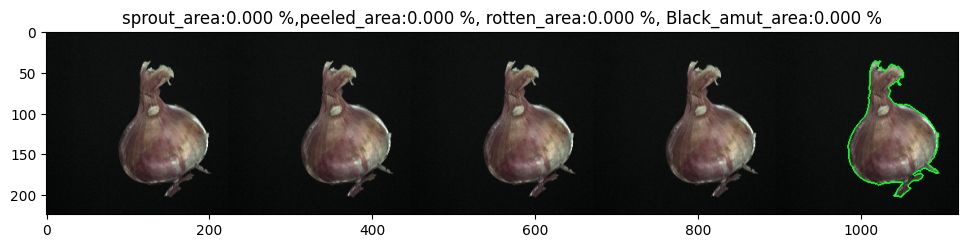

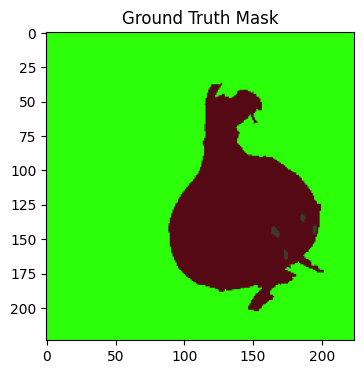

name of the image 807_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.0547335147857666 sec


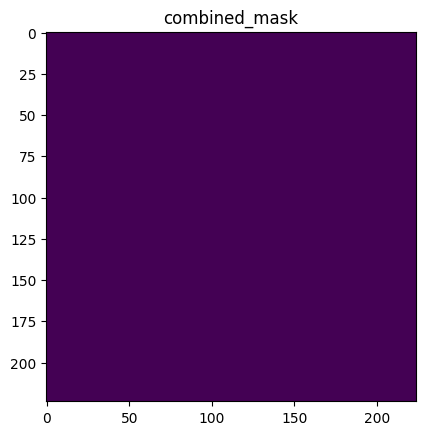

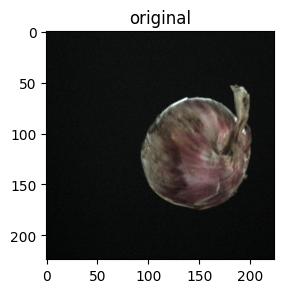

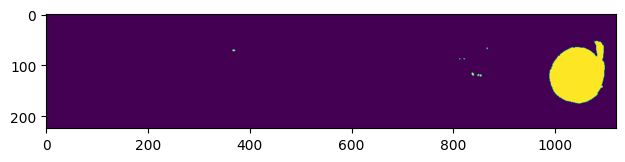

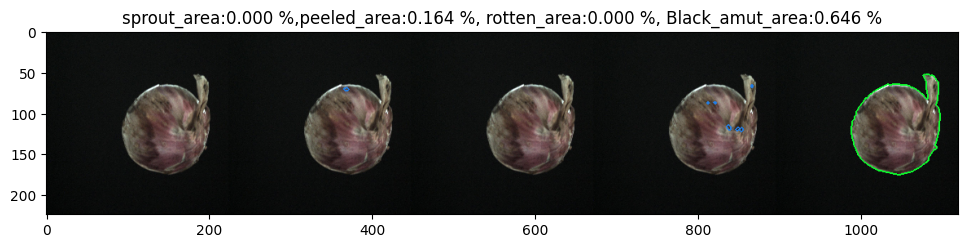

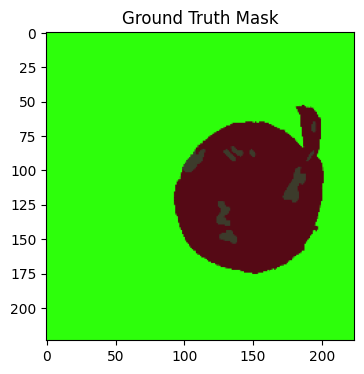

name of the image 736_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.05576515197753906 sec


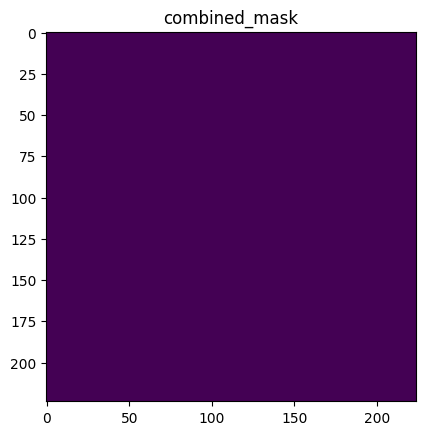

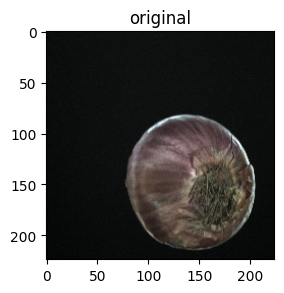

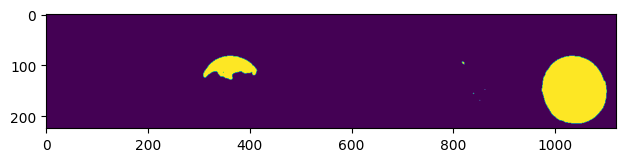

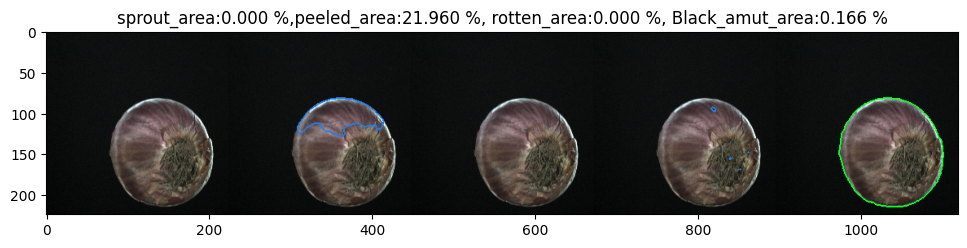

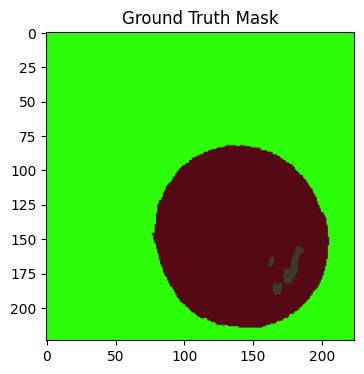

name of the image 873_.jpg
Inference time: 0.05 sec
Time taken for pred is :  0.048966407775878906 sec


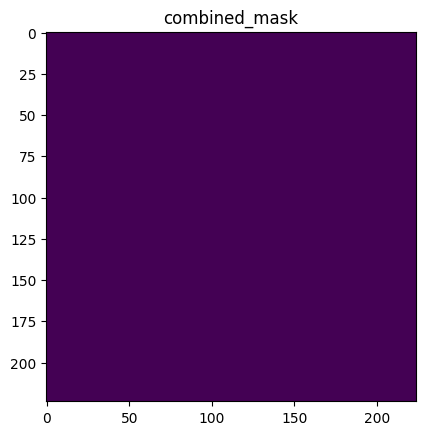

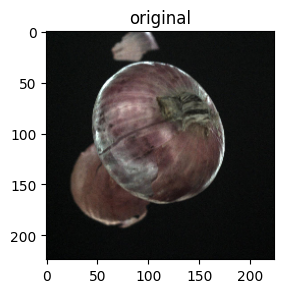

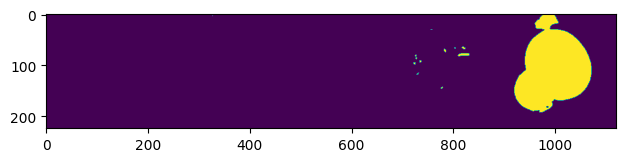

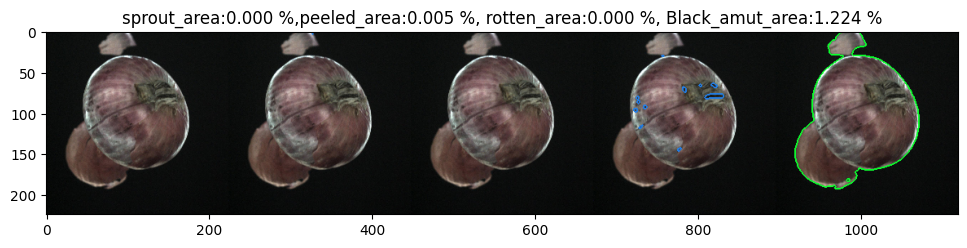

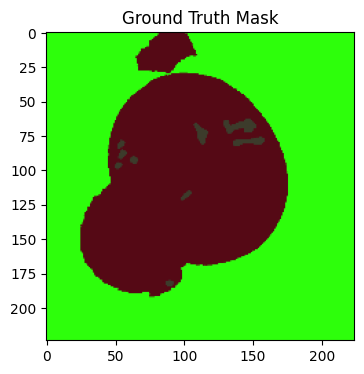

name of the image 914_.jpg
Inference time: 0.06 sec
Time taken for pred is :  0.06325221061706543 sec


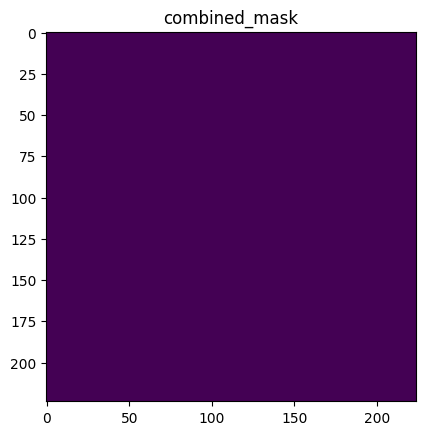

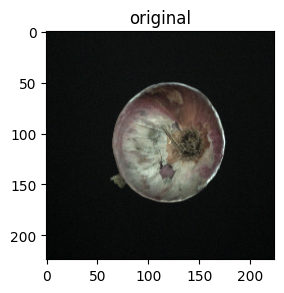

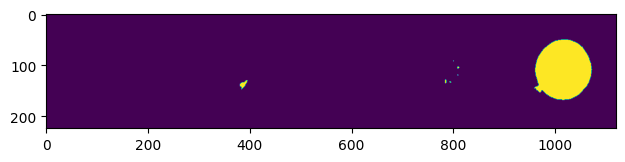

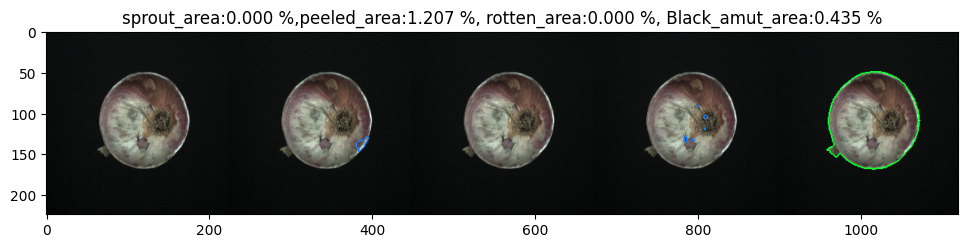

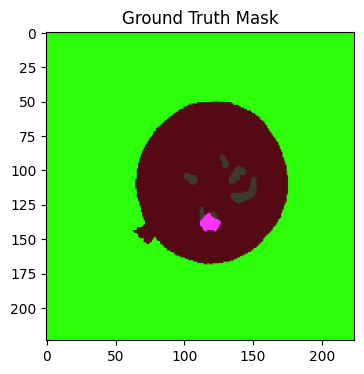

TypeError: getPrediction() missing 1 required positional argument: 'mask_path'

In [12]:
img_path=r'/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Blacksmut_17_07/images'
mask_path = r"/home/agrograde/Desktop/15th_july_2004/test/images/diff_intensity/Blacksmut_17_07/masks"
getPrediction(img_path,mask_path)
getPrediction(img_path)